In [1]:
import os
import h5py
import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from torchvision.transforms import functional as F

In [2]:
def show_image(image, ind, epoch):
    image = image.permute(1, 2, 0)
    fig, axes = plt.subplots(1, 4, figsize=(16, 4))
    titles = ["Tracks", "ECAL", "HCAL"]

    for i in range(3):
        axes[i].imshow(image[:, :, i], cmap="viridis")
        axes[i].set_title(titles[i])
        axes[i].axis("off")

    axes[3].imshow(image * 255)
    axes[3].set_title("Combined")
    axes[3].axis("off")

    plt.tight_layout(pad=2.0)

    plt.show()
    plt.close(fig)

In [3]:
class CustomDataset(Dataset):
    def __init__(self, X, y):
        self.X = X
        self.y = y

        # Normalize each image so that the sum of pixel intensities is 1
        self.transform = transforms.Compose(
            [transforms.Lambda(lambda x: x / torch.sum(x, dim=(0, 1, 2)))]
        )

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        image = self.X[idx]
        padded_image = np.zeros((128, 128, 3), dtype=np.float32)
        padded_image[: image.shape[0], : image.shape[1], :] = image

        return self.transform(
            torch.tensor(padded_image).permute(2, 0, 1)
        ), torch.tensor(self.y[idx])


class Autoencoder(nn.Module):
    def __init__(self):
        super(Autoencoder, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 16, 3, stride=2, padding=1),
            nn.ReLU(),
            nn.Conv2d(16, 32, 3, stride=2, padding=1),
            nn.ReLU(),
            nn.Conv2d(32, 64, 7),
        )
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(64, 32, 7),
            nn.ReLU(),
            nn.ConvTranspose2d(32, 16, 3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(16, 3, 3, stride=2, padding=1, output_padding=1),
            nn.Sigmoid(),
        )

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x

epoch: 1


100%|█████████████████████████████████████████| 625/625 [28:39<00:00,  2.75s/it]


train_loss: 0.03246450614165515
epoch: 2


100%|█████████████████████████████████████████| 625/625 [40:52<00:00,  3.92s/it]


train_loss: 0.0019507485050708055
epoch: 3


100%|█████████████████████████████████████████| 625/625 [42:18<00:00,  4.06s/it]


train_loss: 0.0019496464380994438
epoch: 4


100%|█████████████████████████████████████████| 625/625 [38:43<00:00,  3.72s/it]


train_loss: 0.0019154714060947299
epoch: 5


100%|█████████████████████████████████████████| 625/625 [19:47<00:00,  1.90s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.0018382432445883752
Sample #0


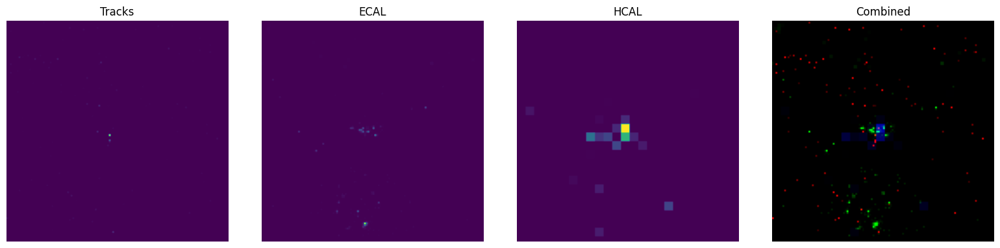

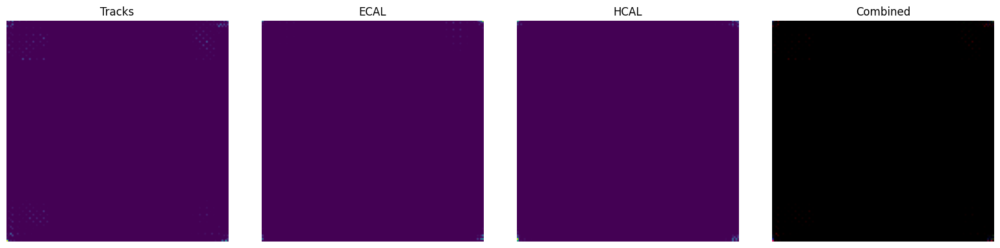

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


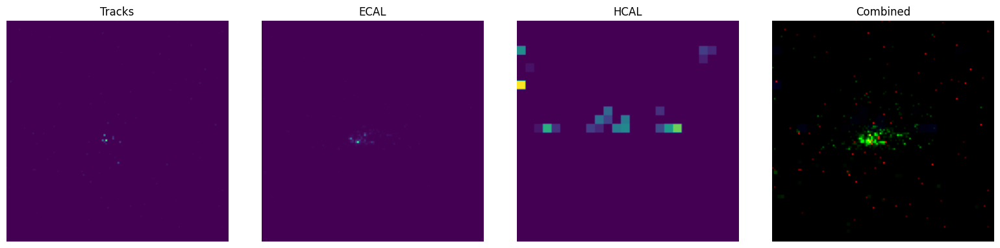

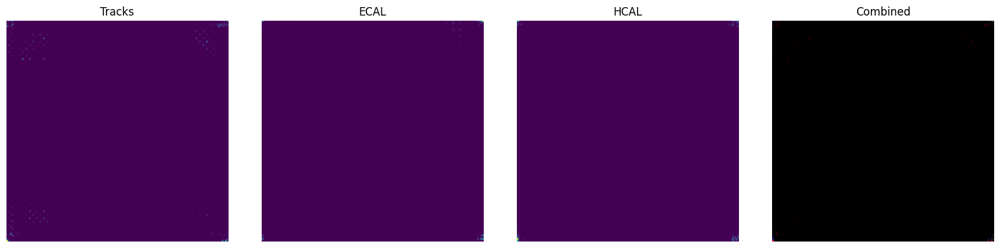

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


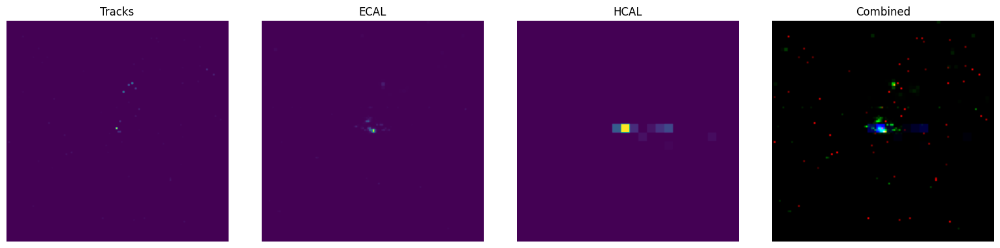

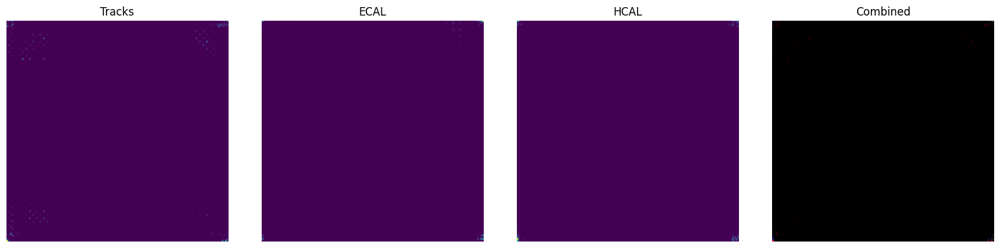

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


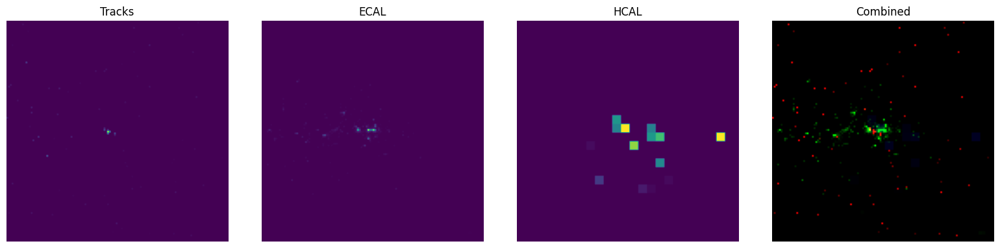

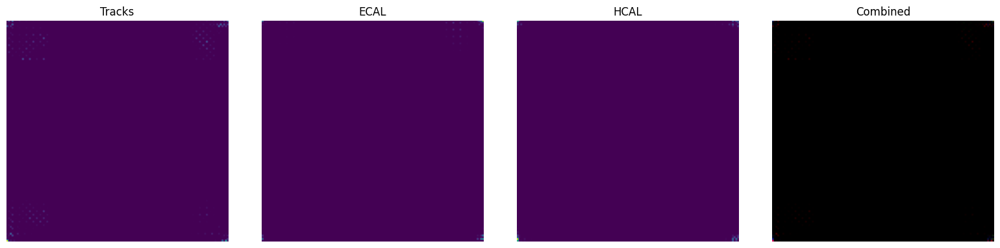

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


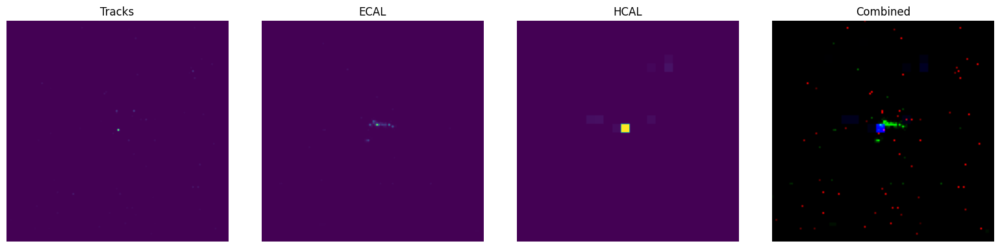

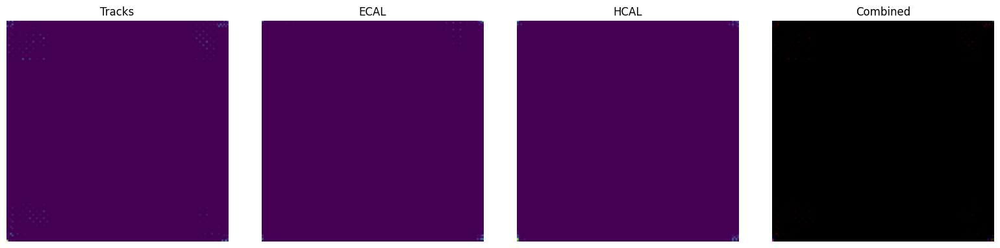

epoch: 6


100%|█████████████████████████████████████████| 625/625 [06:41<00:00,  1.56it/s]


train_loss: 0.0016189443586394191
epoch: 7


100%|█████████████████████████████████████████| 625/625 [06:40<00:00,  1.56it/s]


train_loss: 0.0014445078138262033
epoch: 8


100%|█████████████████████████████████████████| 625/625 [06:40<00:00,  1.56it/s]


train_loss: 0.001375364099815488
epoch: 9


100%|█████████████████████████████████████████| 625/625 [06:34<00:00,  1.58it/s]


train_loss: 0.0013285582289099694
epoch: 10


100%|█████████████████████████████████████████| 625/625 [06:36<00:00,  1.58it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.001255469561740756
Sample #0


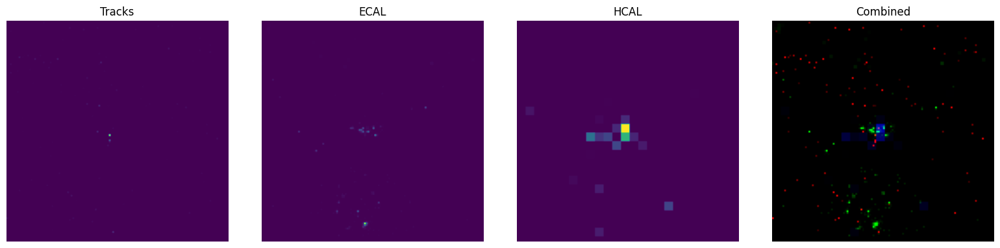

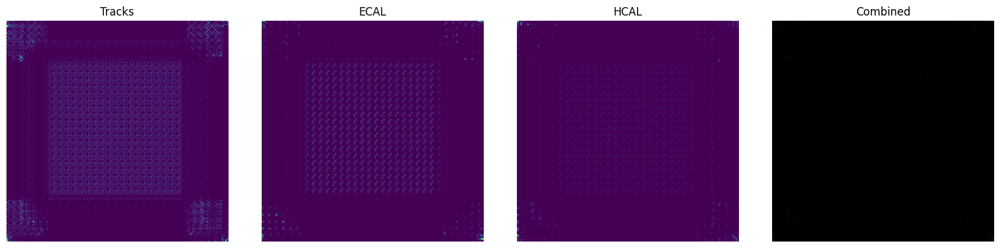

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


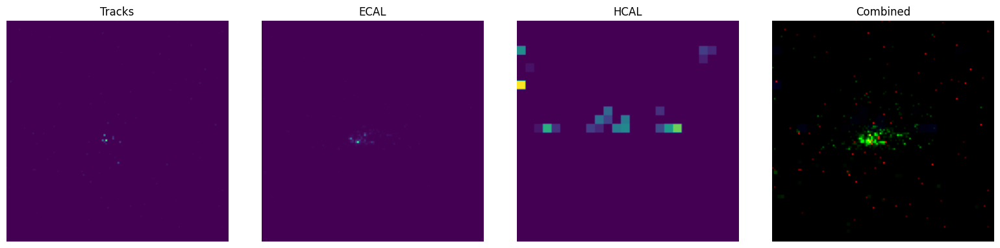

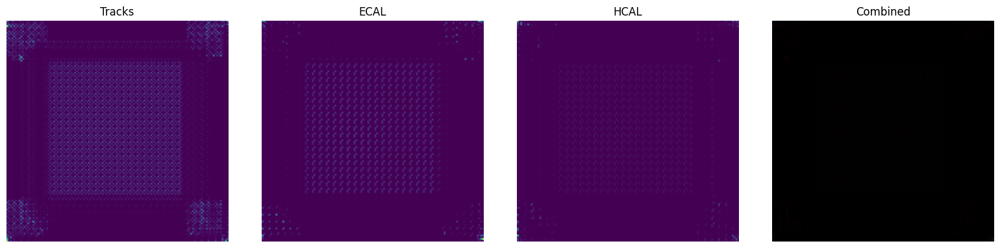

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


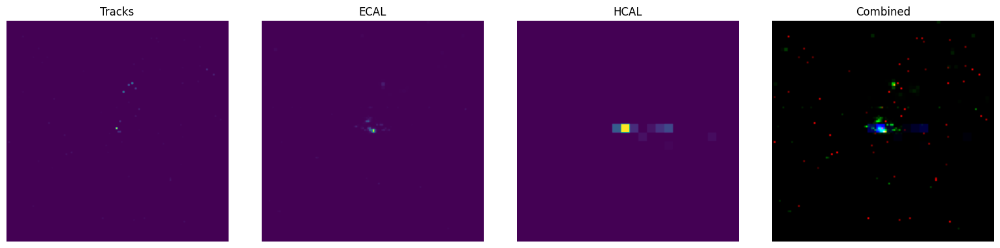

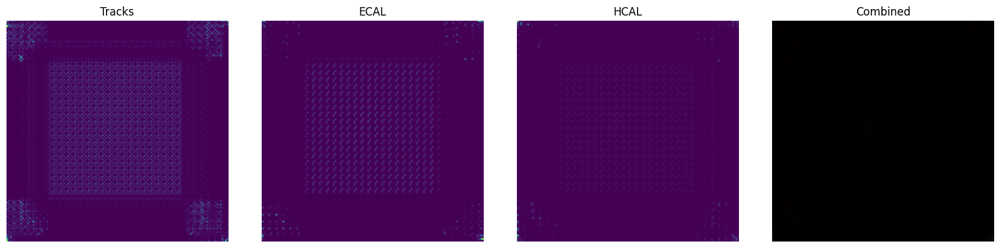

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


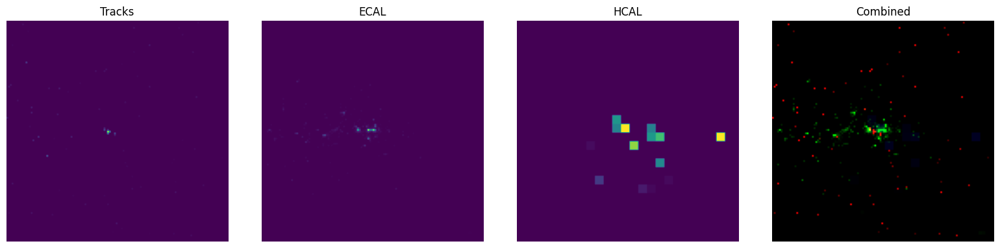

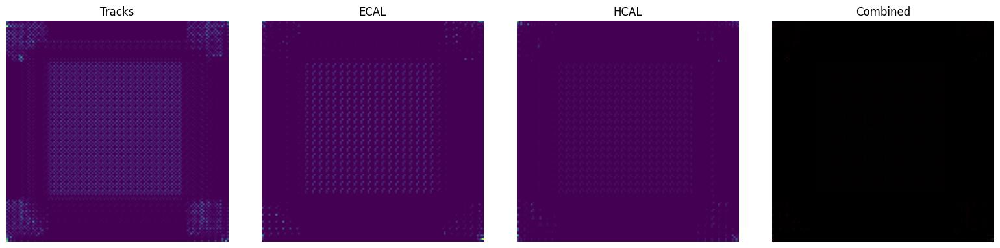

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


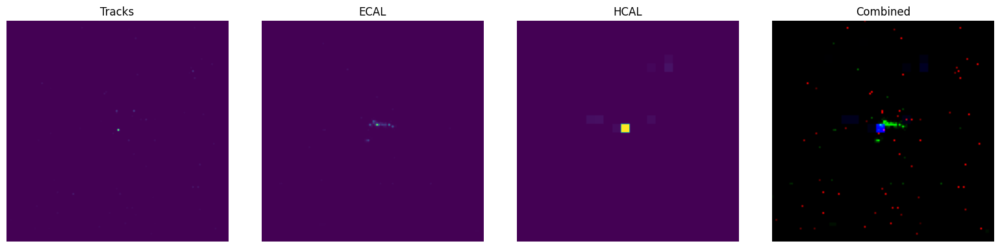

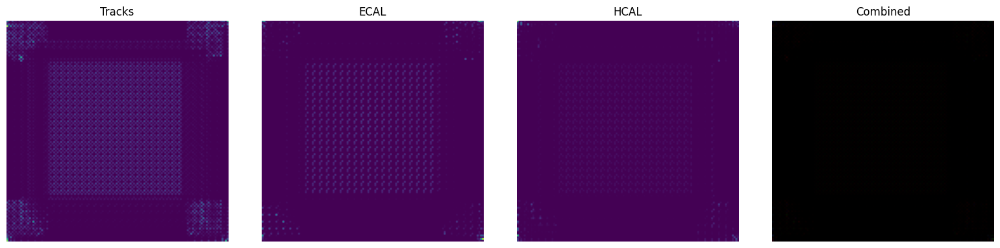

epoch: 11


100%|█████████████████████████████████████████| 625/625 [06:37<00:00,  1.57it/s]


train_loss: 0.0011750369042158126
epoch: 12


100%|█████████████████████████████████████████| 625/625 [06:39<00:00,  1.57it/s]


train_loss: 0.0009723641709424555
epoch: 13


100%|█████████████████████████████████████████| 625/625 [06:25<00:00,  1.62it/s]


train_loss: 0.000502248629881069
epoch: 14


100%|█████████████████████████████████████████| 625/625 [06:13<00:00,  1.67it/s]


train_loss: 0.000212832837481983
epoch: 15


100%|█████████████████████████████████████████| 625/625 [06:12<00:00,  1.68it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.00019686177936382591
Sample #0


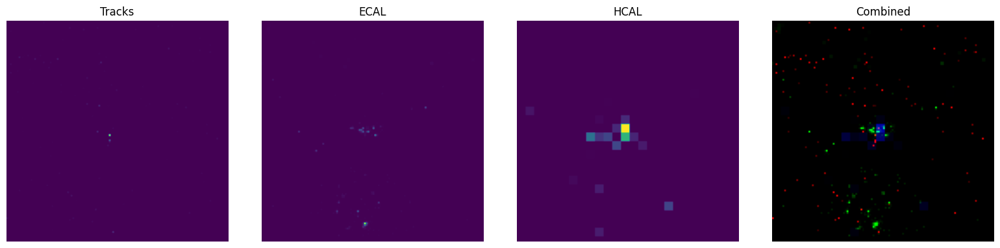

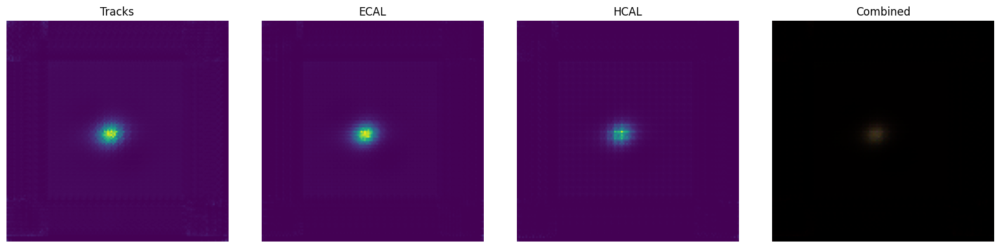

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


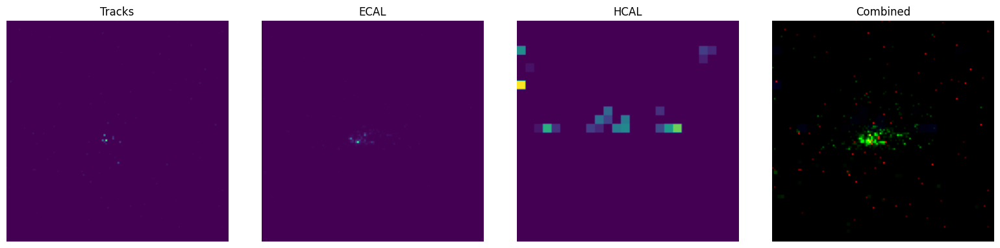

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


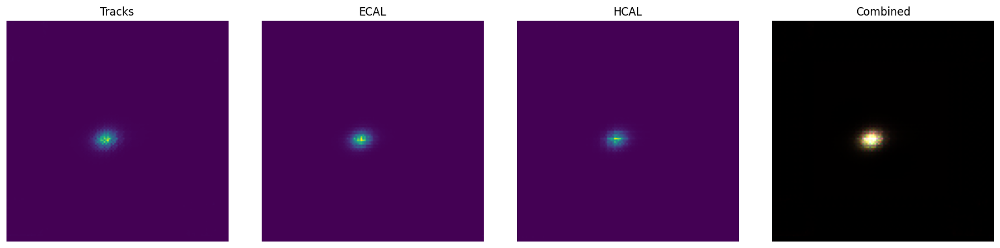

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


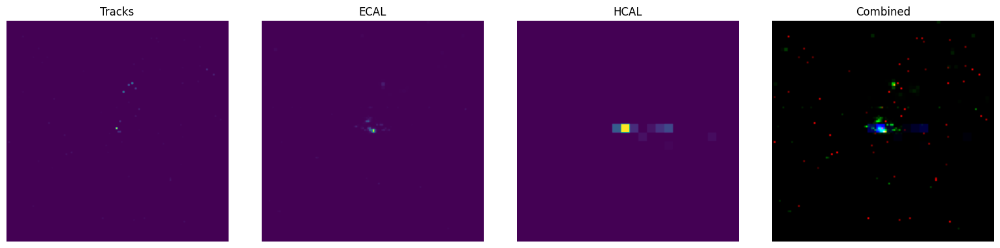

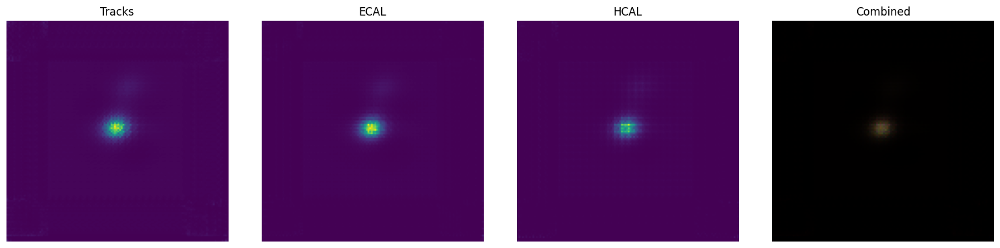

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


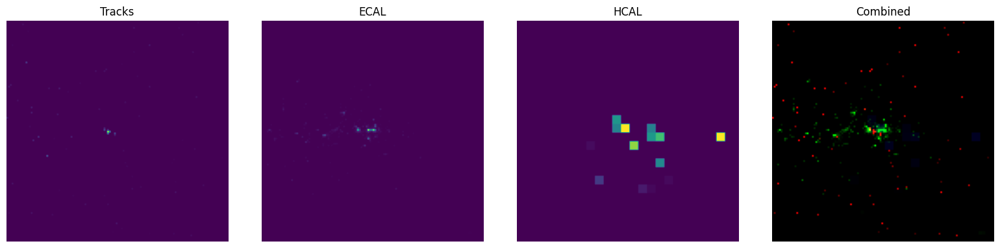

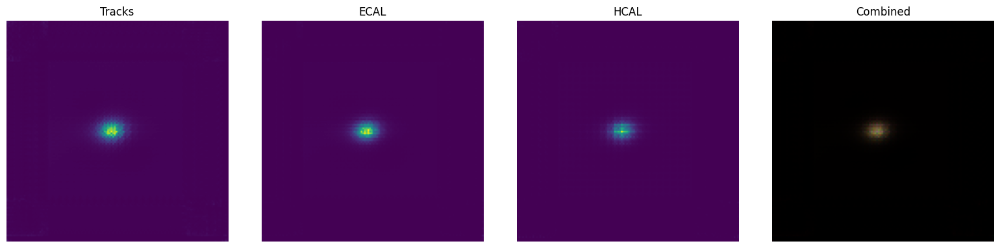

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


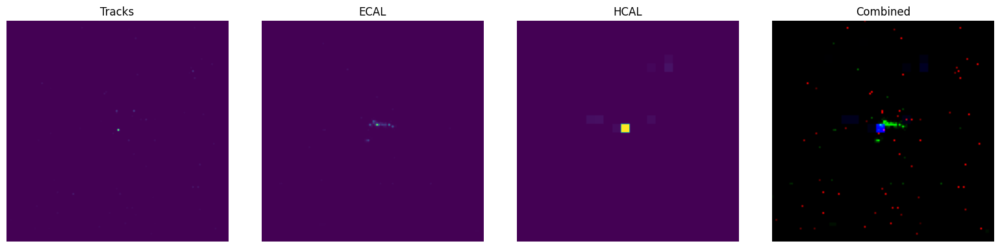

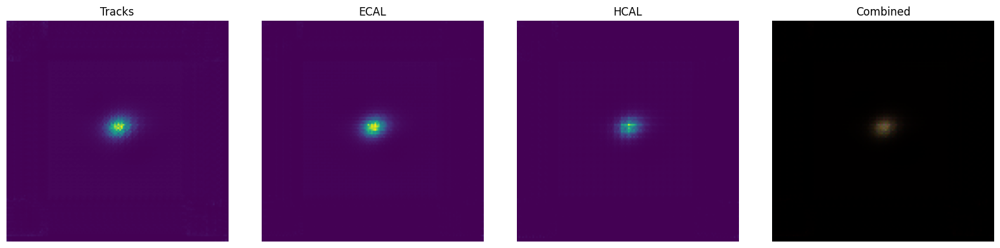

epoch: 16


100%|█████████████████████████████████████████| 625/625 [06:12<00:00,  1.68it/s]


train_loss: 0.0001954651876585558
epoch: 17


100%|█████████████████████████████████████████| 625/625 [06:13<00:00,  1.67it/s]


train_loss: 0.00019403602078091353
epoch: 18


100%|█████████████████████████████████████████| 625/625 [06:14<00:00,  1.67it/s]


train_loss: 0.00019272521131206304
epoch: 19


100%|█████████████████████████████████████████| 625/625 [06:15<00:00,  1.66it/s]


train_loss: 0.00019141527221072465
epoch: 20


100%|█████████████████████████████████████████| 625/625 [06:14<00:00,  1.67it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.00019004733965266495
Sample #0


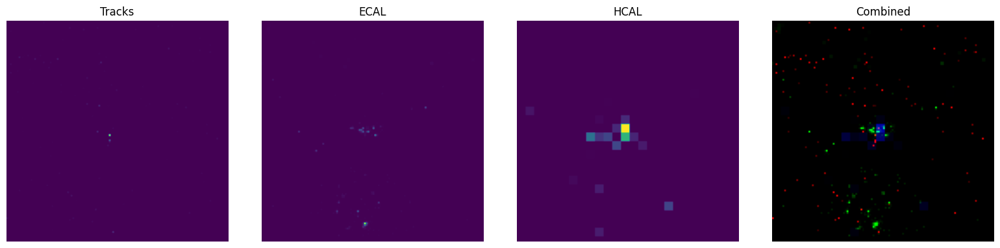

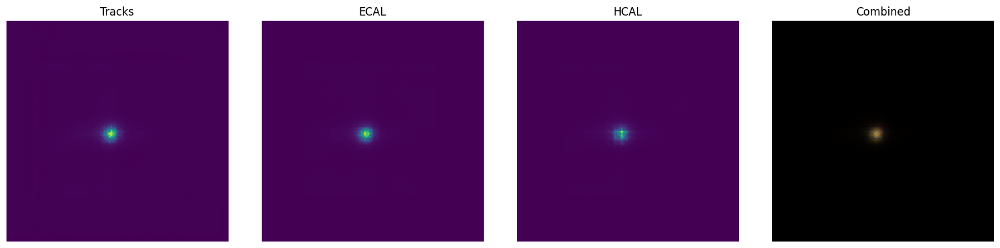

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


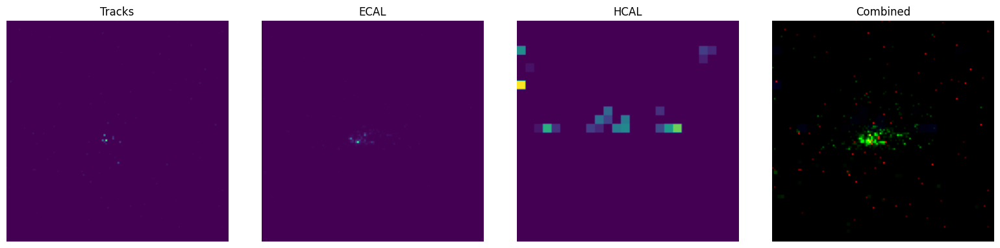

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


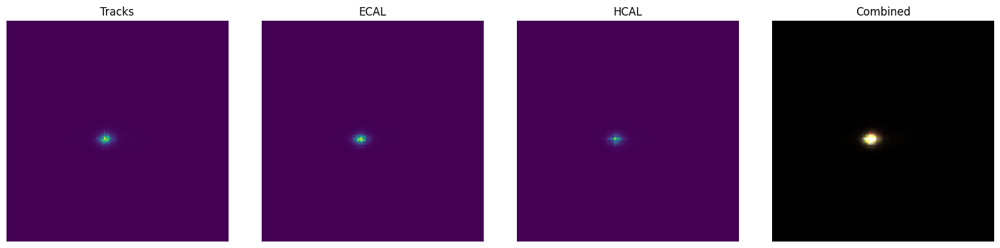

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


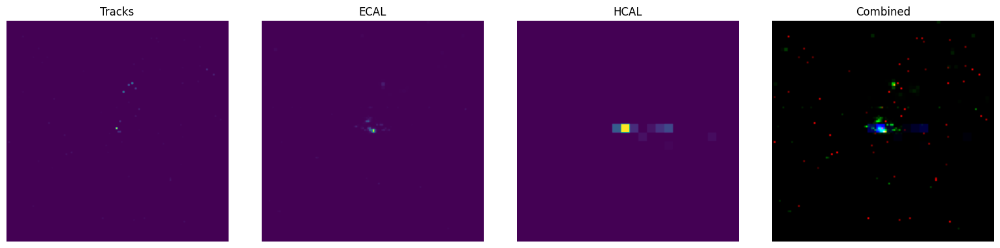

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


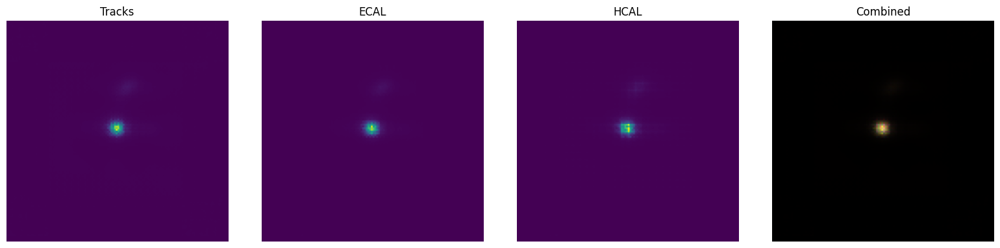

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


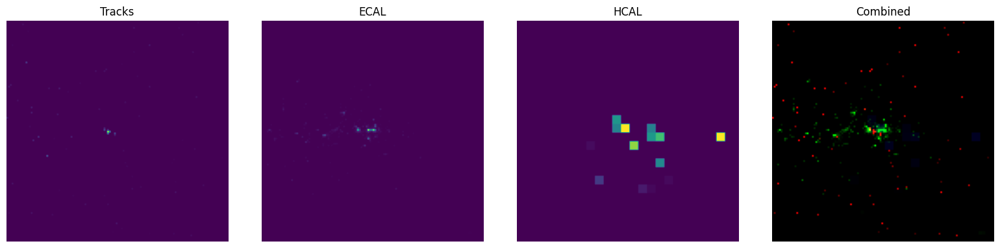

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


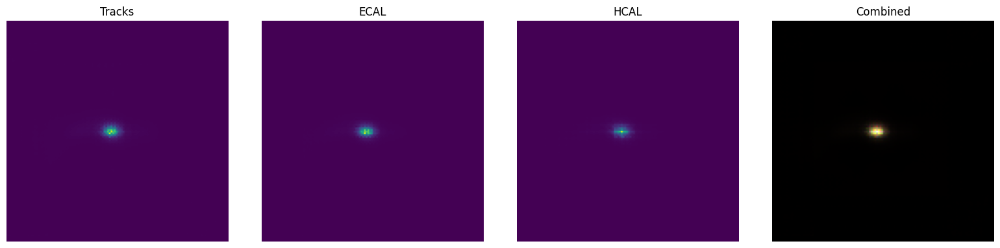

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


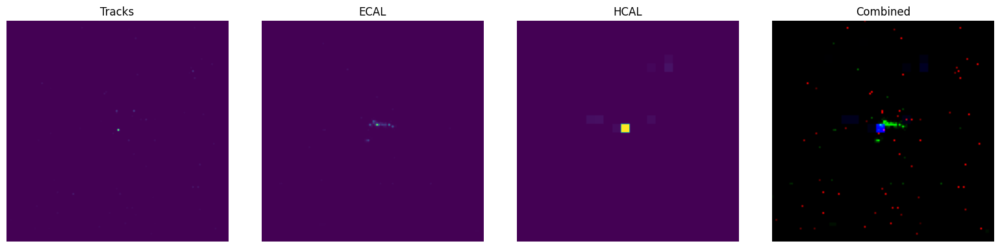

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


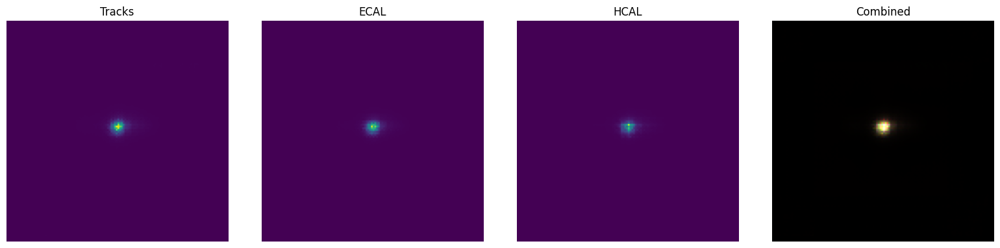

epoch: 21


100%|█████████████████████████████████████████| 625/625 [06:15<00:00,  1.66it/s]


train_loss: 0.00018834633152000607
epoch: 22


100%|█████████████████████████████████████████| 625/625 [06:15<00:00,  1.66it/s]


train_loss: 0.00018680050154216589
epoch: 23


100%|█████████████████████████████████████████| 625/625 [06:15<00:00,  1.66it/s]


train_loss: 0.00018549738030415028
epoch: 24


100%|█████████████████████████████████████████| 625/625 [06:15<00:00,  1.66it/s]


train_loss: 0.00019328533438965677
epoch: 25


100%|█████████████████████████████████████████| 625/625 [06:15<00:00,  1.67it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.000183843234856613
Sample #0


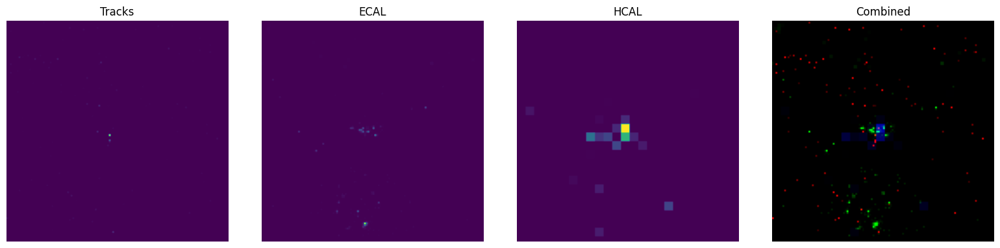

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


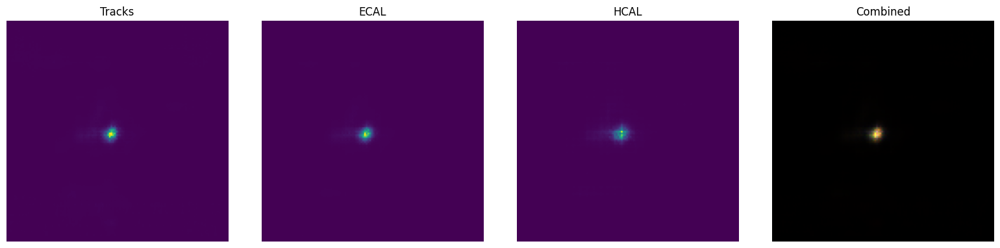

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


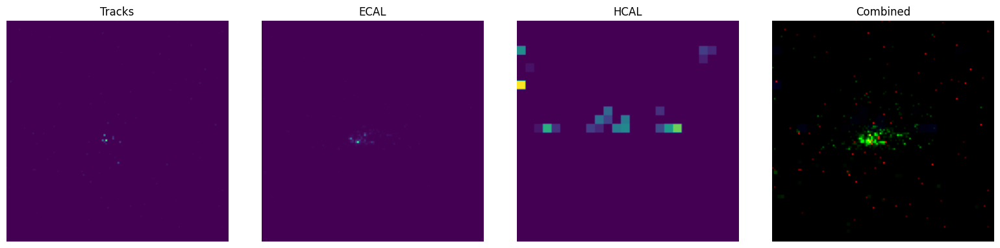

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


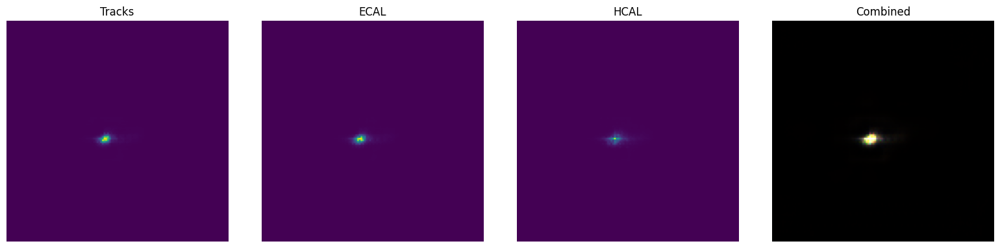

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


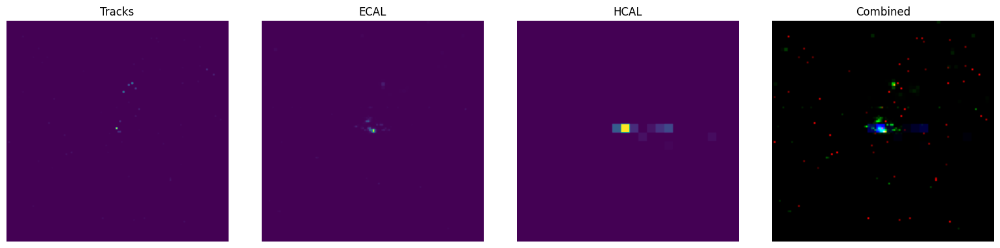

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


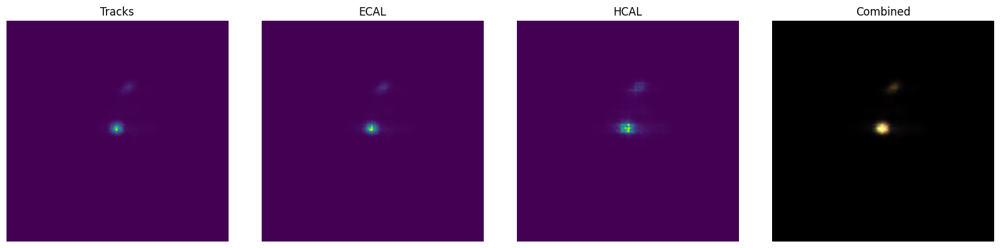

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


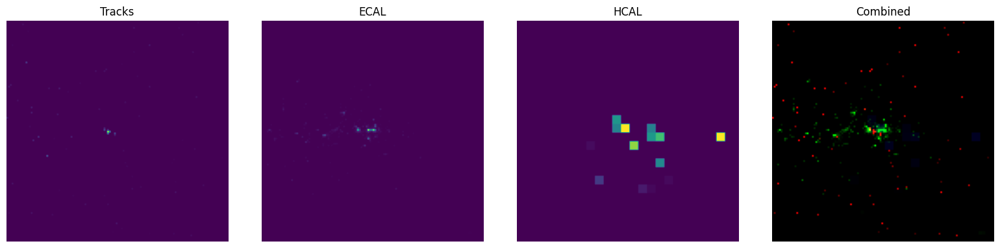

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


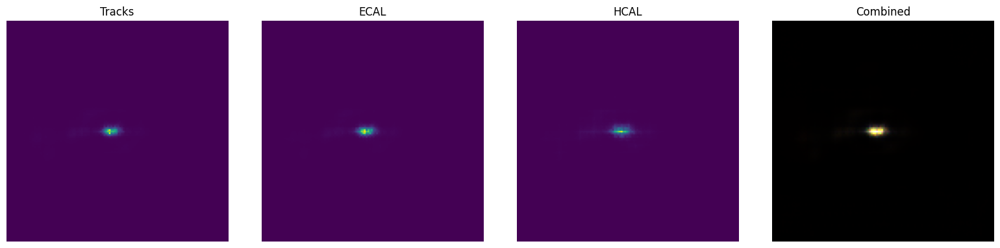

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


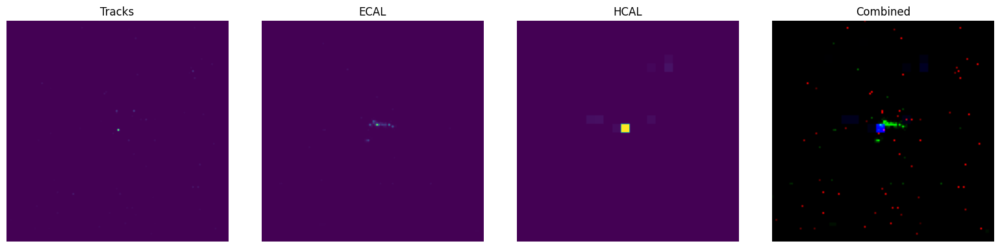

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


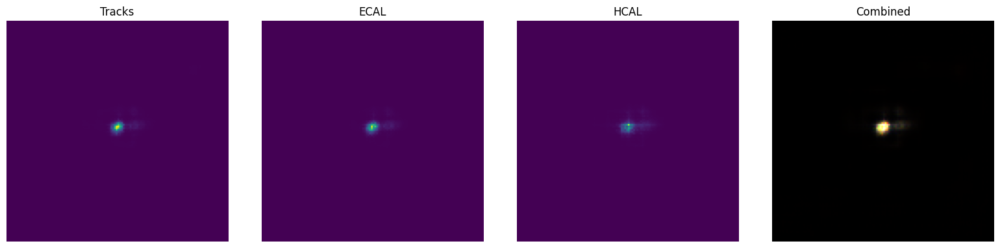

epoch: 26


100%|█████████████████████████████████████████| 625/625 [06:14<00:00,  1.67it/s]


train_loss: 0.0001823459102306515
epoch: 27


100%|█████████████████████████████████████████| 625/625 [06:14<00:00,  1.67it/s]


train_loss: 0.00018070806895848364
epoch: 28


100%|█████████████████████████████████████████| 625/625 [06:15<00:00,  1.66it/s]


train_loss: 0.00018167627723887563
epoch: 29


100%|█████████████████████████████████████████| 625/625 [06:15<00:00,  1.67it/s]


train_loss: 0.00017773188471328468
epoch: 30


100%|█████████████████████████████████████████| 625/625 [06:16<00:00,  1.66it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.00017519078669138254
Sample #0


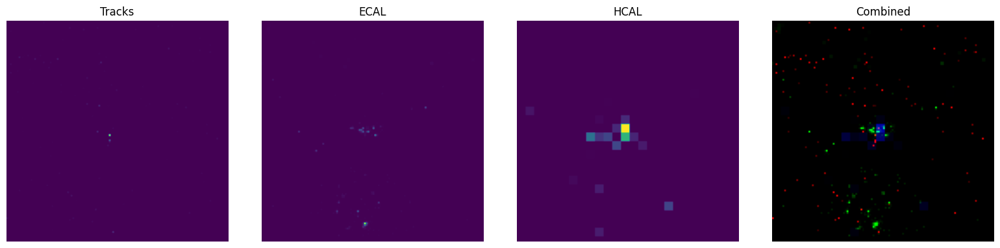

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


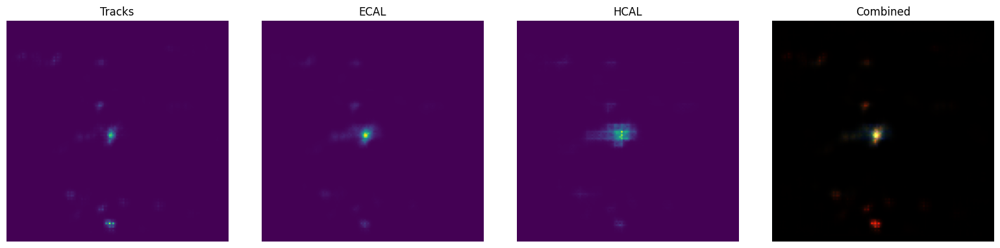

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


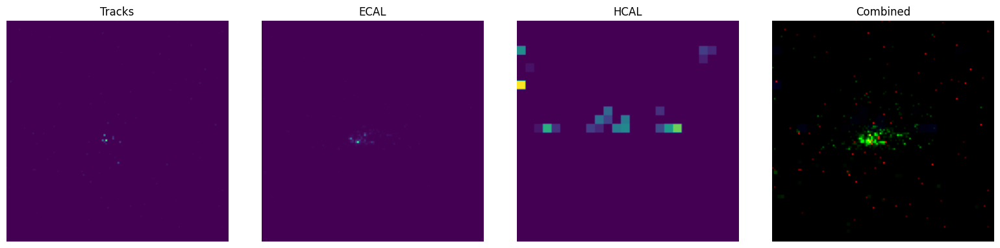

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


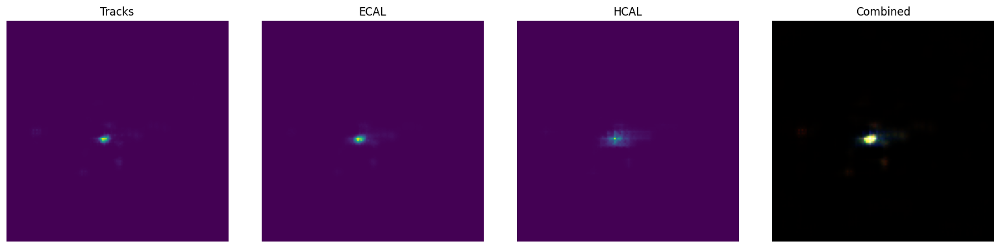

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


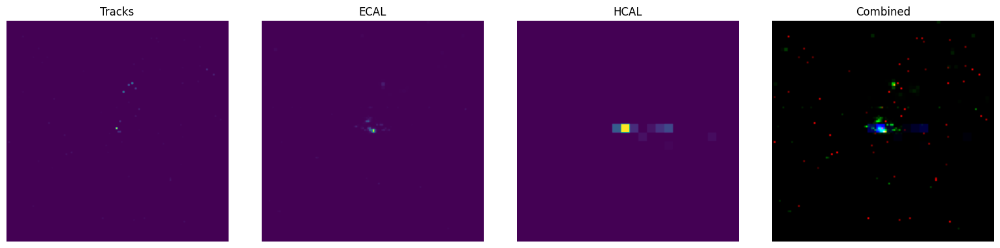

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


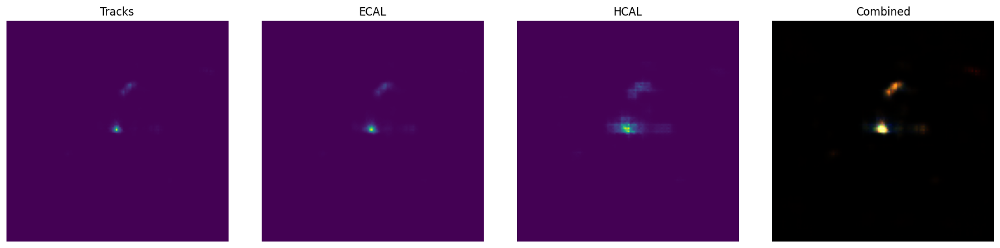

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


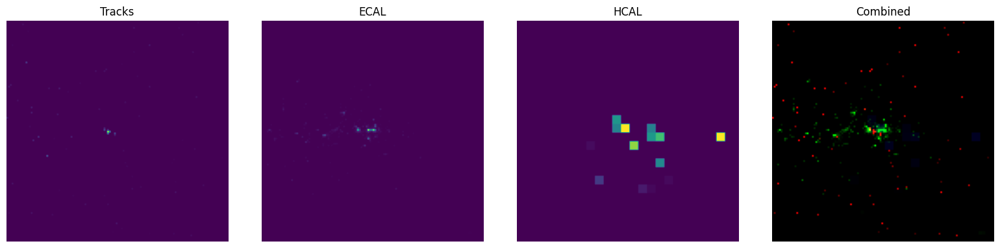

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


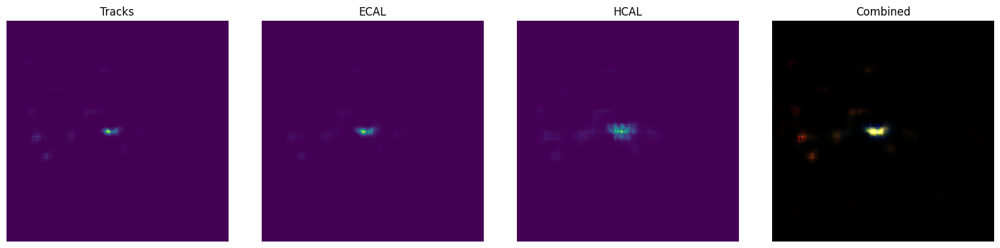

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


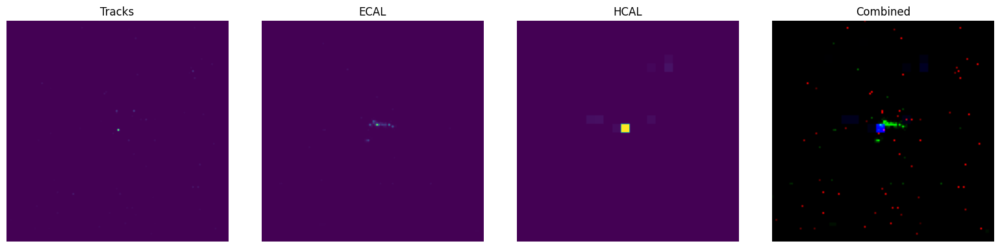

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


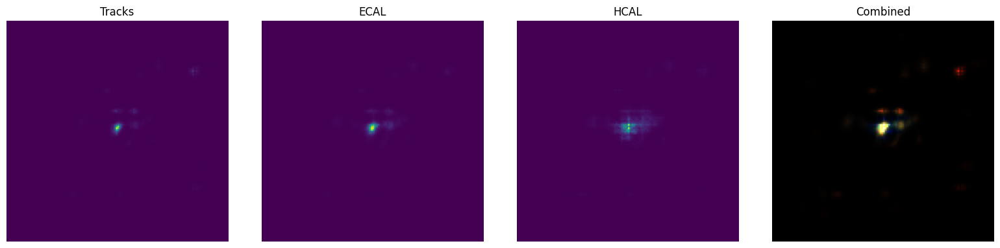

epoch: 31


100%|█████████████████████████████████████████| 625/625 [06:16<00:00,  1.66it/s]


train_loss: 0.00017265774249099195
epoch: 32


100%|█████████████████████████████████████████| 625/625 [06:16<00:00,  1.66it/s]


train_loss: 0.00017529354230500757
epoch: 33


100%|█████████████████████████████████████████| 625/625 [06:17<00:00,  1.66it/s]


train_loss: 0.0001681890787323937
epoch: 34


100%|█████████████████████████████████████████| 625/625 [06:15<00:00,  1.66it/s]


train_loss: 0.00016576751796528697
epoch: 35


100%|█████████████████████████████████████████| 625/625 [06:16<00:00,  1.66it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.0001642086087493226
Sample #0


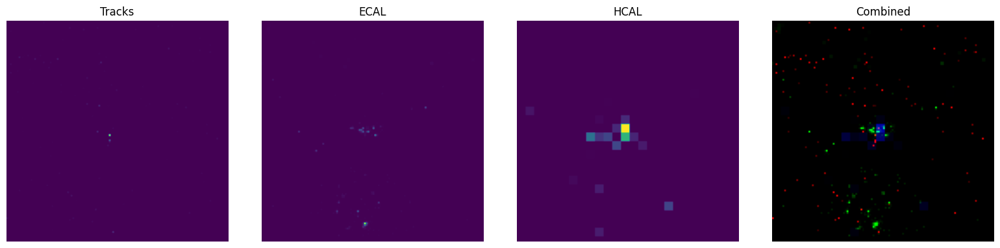

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


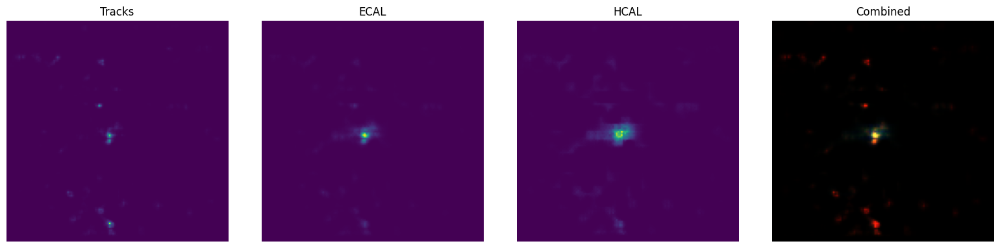

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


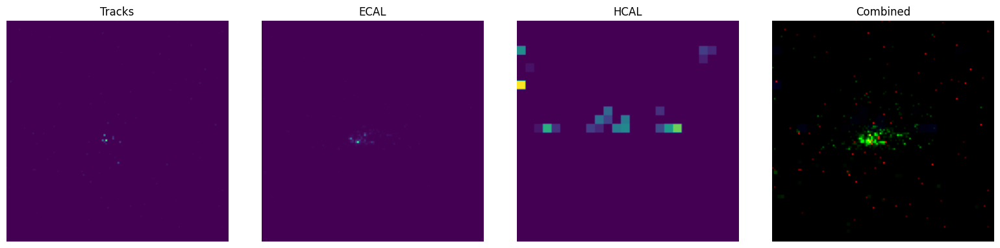

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


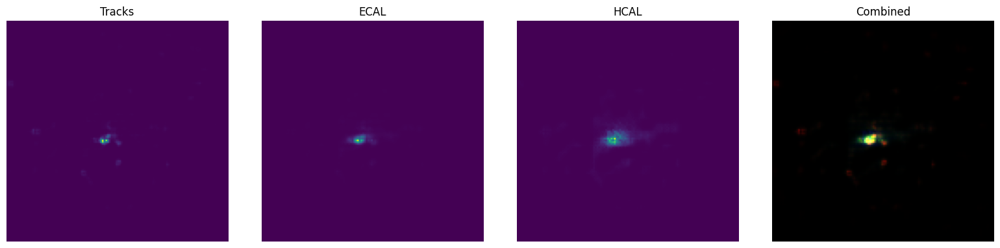

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


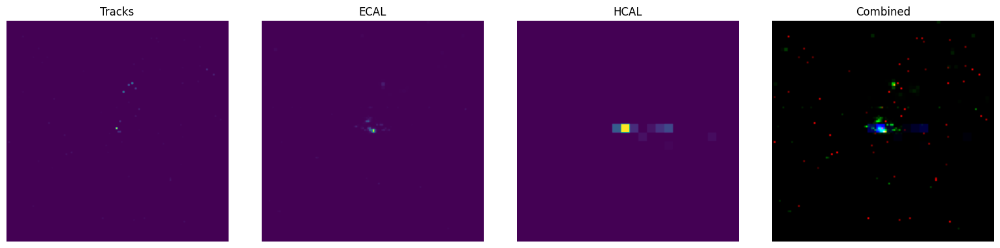

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


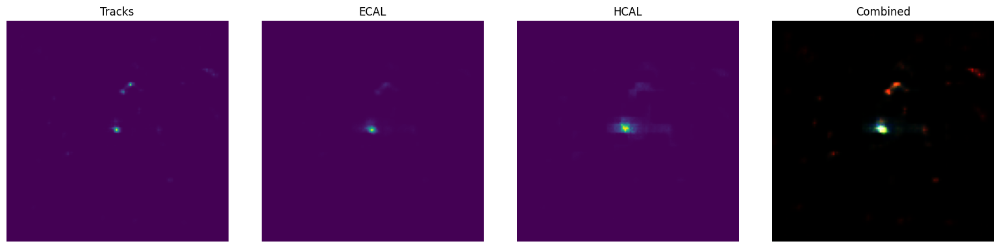

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


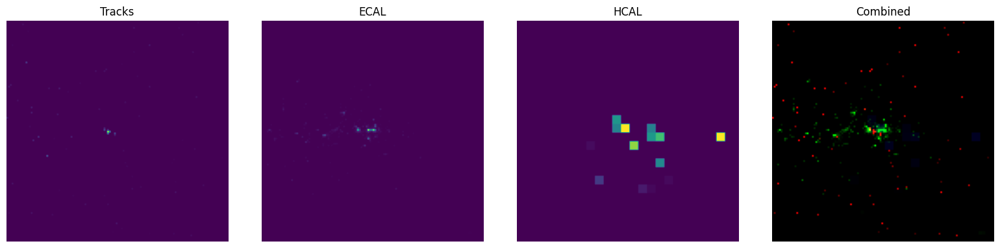

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


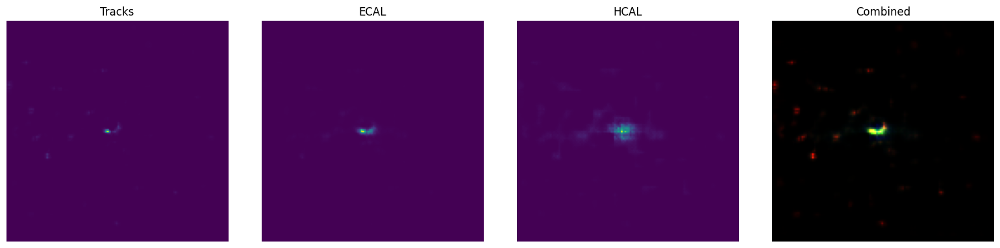

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


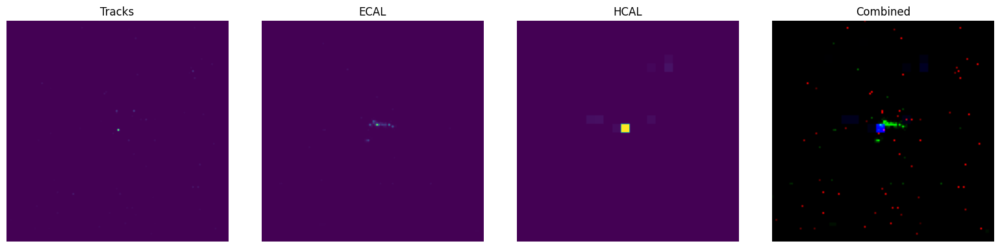

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


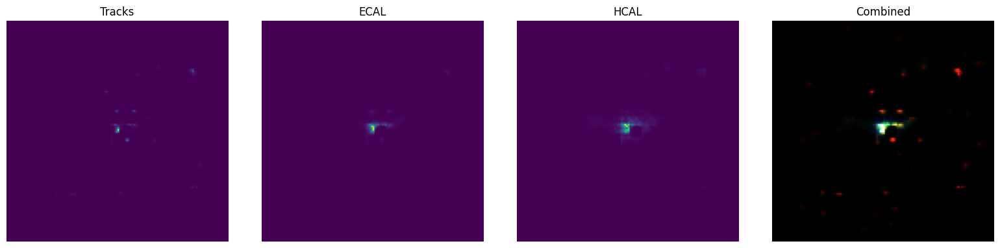

epoch: 36


100%|█████████████████████████████████████████| 625/625 [06:17<00:00,  1.65it/s]


train_loss: 0.0001616354453144595
epoch: 37


100%|█████████████████████████████████████████| 625/625 [06:19<00:00,  1.65it/s]


train_loss: 0.0001592027424601838
epoch: 38


100%|█████████████████████████████████████████| 625/625 [06:18<00:00,  1.65it/s]


train_loss: 0.0001575624957680702
epoch: 39


100%|█████████████████████████████████████████| 625/625 [06:17<00:00,  1.65it/s]


train_loss: 0.00015541281334590168
epoch: 40


100%|█████████████████████████████████████████| 625/625 [06:38<00:00,  1.57it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.00015319902489427476
Sample #0


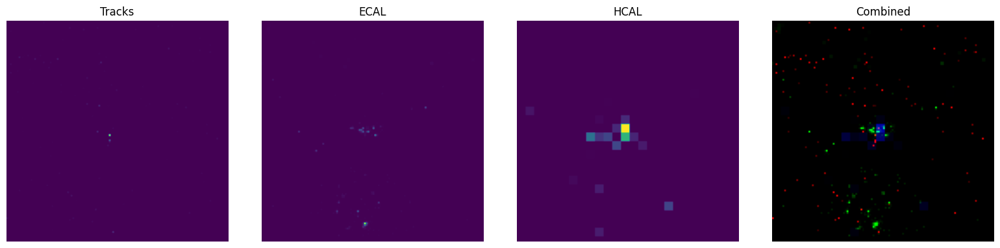

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


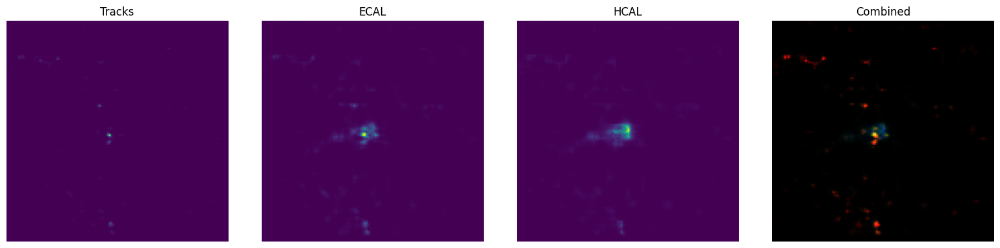

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


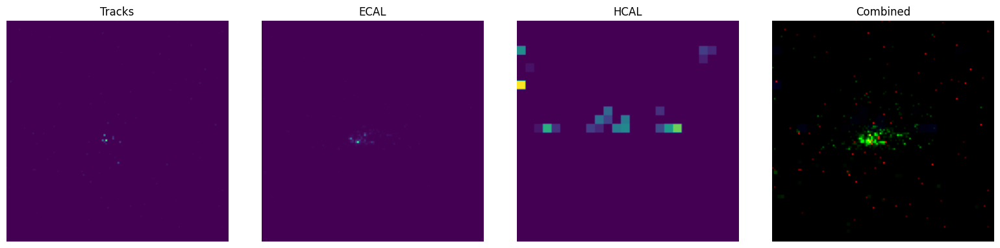

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


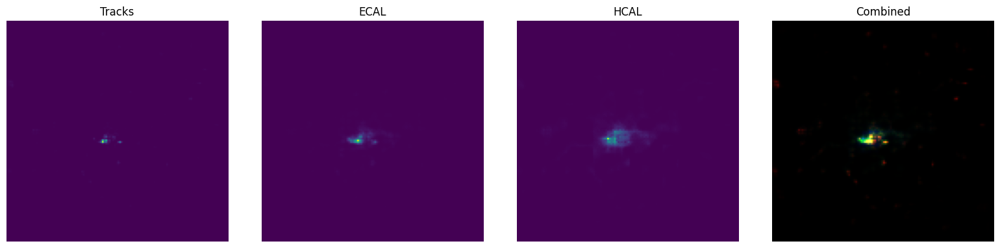

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


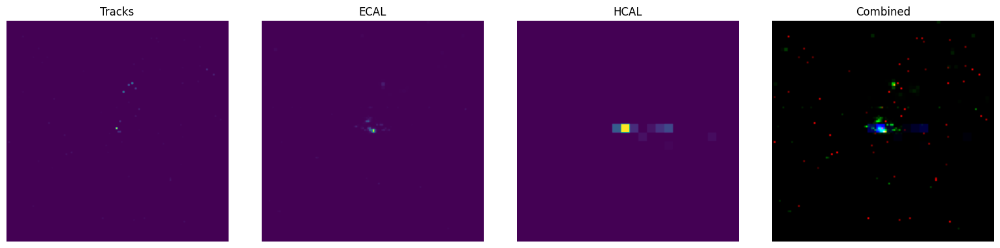

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


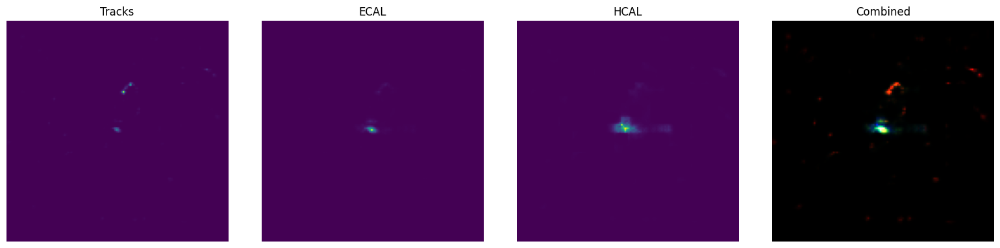

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


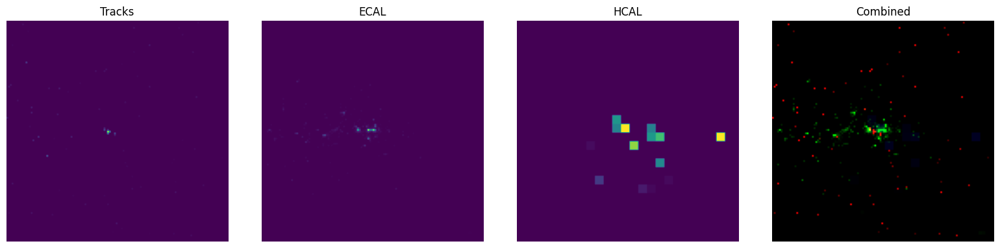

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


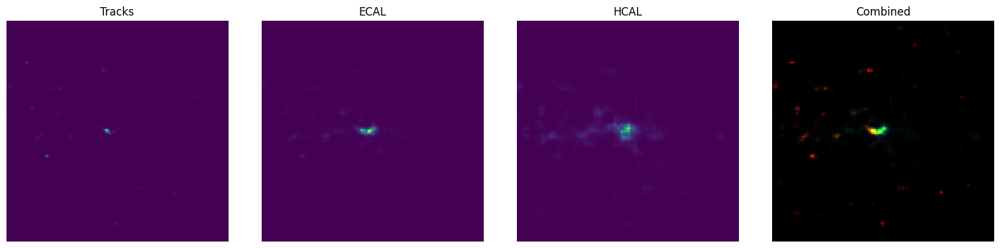

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


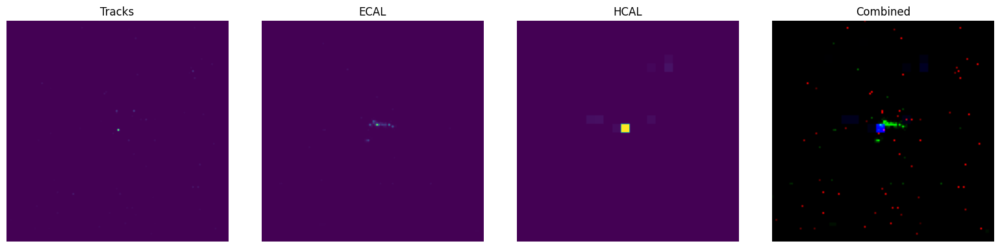

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


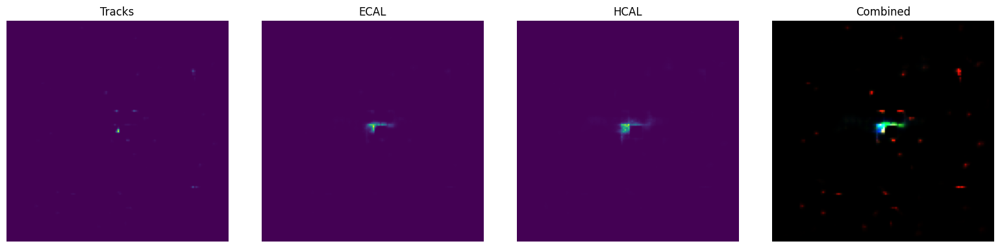

epoch: 41


100%|█████████████████████████████████████████| 625/625 [06:18<00:00,  1.65it/s]


train_loss: 0.00015184239014051854
epoch: 42


100%|█████████████████████████████████████████| 625/625 [06:18<00:00,  1.65it/s]


train_loss: 0.0001504754171008244
epoch: 43


100%|█████████████████████████████████████████| 625/625 [06:22<00:00,  1.63it/s]


train_loss: 0.00014865877963602544
epoch: 44


100%|█████████████████████████████████████████| 625/625 [06:18<00:00,  1.65it/s]


train_loss: 0.0001476686808047816
epoch: 45


100%|█████████████████████████████████████████| 625/625 [06:18<00:00,  1.65it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.00014657752830535173
Sample #0


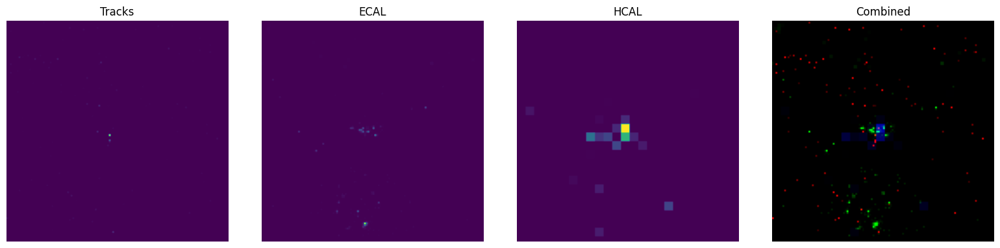

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


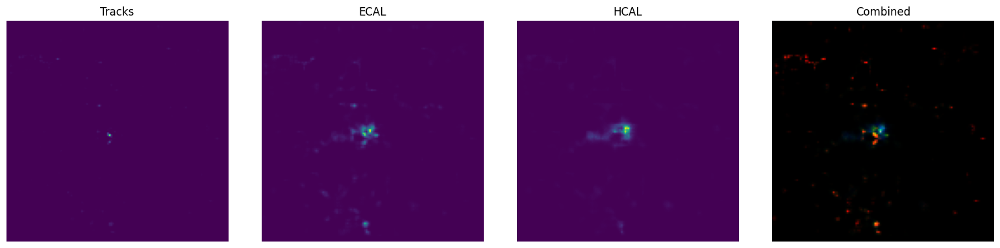

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


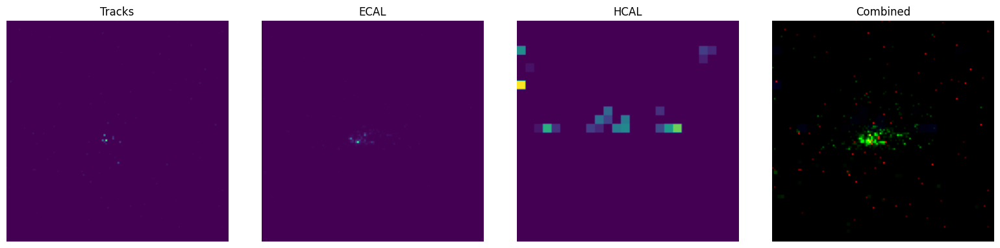

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


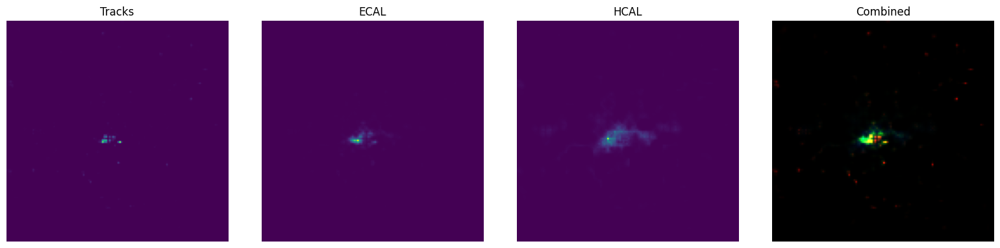

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


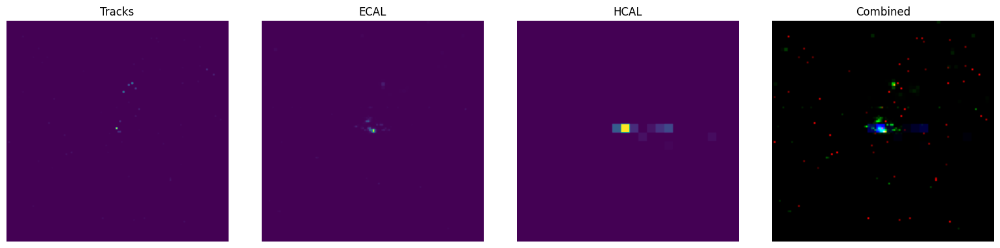

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


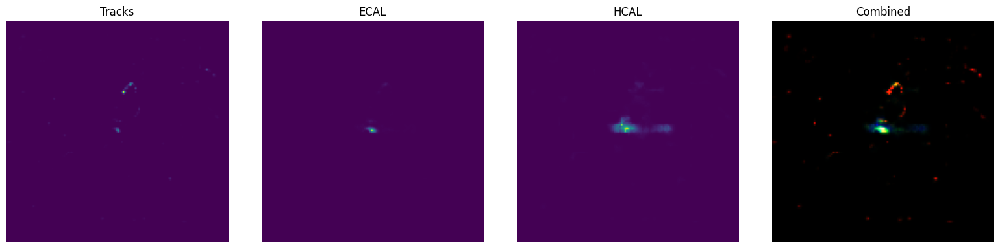

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


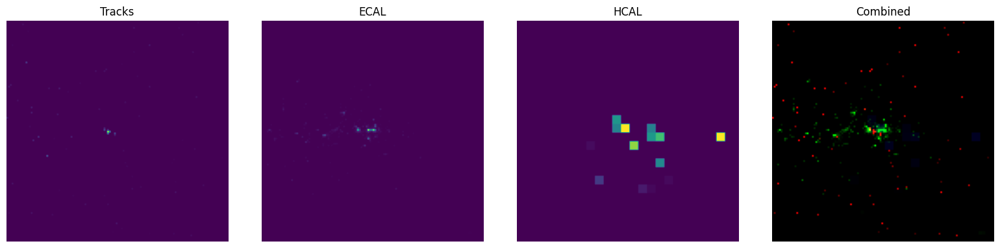

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


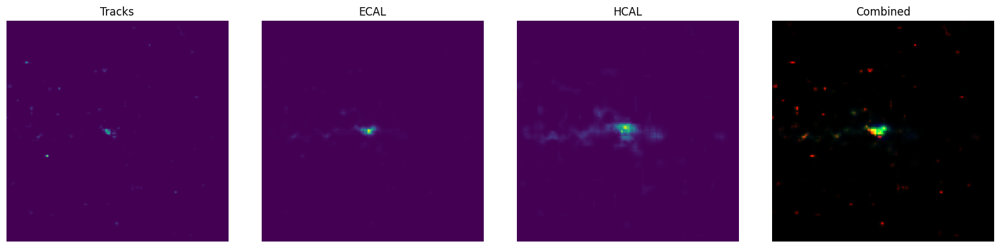

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


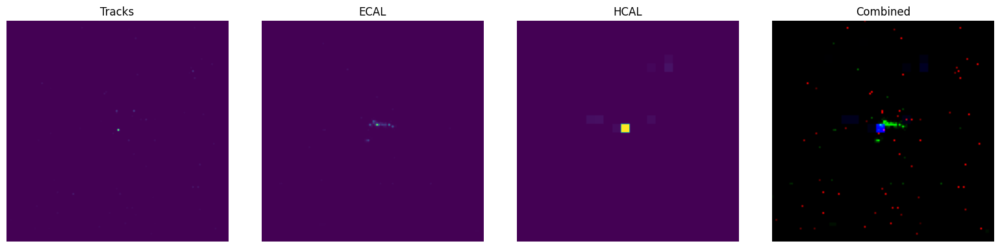

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


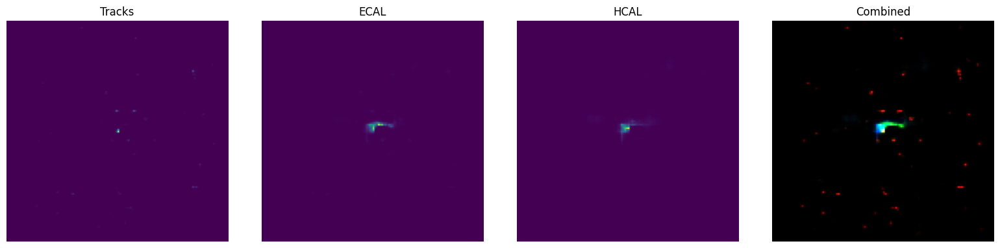

epoch: 46


100%|█████████████████████████████████████████| 625/625 [06:18<00:00,  1.65it/s]


train_loss: 0.00014563197835814208
epoch: 47


100%|█████████████████████████████████████████| 625/625 [06:18<00:00,  1.65it/s]


train_loss: 0.0001447931282222271
epoch: 48


100%|█████████████████████████████████████████| 625/625 [06:18<00:00,  1.65it/s]


train_loss: 0.00014397278157994152
epoch: 49


100%|█████████████████████████████████████████| 625/625 [06:18<00:00,  1.65it/s]


train_loss: 0.0001429521227022633
epoch: 50


100%|█████████████████████████████████████████| 625/625 [06:17<00:00,  1.65it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.00014239331891294568
Sample #0


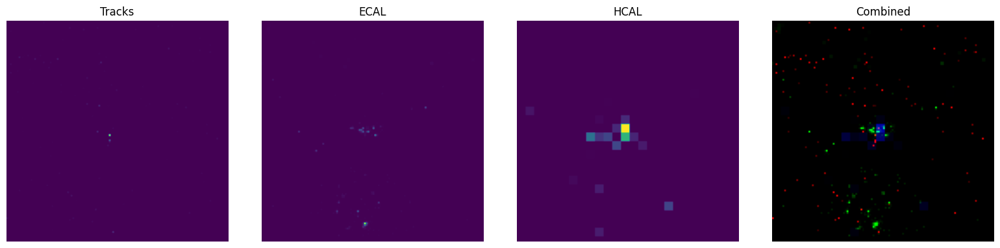

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


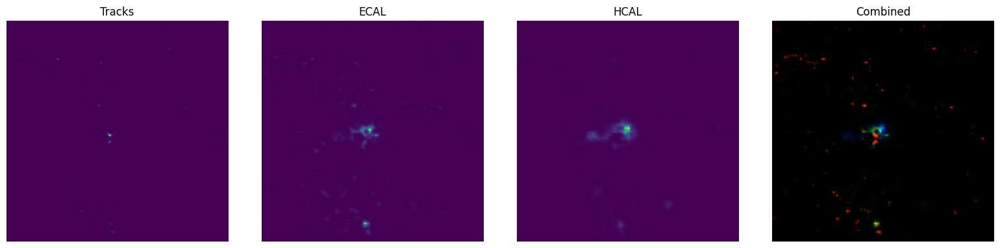

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


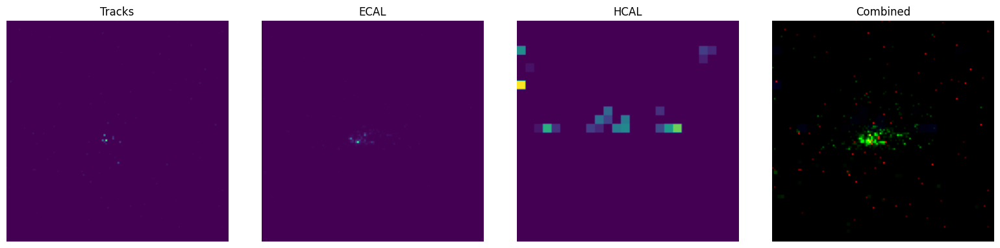

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


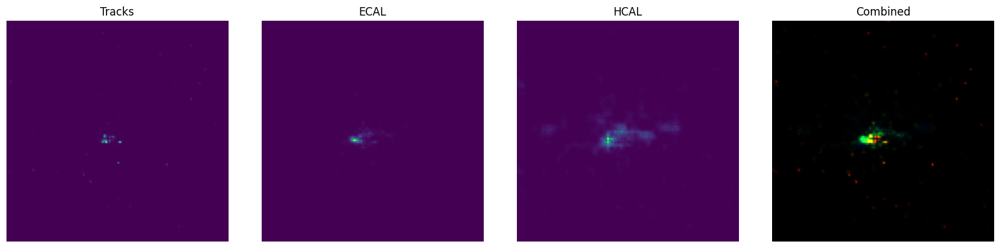

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


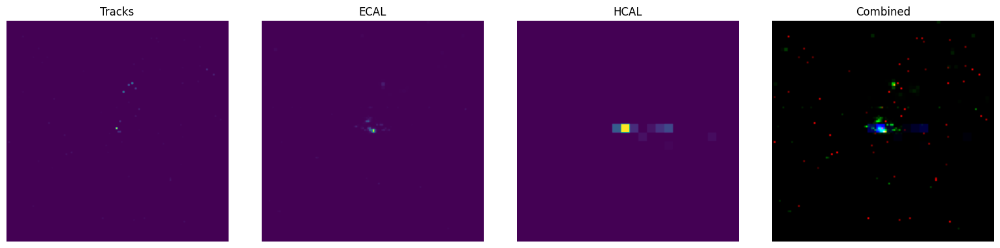

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


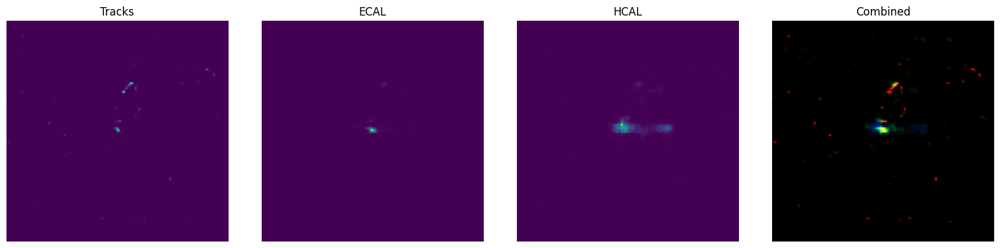

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


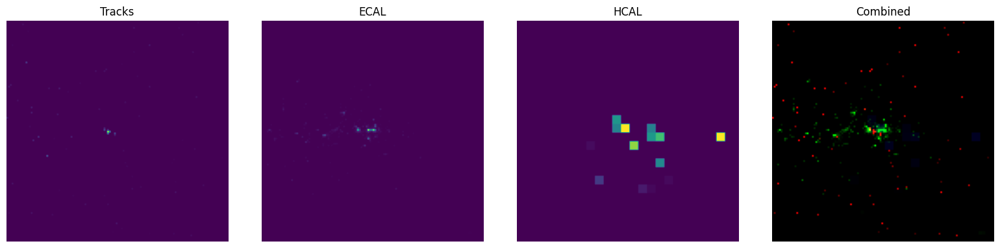

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


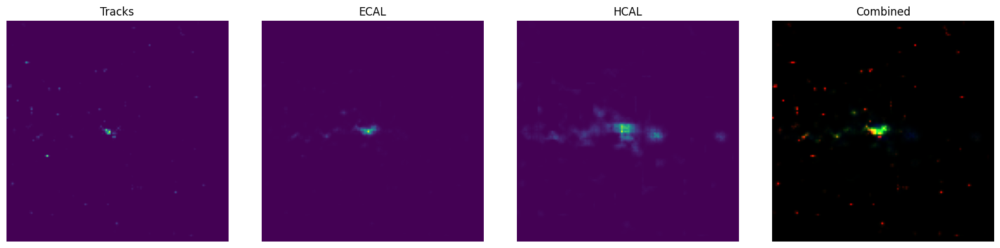

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


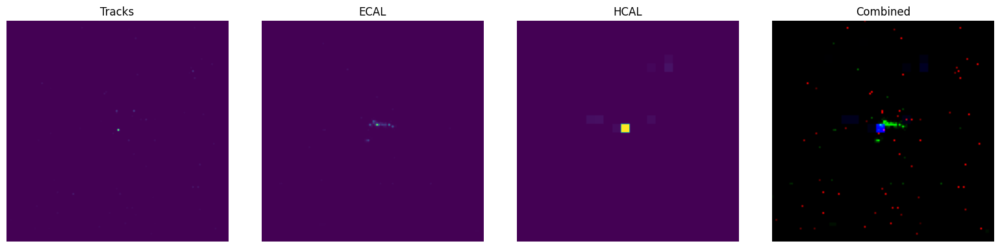

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


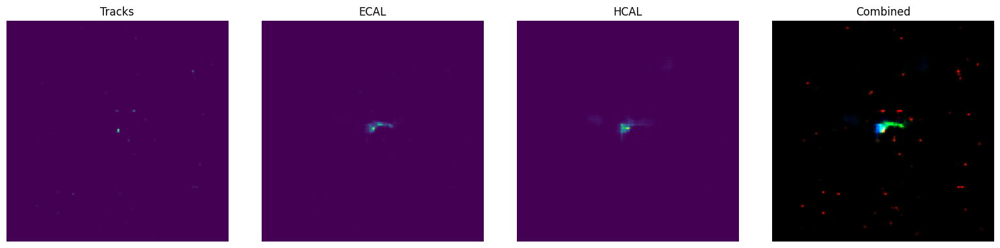

epoch: 51


100%|█████████████████████████████████████████| 625/625 [06:18<00:00,  1.65it/s]


train_loss: 0.00014161151081789285
epoch: 52


100%|█████████████████████████████████████████| 625/625 [06:19<00:00,  1.65it/s]


train_loss: 0.0001407093039015308
epoch: 53


100%|█████████████████████████████████████████| 625/625 [06:20<00:00,  1.64it/s]


train_loss: 0.00014051673514768481
epoch: 54


100%|█████████████████████████████████████████| 625/625 [06:21<00:00,  1.64it/s]


train_loss: 0.0001393810778623447
epoch: 55


100%|█████████████████████████████████████████| 625/625 [06:21<00:00,  1.64it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.00013886408919934183
Sample #0


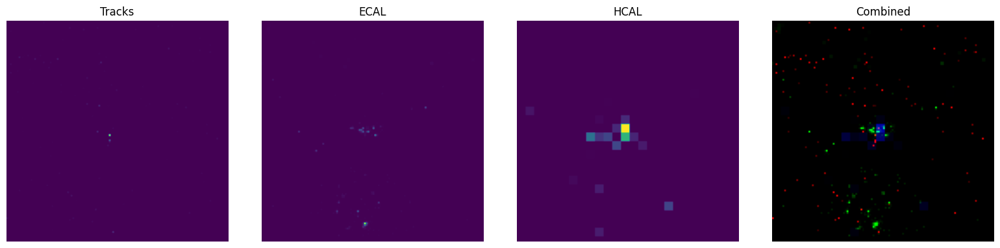

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


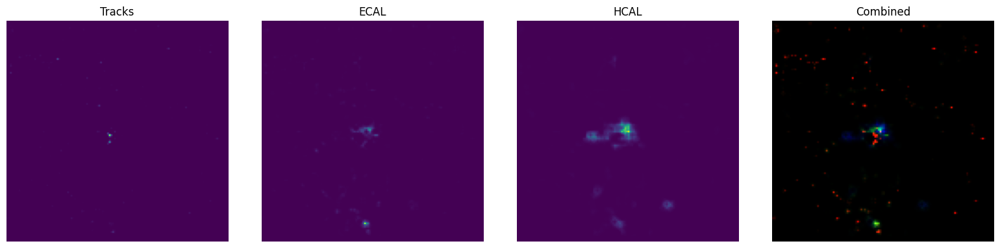

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


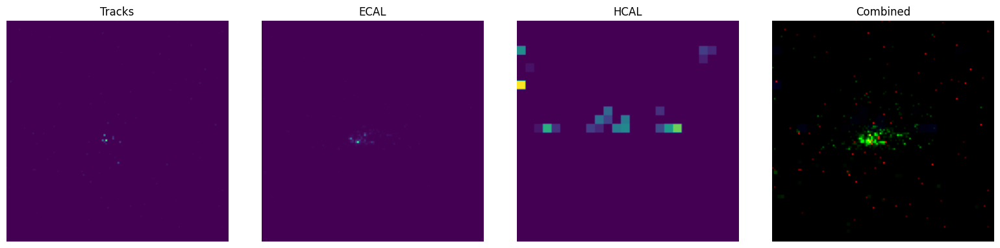

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


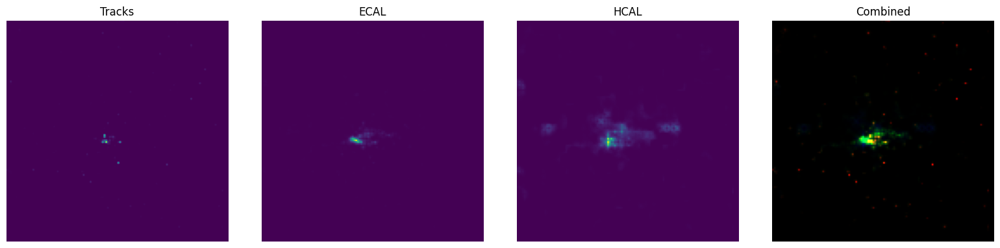

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


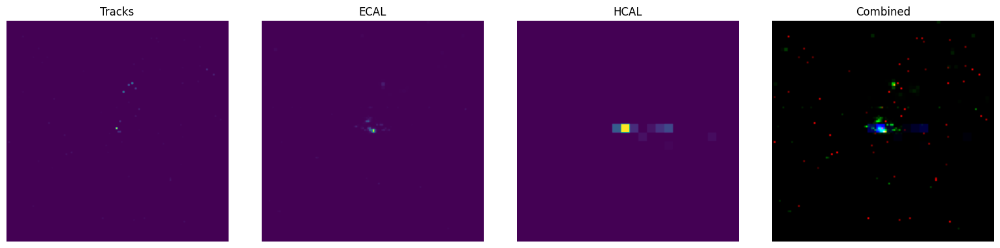

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


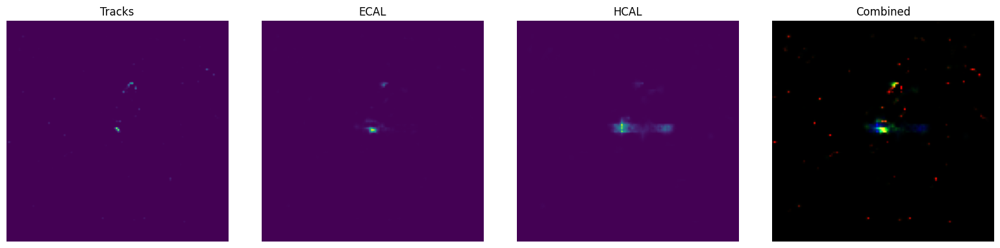

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


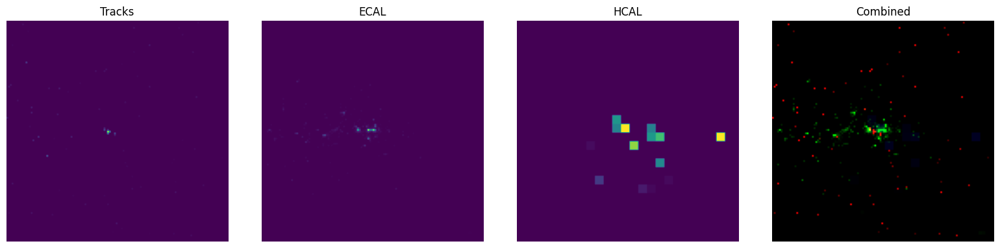

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


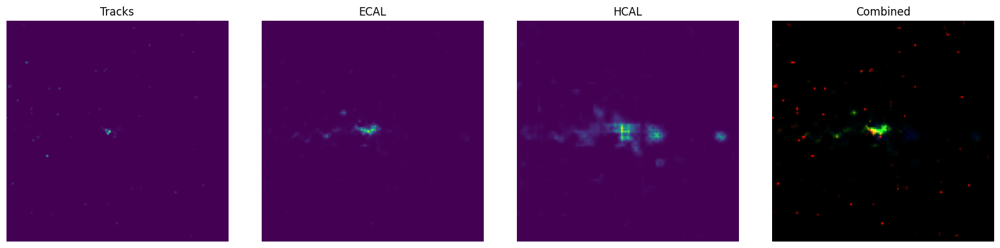

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


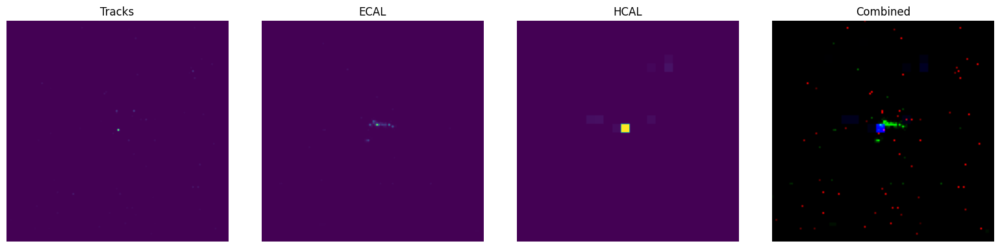

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


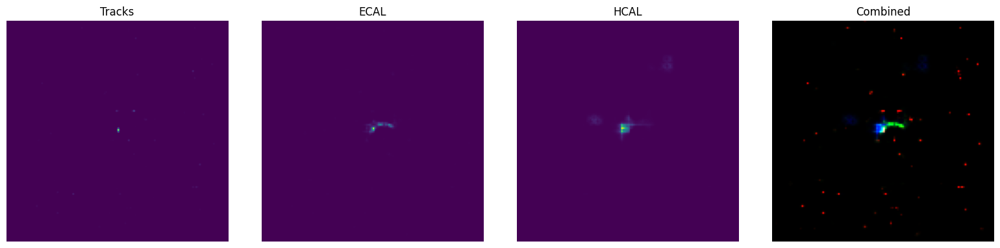

epoch: 56


100%|█████████████████████████████████████████| 625/625 [06:22<00:00,  1.63it/s]


train_loss: 0.00013828614342492073
epoch: 57


100%|█████████████████████████████████████████| 625/625 [06:22<00:00,  1.63it/s]


train_loss: 0.0001375902398955077
epoch: 58


100%|█████████████████████████████████████████| 625/625 [06:23<00:00,  1.63it/s]


train_loss: 0.00013713304672855885
epoch: 59


100%|█████████████████████████████████████████| 625/625 [06:22<00:00,  1.64it/s]


train_loss: 0.00013658522460609674
epoch: 60


100%|█████████████████████████████████████████| 625/625 [06:21<00:00,  1.64it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.00013631456627044827
Sample #0


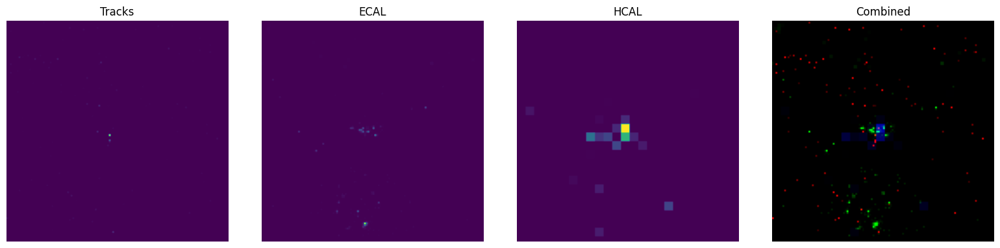

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


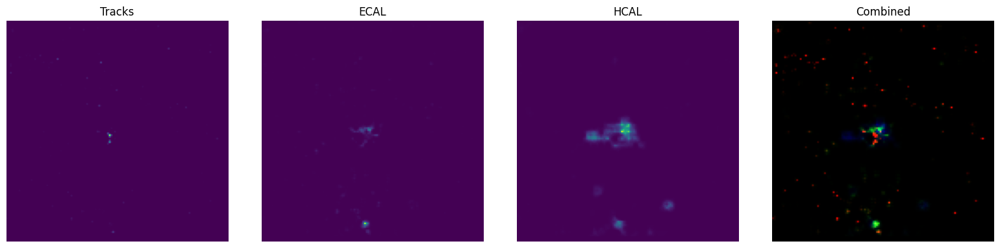

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


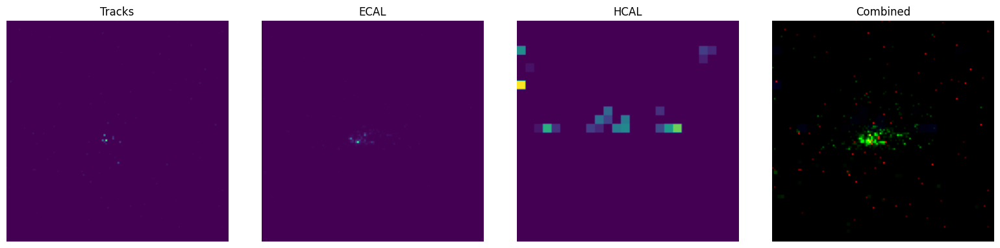

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


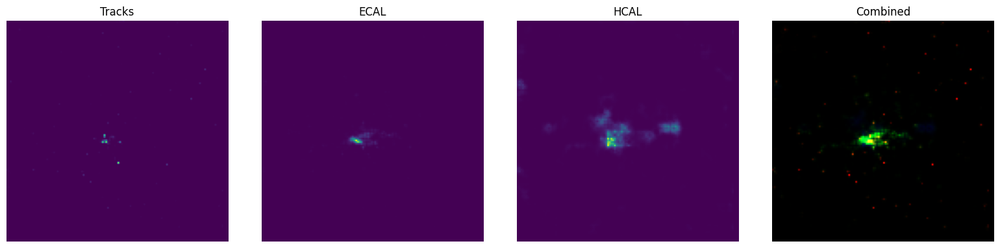

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


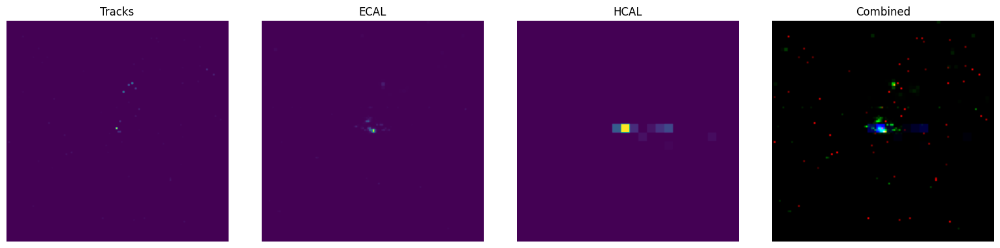

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


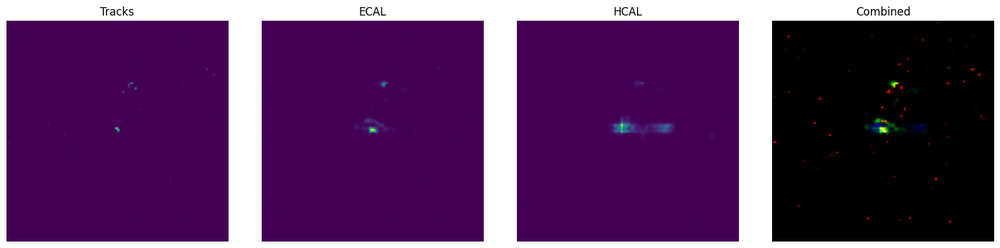

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


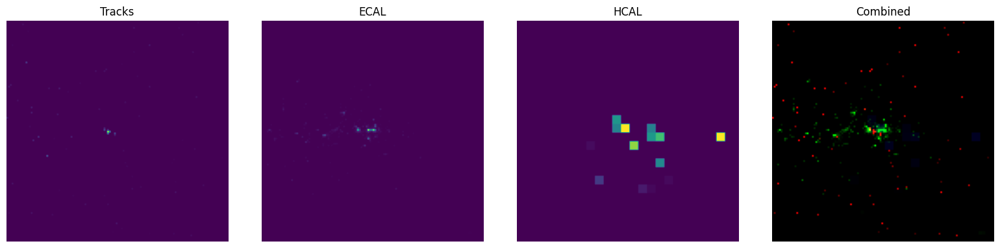

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


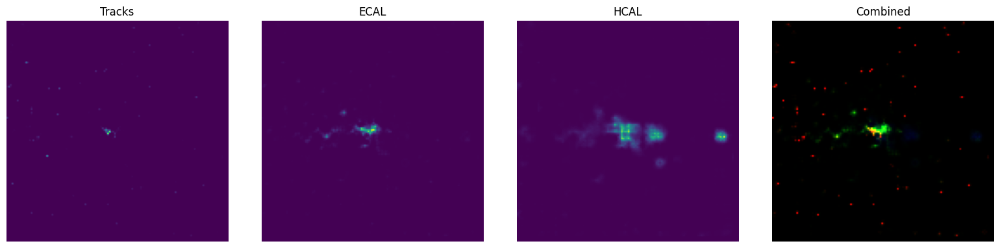

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


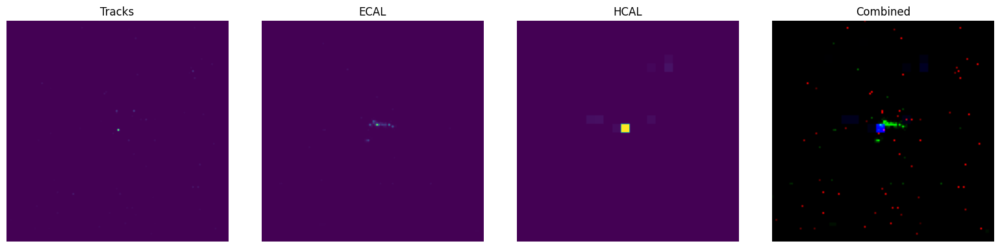

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


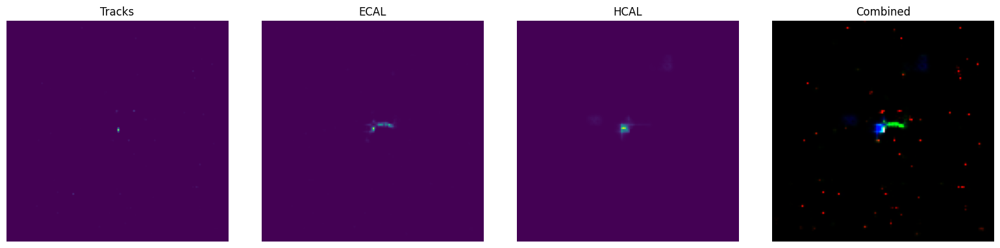

epoch: 61


100%|█████████████████████████████████████████| 625/625 [06:20<00:00,  1.64it/s]


train_loss: 0.00013581425342708826
epoch: 62


100%|█████████████████████████████████████████| 625/625 [06:21<00:00,  1.64it/s]


train_loss: 0.00013532312263268977
epoch: 63


100%|█████████████████████████████████████████| 625/625 [06:33<00:00,  1.59it/s]


train_loss: 0.0001348392387619242
epoch: 64


100%|█████████████████████████████████████████| 625/625 [06:22<00:00,  1.64it/s]


train_loss: 0.0001344575874740258
epoch: 65


100%|█████████████████████████████████████████| 625/625 [06:21<00:00,  1.64it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.0001346516001271084
Sample #0


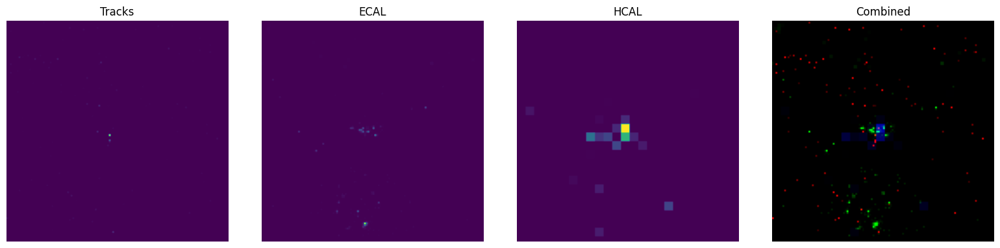

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


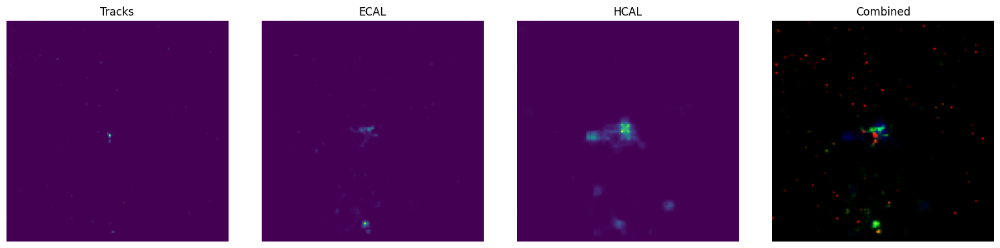

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


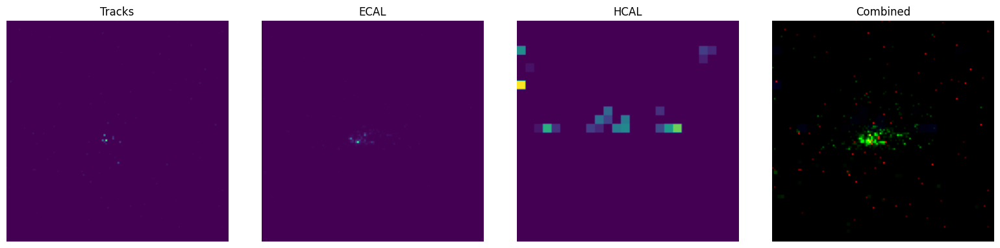

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


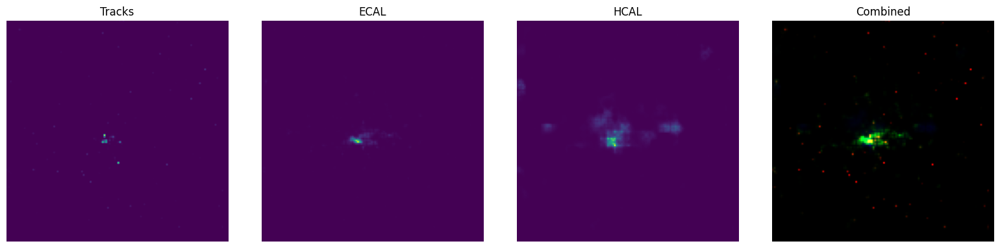

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


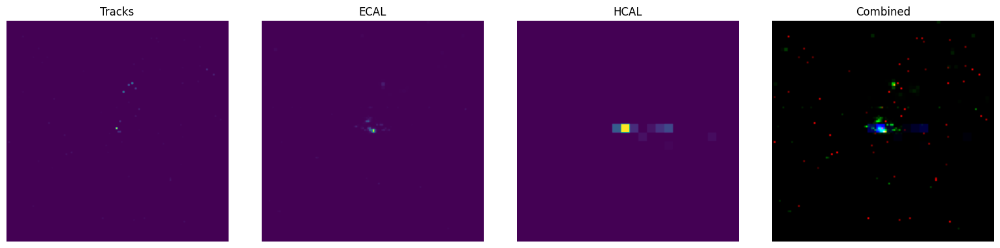

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


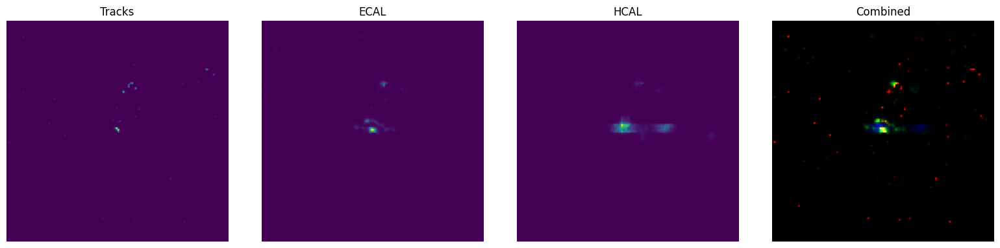

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


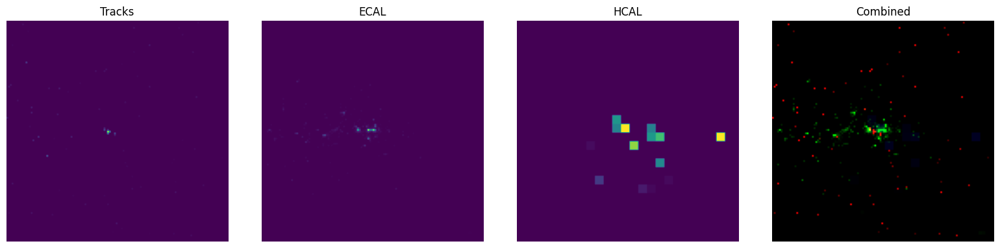

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


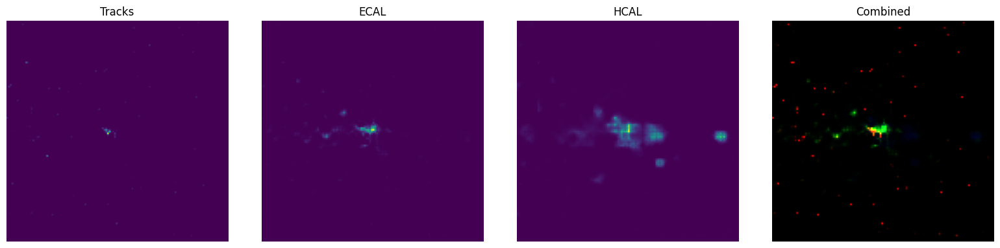

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


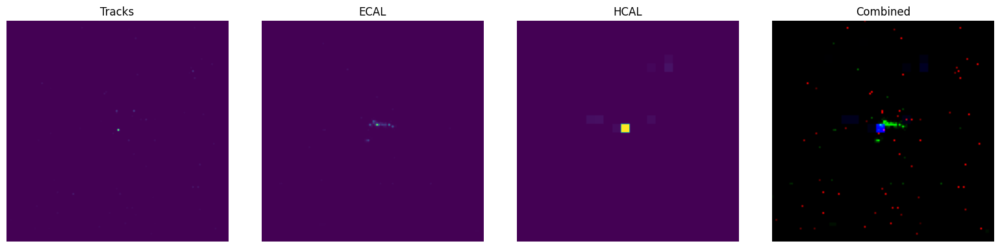

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


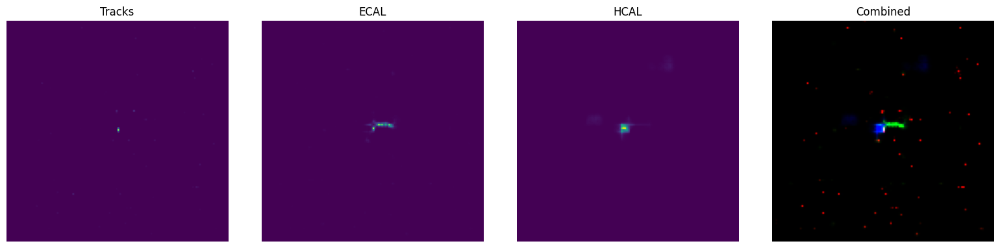

epoch: 66


100%|█████████████████████████████████████████| 625/625 [06:21<00:00,  1.64it/s]


train_loss: 0.00013386954935267568
epoch: 67


100%|█████████████████████████████████████████| 625/625 [06:23<00:00,  1.63it/s]


train_loss: 0.0001336249261163175
epoch: 68


100%|█████████████████████████████████████████| 625/625 [06:22<00:00,  1.63it/s]


train_loss: 0.0001333916104864329
epoch: 69


100%|█████████████████████████████████████████| 625/625 [06:23<00:00,  1.63it/s]


train_loss: 0.00013308791466988624
epoch: 70


100%|█████████████████████████████████████████| 625/625 [06:22<00:00,  1.63it/s]


train_loss: 0.00013280406545381992
Sample #0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


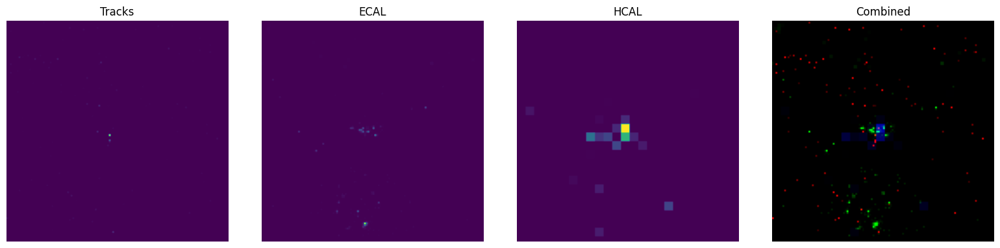

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


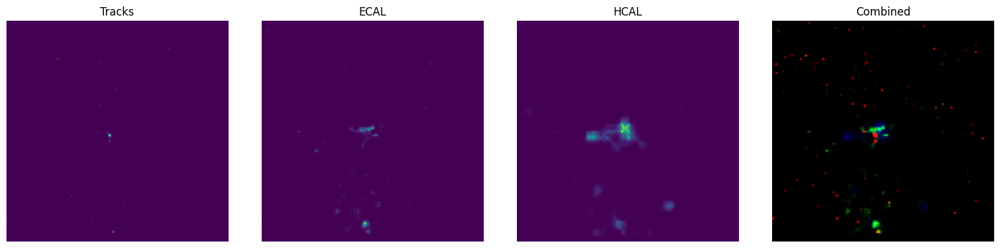

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


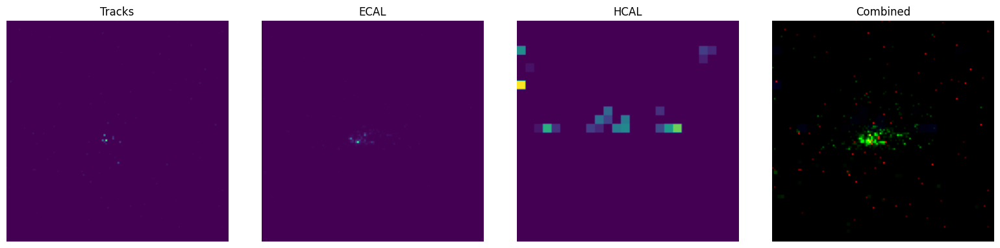

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


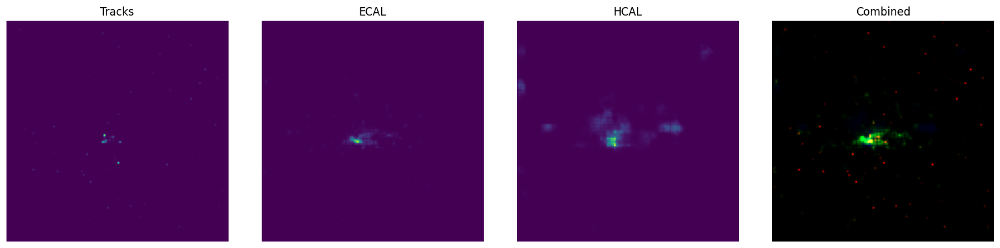

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


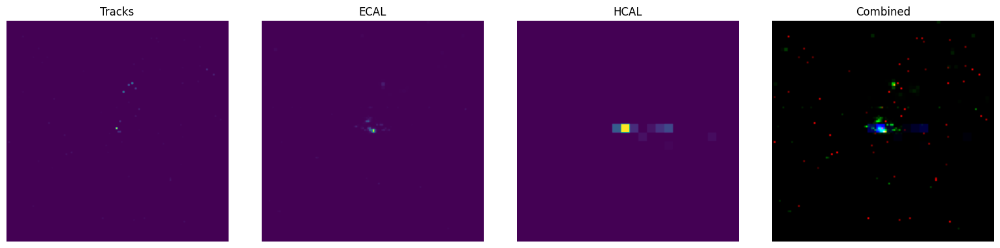

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


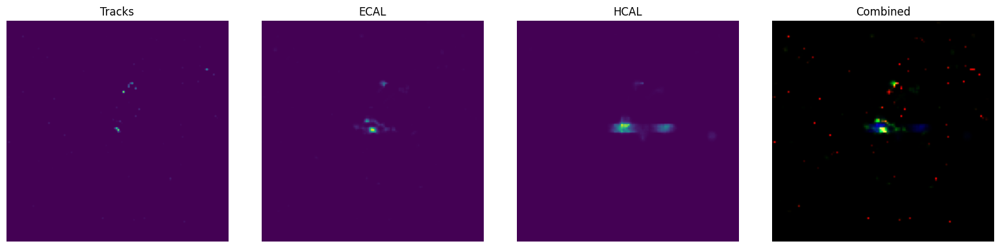

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


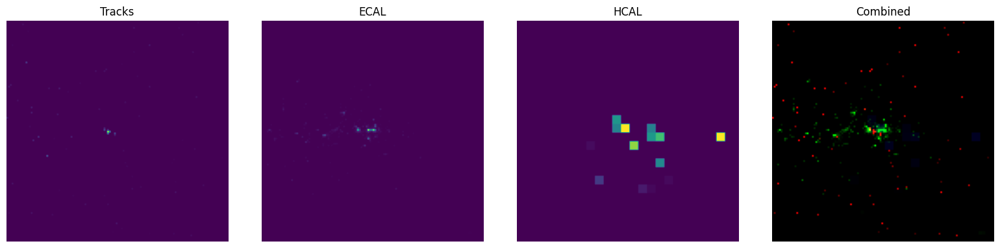

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


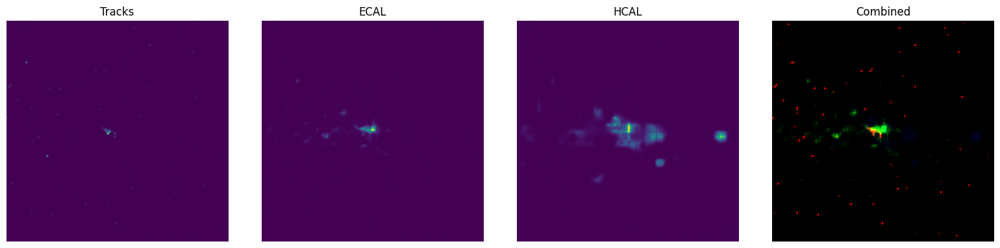

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


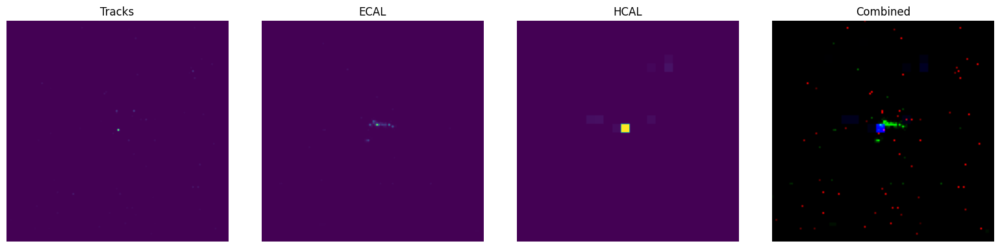

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


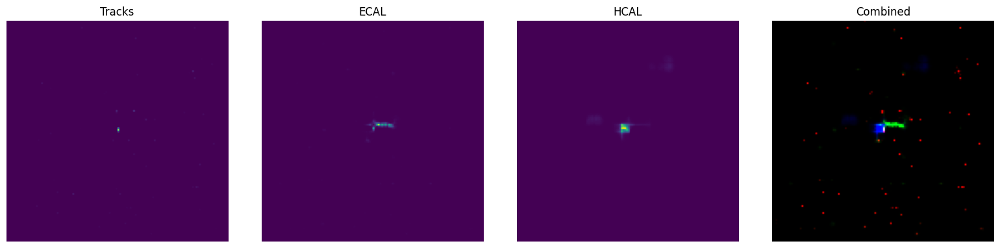

epoch: 71


100%|█████████████████████████████████████████| 625/625 [06:23<00:00,  1.63it/s]


train_loss: 0.0001325753801735118
epoch: 72


100%|█████████████████████████████████████████| 625/625 [06:23<00:00,  1.63it/s]


train_loss: 0.00013233414518181236
epoch: 73


100%|█████████████████████████████████████████| 625/625 [06:33<00:00,  1.59it/s]


train_loss: 0.00013217490962706506
epoch: 74


100%|█████████████████████████████████████████| 625/625 [06:24<00:00,  1.63it/s]


train_loss: 0.00013186789255123586
epoch: 75


100%|█████████████████████████████████████████| 625/625 [06:26<00:00,  1.62it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.00013162496762815864
Sample #0


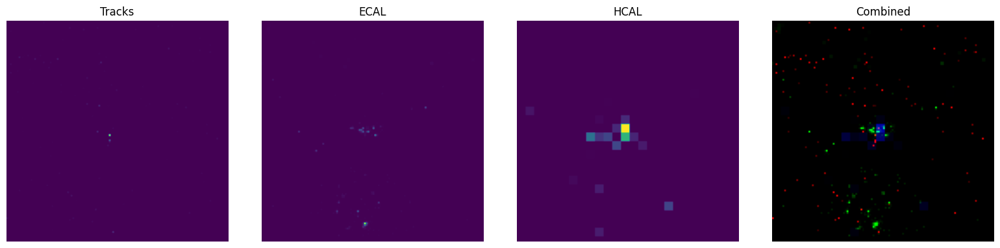

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


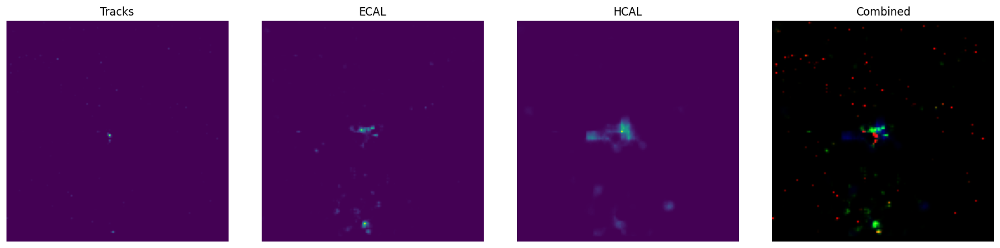

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


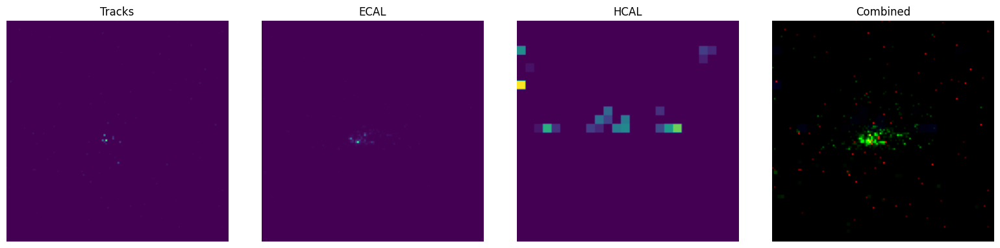

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


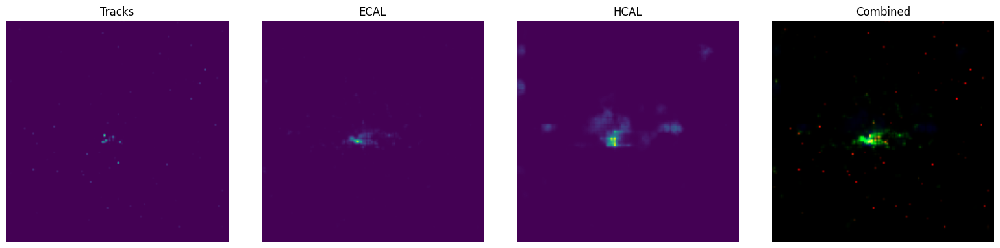

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


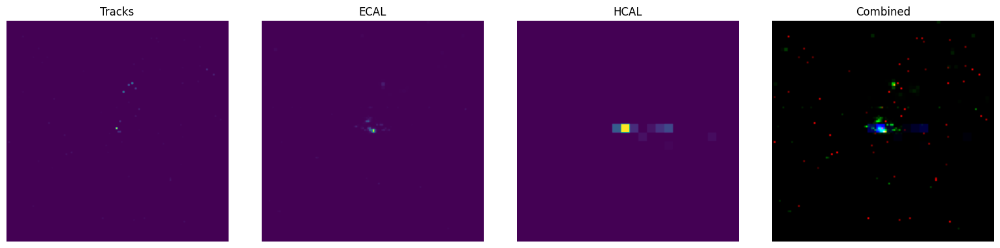

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


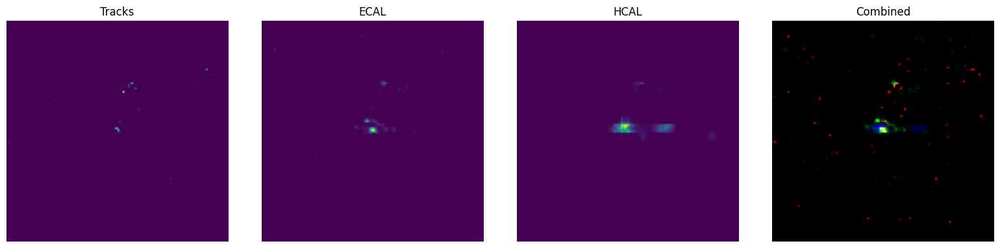

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


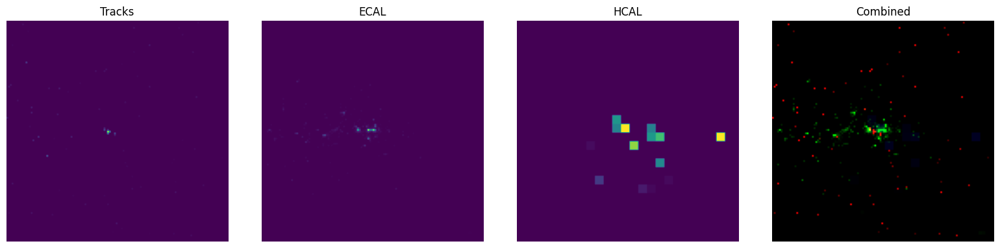

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


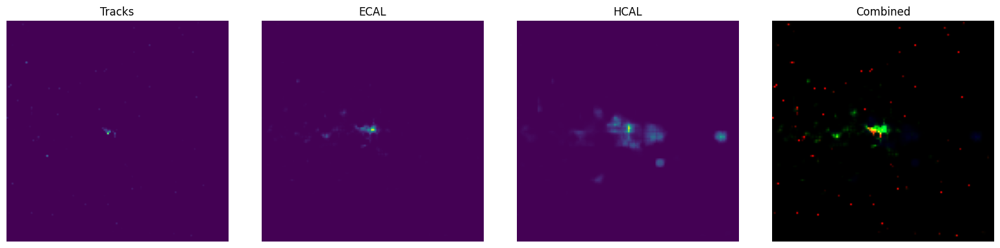

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


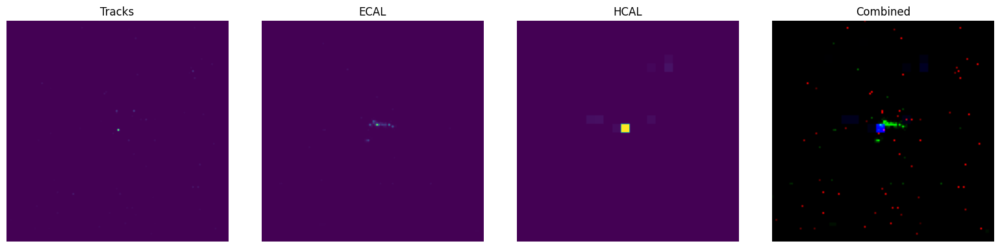

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


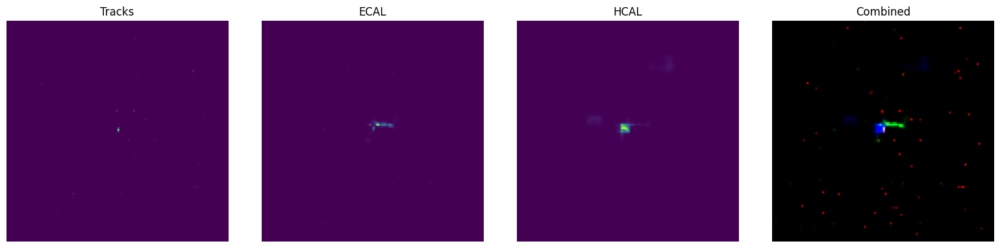

epoch: 76


100%|█████████████████████████████████████████| 625/625 [06:28<00:00,  1.61it/s]


train_loss: 0.00013137997346930207
epoch: 77


100%|█████████████████████████████████████████| 625/625 [06:29<00:00,  1.60it/s]


train_loss: 0.00013115636992733925
epoch: 78


100%|█████████████████████████████████████████| 625/625 [06:29<00:00,  1.61it/s]


train_loss: 0.00013089479899499565
epoch: 79


100%|█████████████████████████████████████████| 625/625 [06:30<00:00,  1.60it/s]


train_loss: 0.0001306827039923519
epoch: 80


100%|█████████████████████████████████████████| 625/625 [06:31<00:00,  1.60it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.00013046567314304412
Sample #0


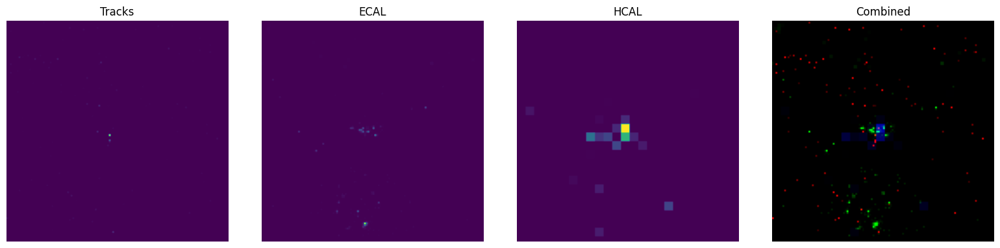

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


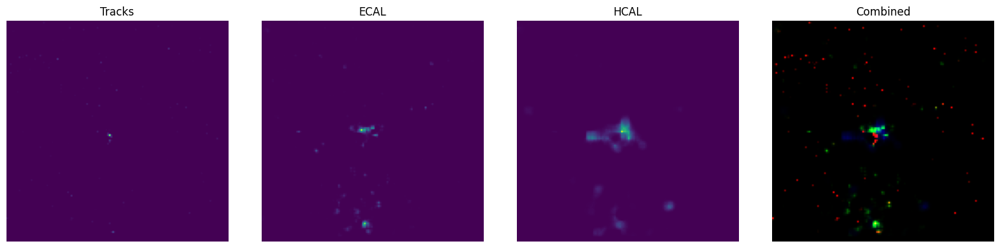

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


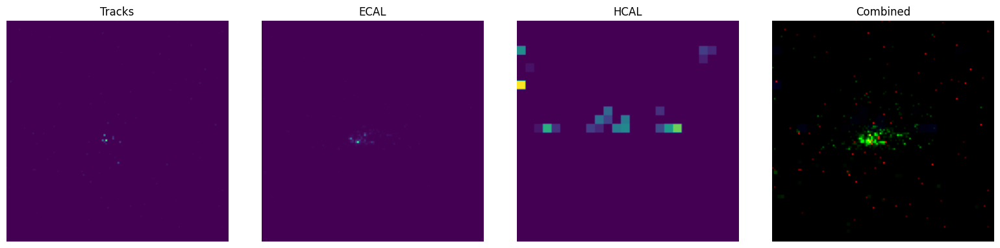

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


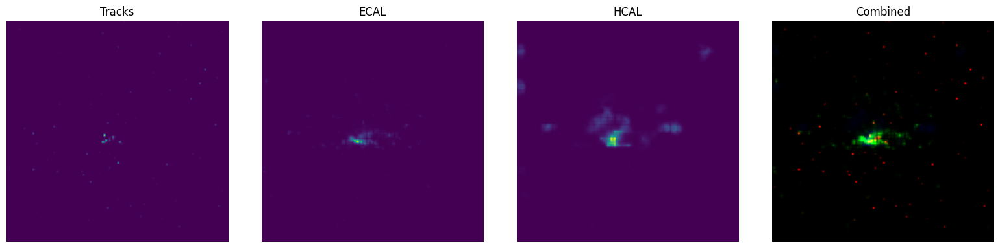

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


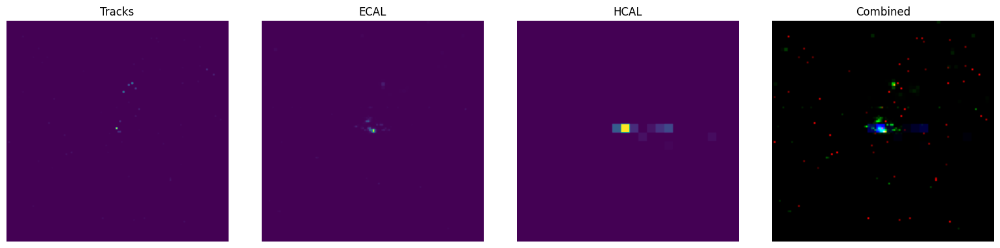

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


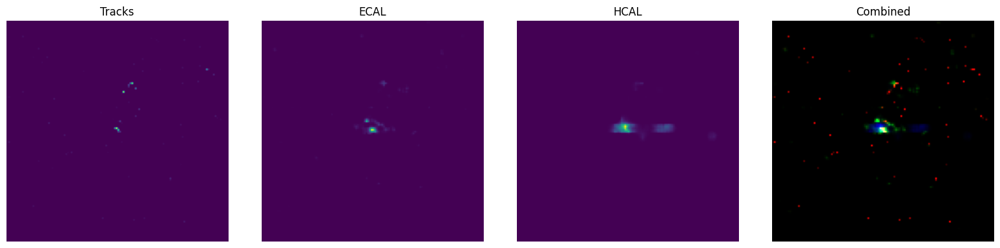

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


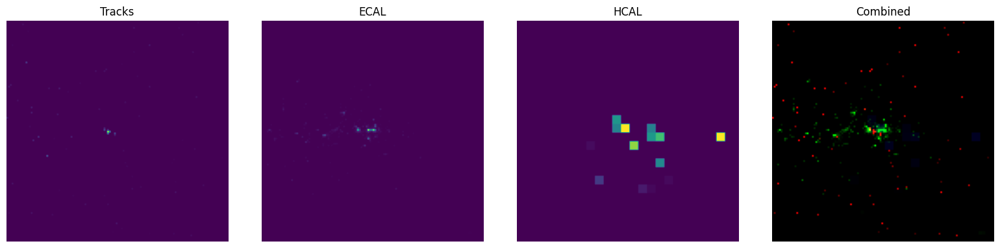

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


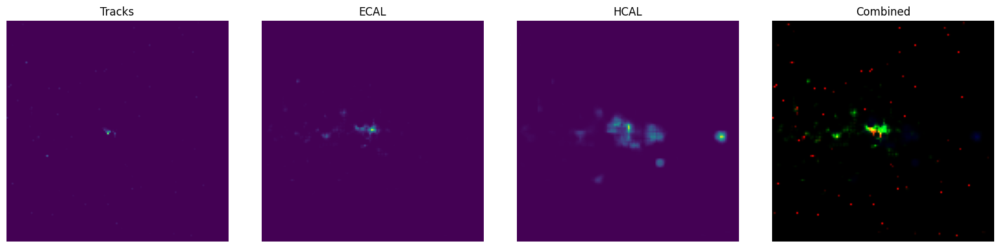

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


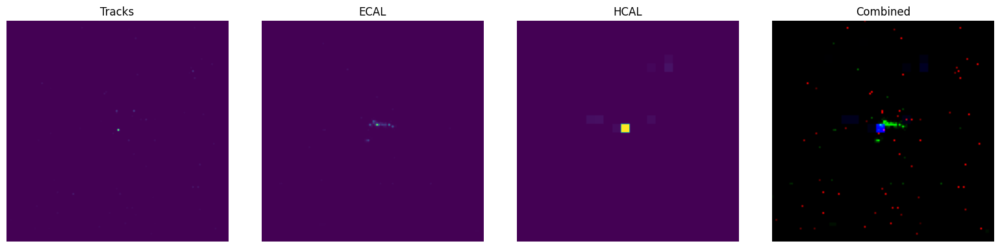

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


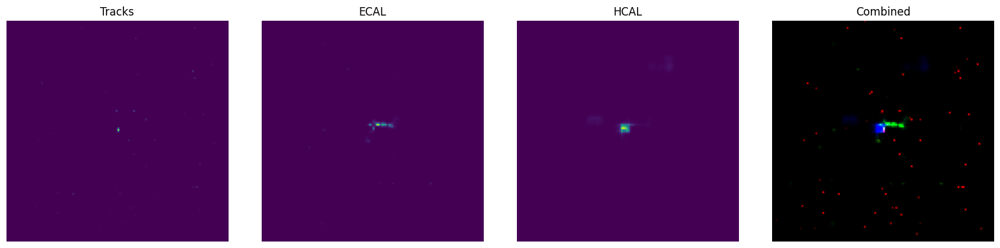

epoch: 81


100%|█████████████████████████████████████████| 625/625 [06:32<00:00,  1.59it/s]


train_loss: 0.0001302681922679767
epoch: 82


100%|█████████████████████████████████████████| 625/625 [06:32<00:00,  1.59it/s]


train_loss: 0.0001300991331692785
epoch: 83


100%|█████████████████████████████████████████| 625/625 [06:33<00:00,  1.59it/s]


train_loss: 0.00012992516260128468
epoch: 84


100%|█████████████████████████████████████████| 625/625 [06:35<00:00,  1.58it/s]


train_loss: 0.00012975444647017866
epoch: 85


100%|█████████████████████████████████████████| 625/625 [06:35<00:00,  1.58it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.00012960823872126638
Sample #0


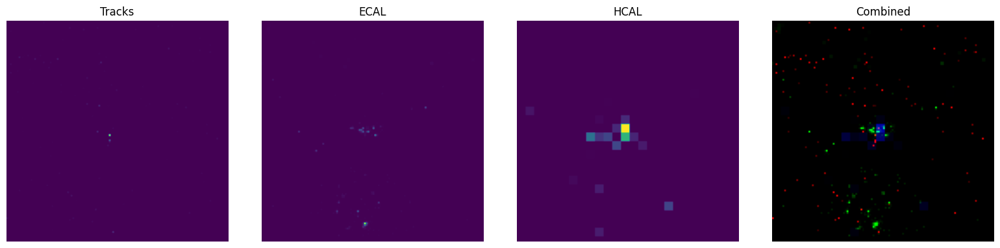

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


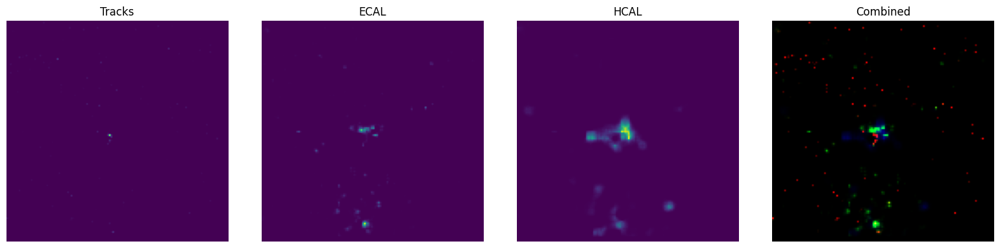

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


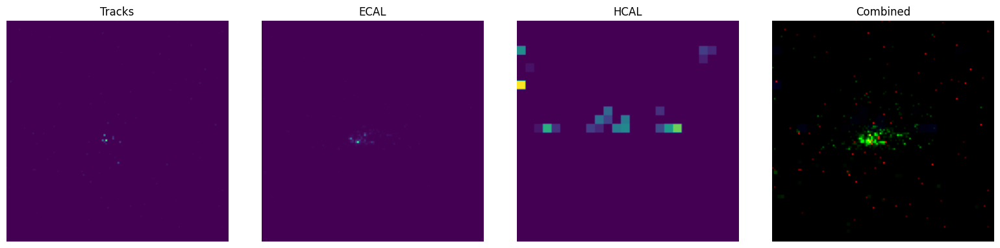

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


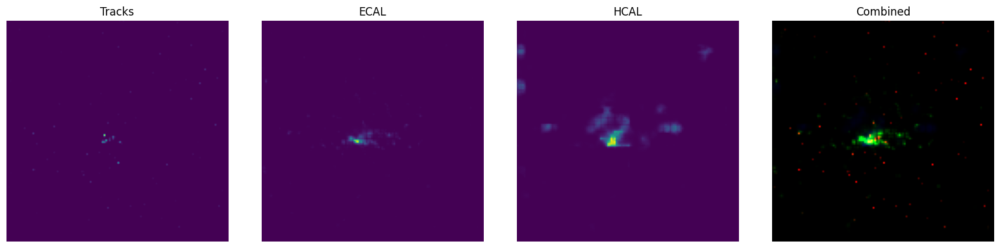

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


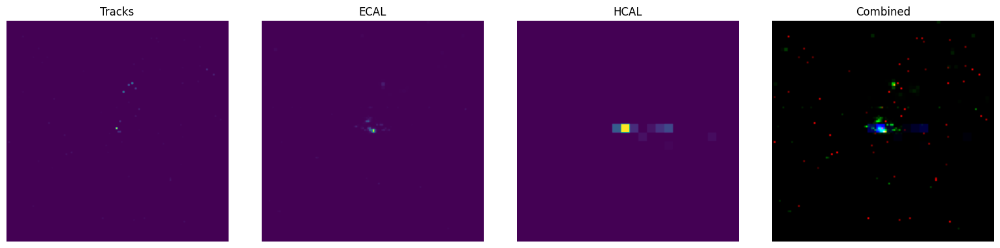

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


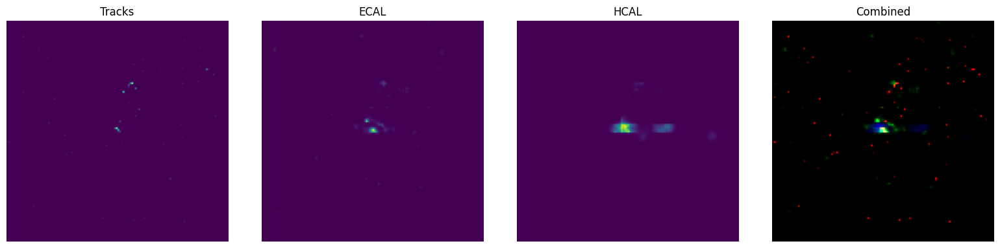

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


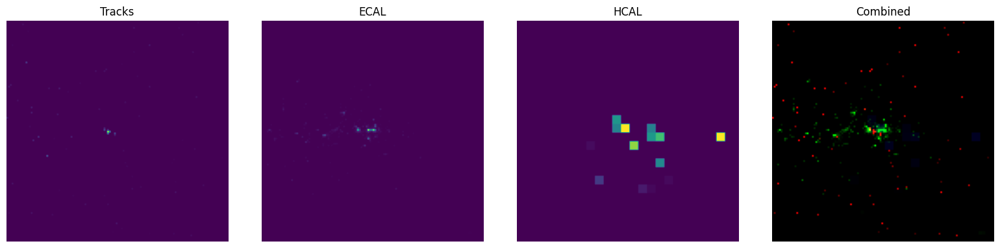

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


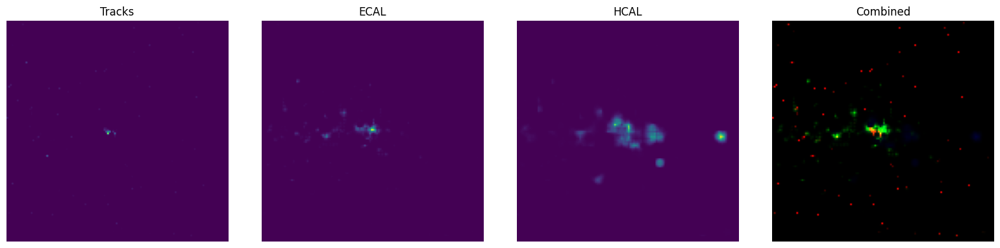

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


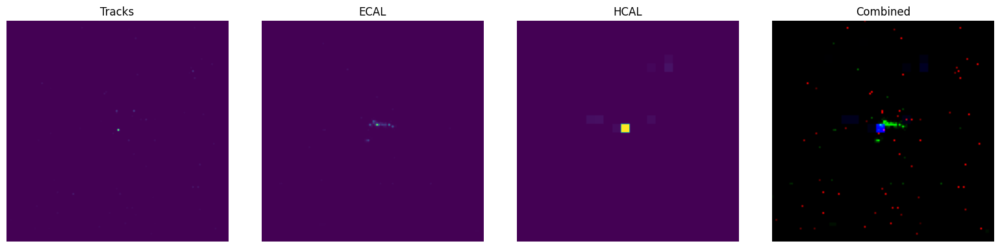

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


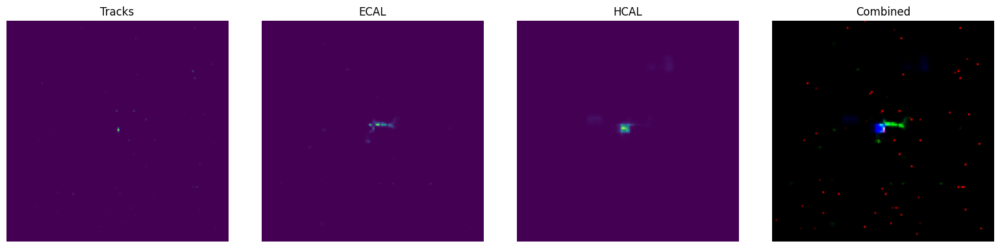

epoch: 86


100%|█████████████████████████████████████████| 625/625 [06:34<00:00,  1.58it/s]


train_loss: 0.00012946182580199093
epoch: 87


100%|█████████████████████████████████████████| 625/625 [06:35<00:00,  1.58it/s]


train_loss: 0.00012931996653787792
epoch: 88


100%|█████████████████████████████████████████| 625/625 [06:35<00:00,  1.58it/s]


train_loss: 0.0001292005109600723
epoch: 89


100%|█████████████████████████████████████████| 625/625 [06:36<00:00,  1.58it/s]


train_loss: 0.0001290837197098881
epoch: 90


100%|█████████████████████████████████████████| 625/625 [06:37<00:00,  1.57it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.00012896920882631094
Sample #0


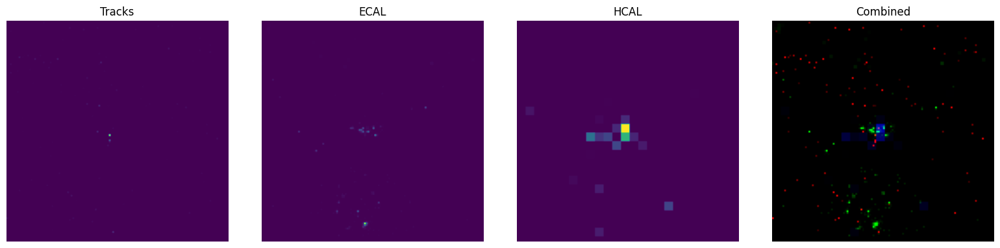

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


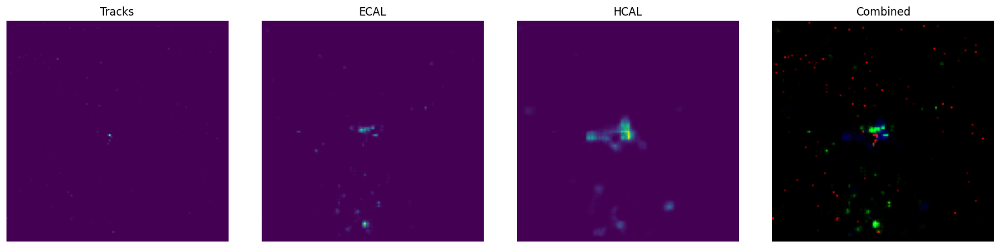

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


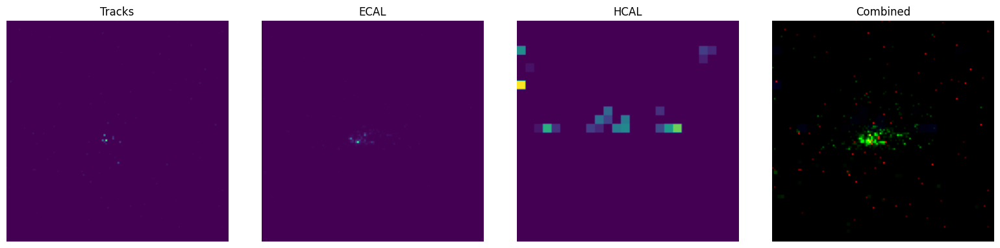

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


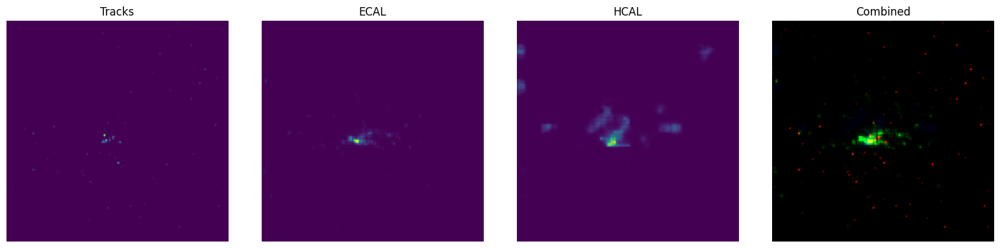

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


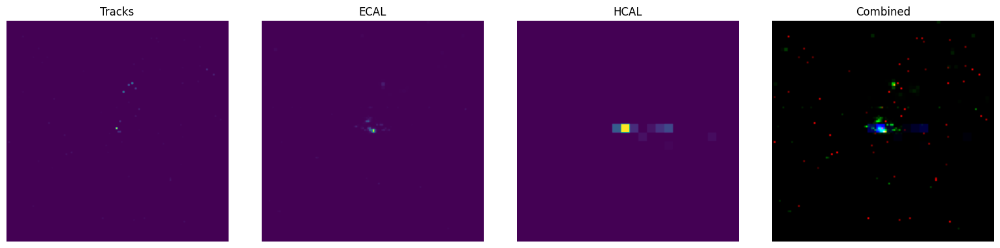

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


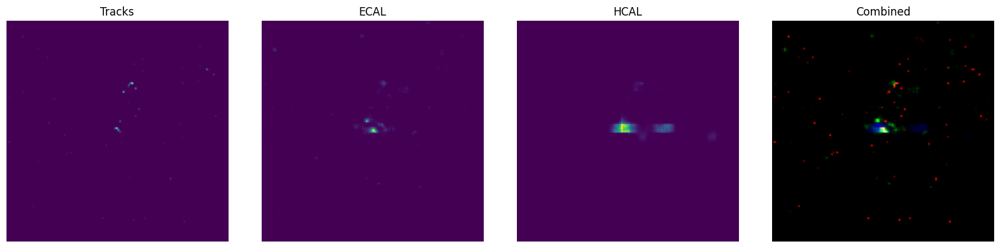

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


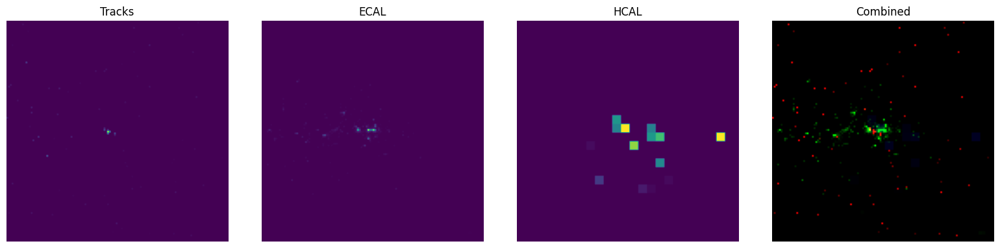

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


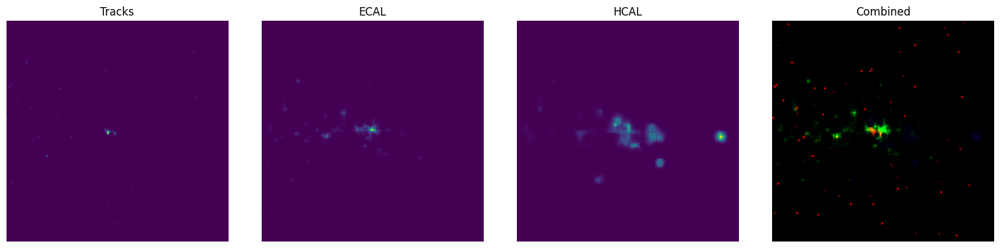

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


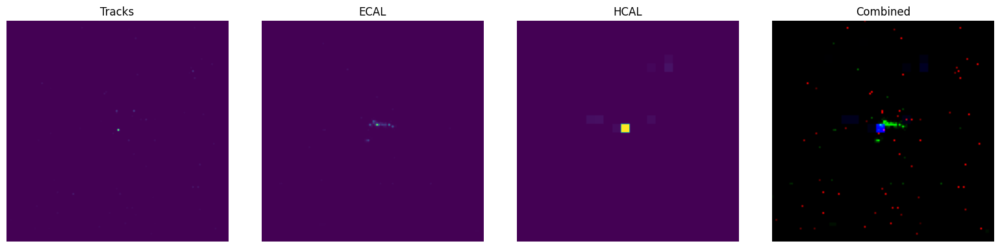

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


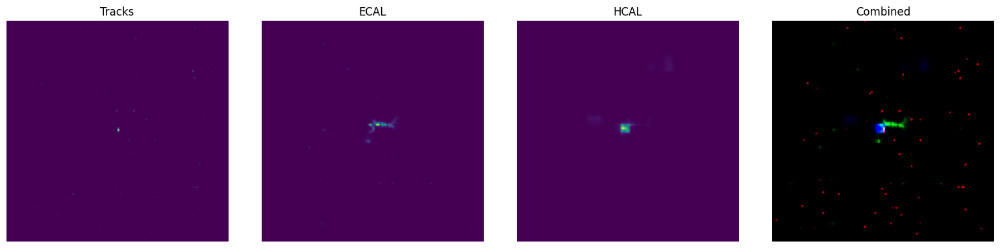

epoch: 91


100%|█████████████████████████████████████████| 625/625 [06:39<00:00,  1.56it/s]


train_loss: 0.00012886046993080527
epoch: 92


100%|█████████████████████████████████████████| 625/625 [06:40<00:00,  1.56it/s]


train_loss: 0.0001287649555131793
epoch: 93


100%|█████████████████████████████████████████| 625/625 [06:41<00:00,  1.56it/s]


train_loss: 0.00012865321231074633
epoch: 94


100%|█████████████████████████████████████████| 625/625 [06:42<00:00,  1.55it/s]


train_loss: 0.00012856879052706063
epoch: 95


100%|█████████████████████████████████████████| 625/625 [06:40<00:00,  1.56it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.000128472793684341
Sample #0


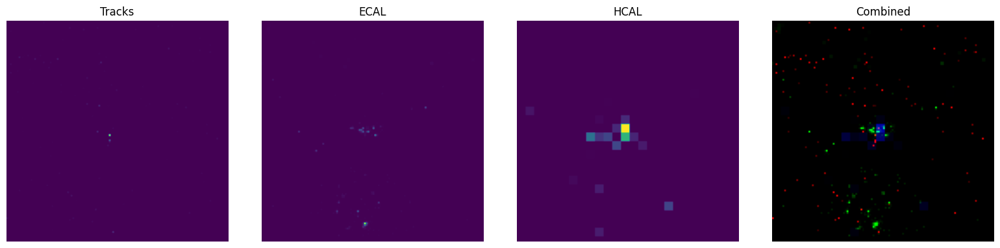

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


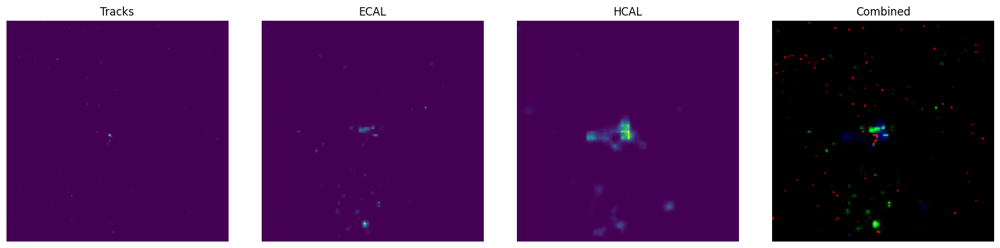

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


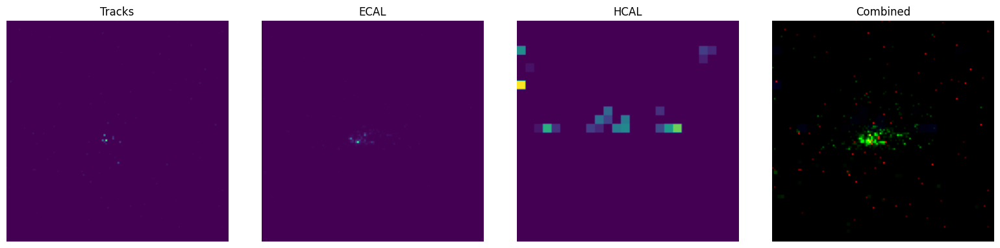

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


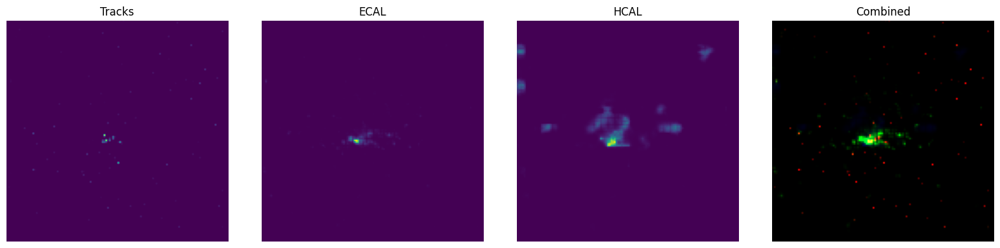

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


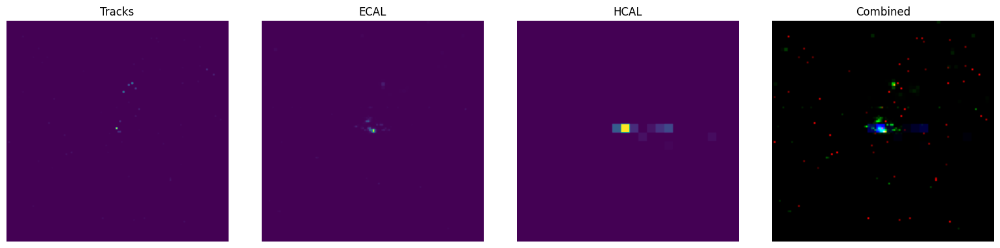

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


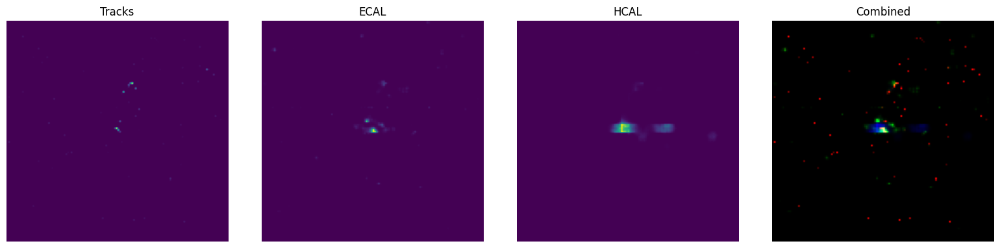

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


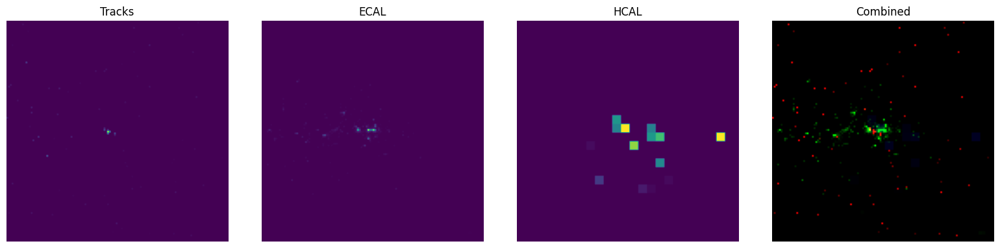

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


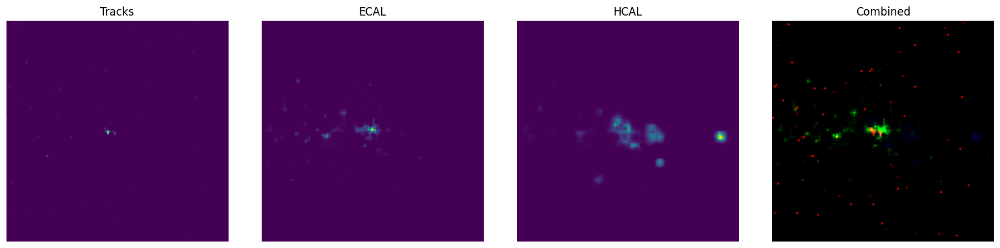

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


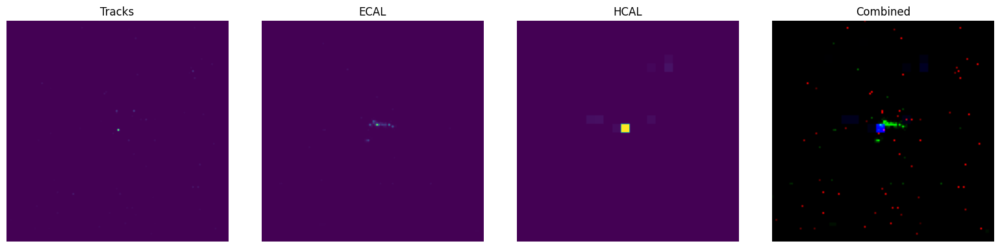

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


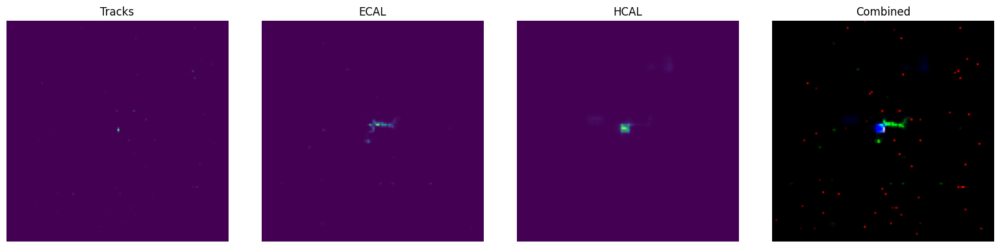

epoch: 96


100%|█████████████████████████████████████████| 625/625 [06:41<00:00,  1.56it/s]


train_loss: 0.00012838184607680888
epoch: 97


100%|█████████████████████████████████████████| 625/625 [06:42<00:00,  1.55it/s]


train_loss: 0.00012829383821226658
epoch: 98


100%|█████████████████████████████████████████| 625/625 [06:43<00:00,  1.55it/s]


train_loss: 0.00012820853888988496
epoch: 99


100%|█████████████████████████████████████████| 625/625 [06:44<00:00,  1.54it/s]


train_loss: 0.0001281284609809518
epoch: 100


100%|█████████████████████████████████████████| 625/625 [06:44<00:00,  1.55it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.00012804149712901562
Sample #0


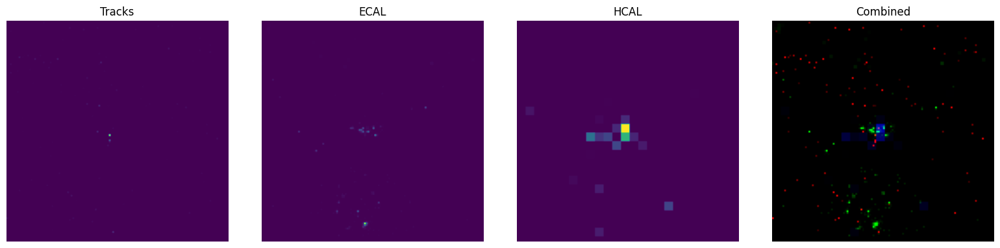

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


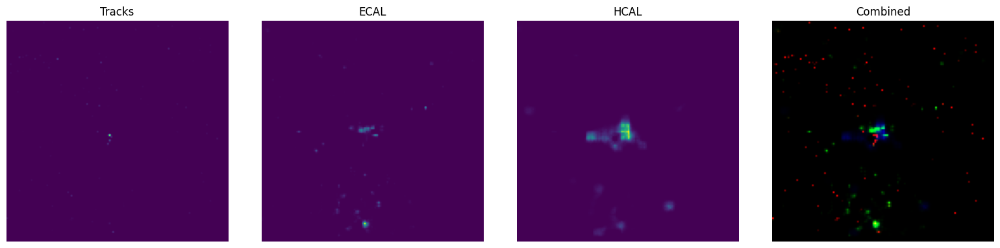

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


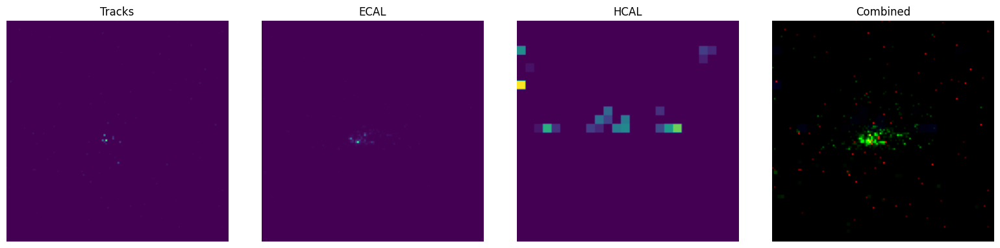

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


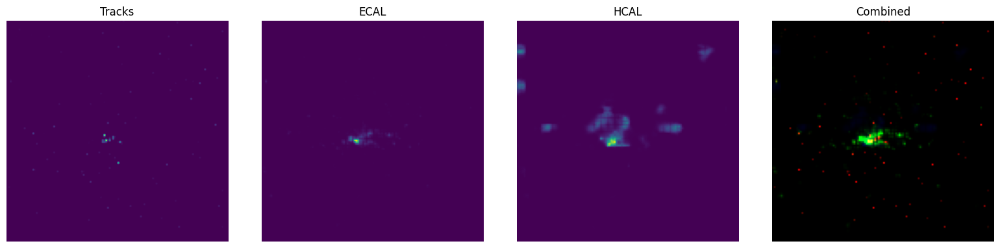

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


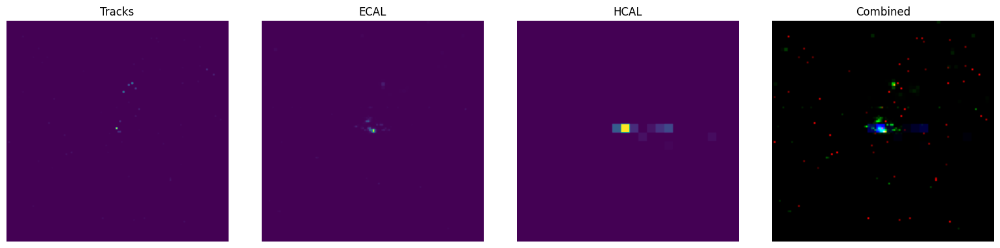

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


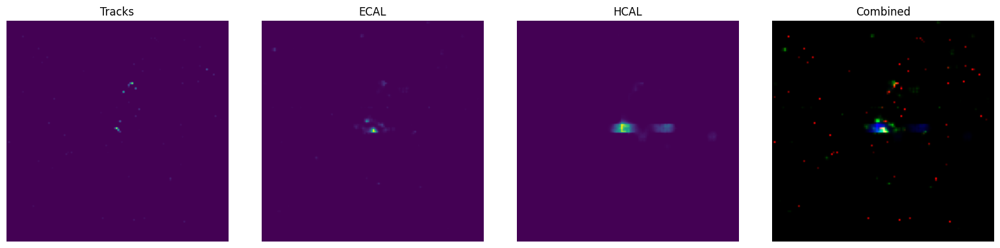

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


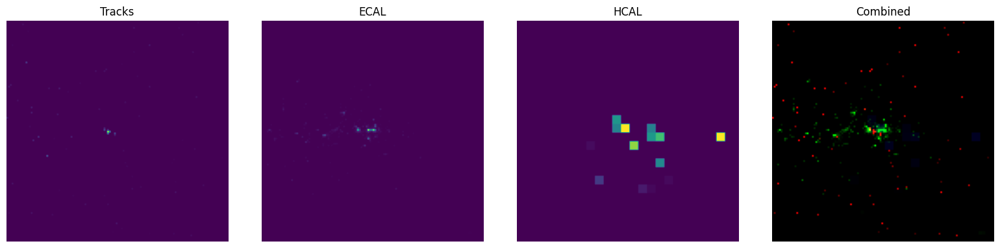

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


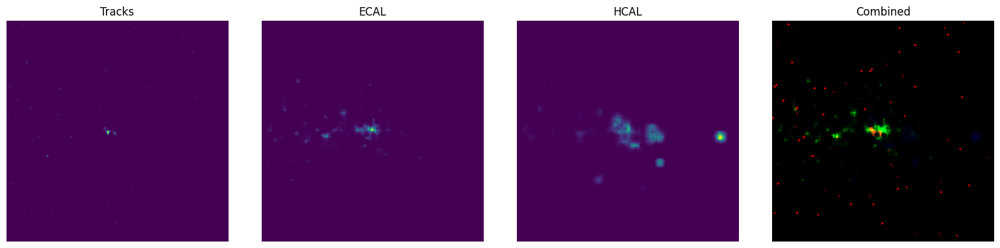

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


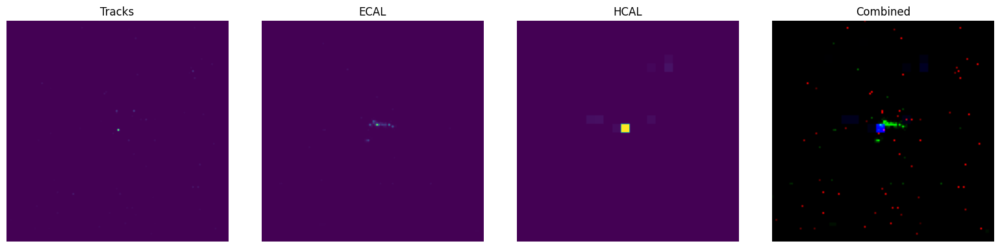

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


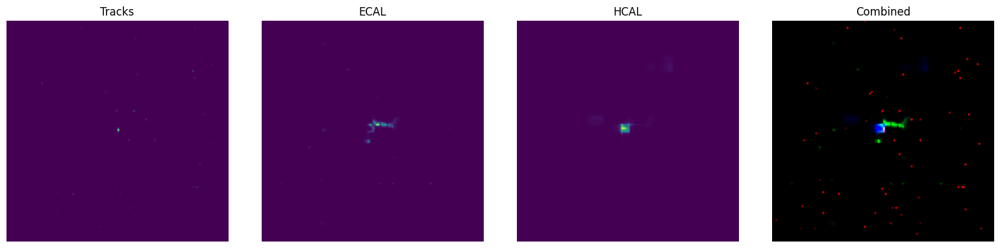

epoch: 101


100%|█████████████████████████████████████████| 625/625 [06:44<00:00,  1.55it/s]


train_loss: 0.00012795251349452882
epoch: 102


100%|█████████████████████████████████████████| 625/625 [06:44<00:00,  1.55it/s]


train_loss: 0.00012787473250646145
epoch: 103


100%|█████████████████████████████████████████| 625/625 [06:45<00:00,  1.54it/s]


train_loss: 0.00012779943109489977
epoch: 104


100%|█████████████████████████████████████████| 625/625 [06:46<00:00,  1.54it/s]


train_loss: 0.00012771931141614915
epoch: 105


100%|█████████████████████████████████████████| 625/625 [06:45<00:00,  1.54it/s]


train_loss: 0.00012764384443871677
Sample #0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


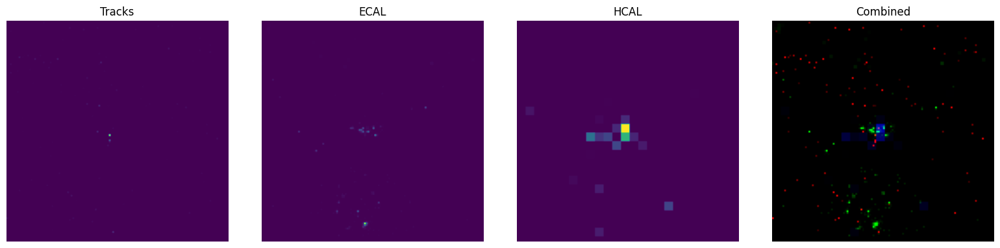

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


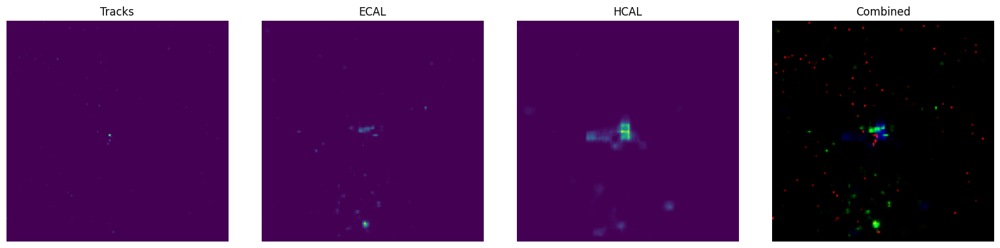

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


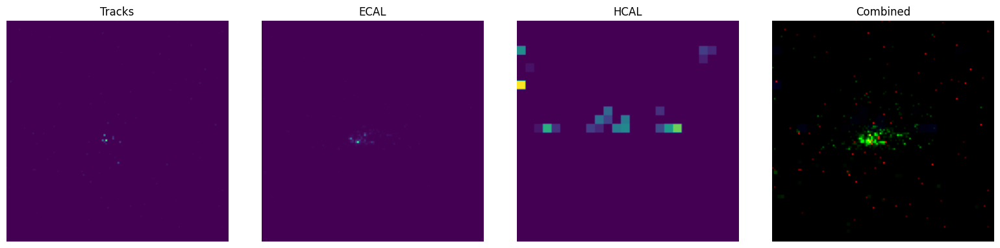

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


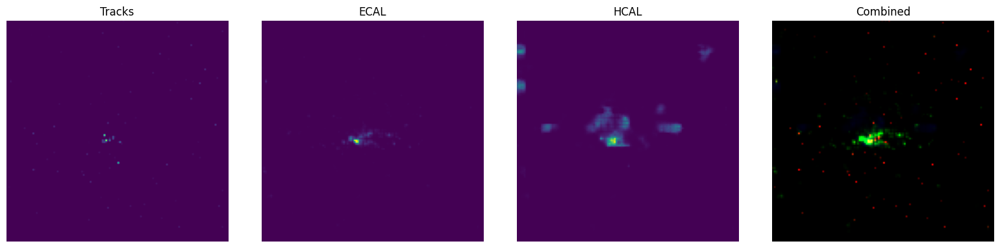

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


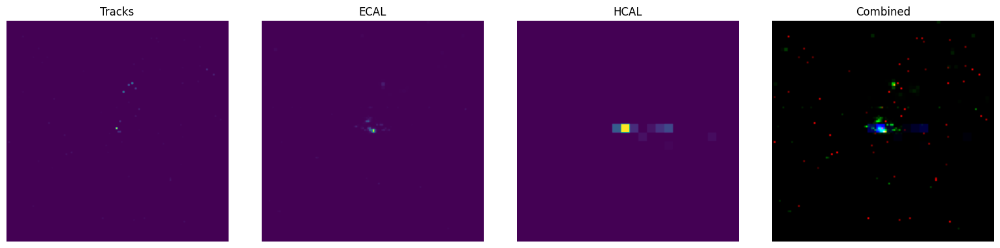

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


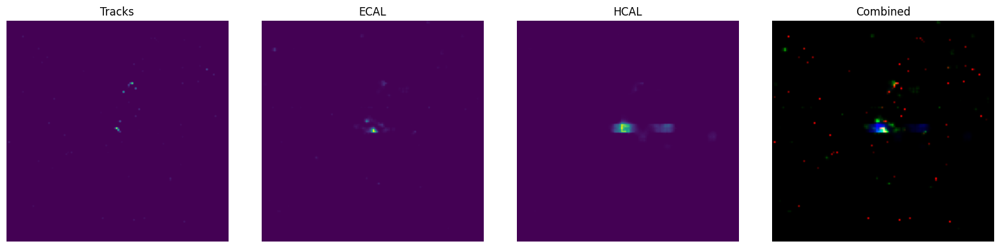

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


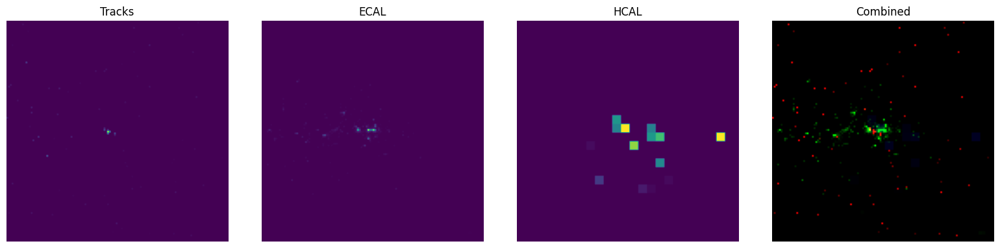

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


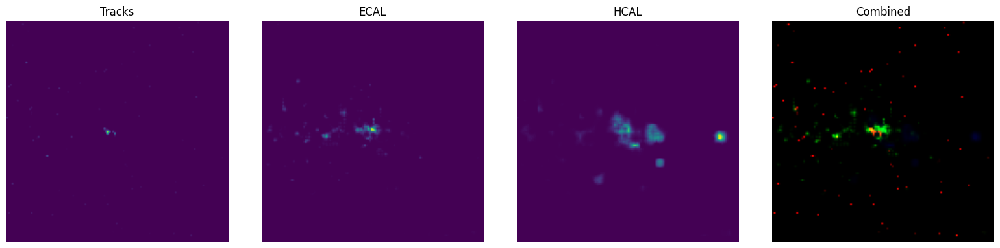

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


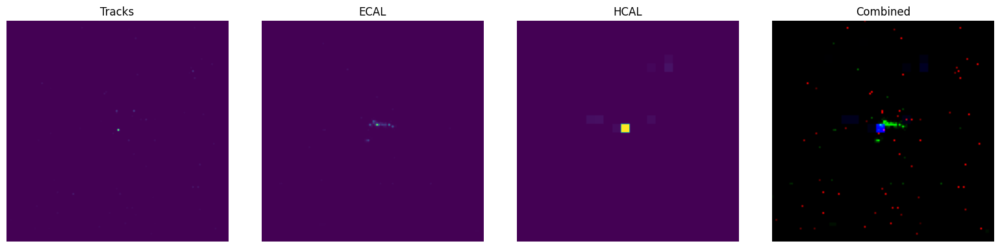

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


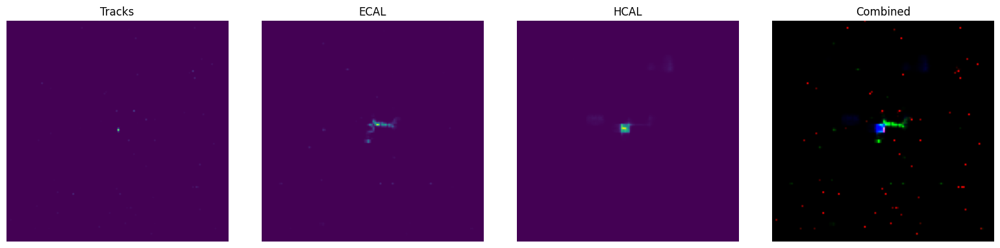

epoch: 106


100%|█████████████████████████████████████████| 625/625 [06:46<00:00,  1.54it/s]


train_loss: 0.0001275653845164925
epoch: 107


100%|█████████████████████████████████████████| 625/625 [06:47<00:00,  1.53it/s]


train_loss: 0.00012749293289380148
epoch: 108


100%|█████████████████████████████████████████| 625/625 [06:47<00:00,  1.53it/s]


train_loss: 0.00012741822481621056
epoch: 109


100%|█████████████████████████████████████████| 625/625 [06:47<00:00,  1.53it/s]


train_loss: 0.00012734024793608115
epoch: 110


100%|█████████████████████████████████████████| 625/625 [06:48<00:00,  1.53it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.00012726632637204602
Sample #0


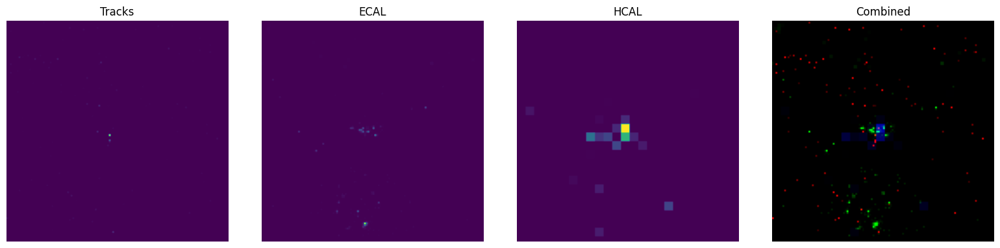

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


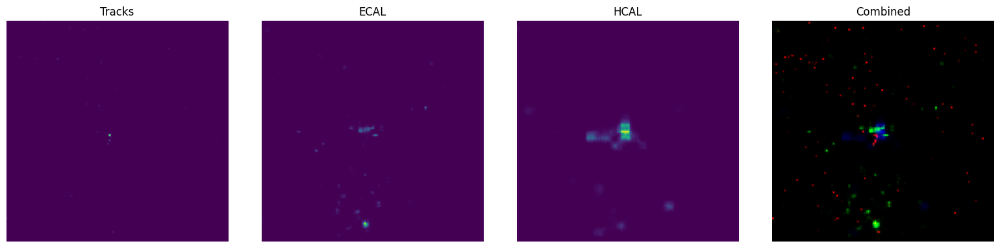

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


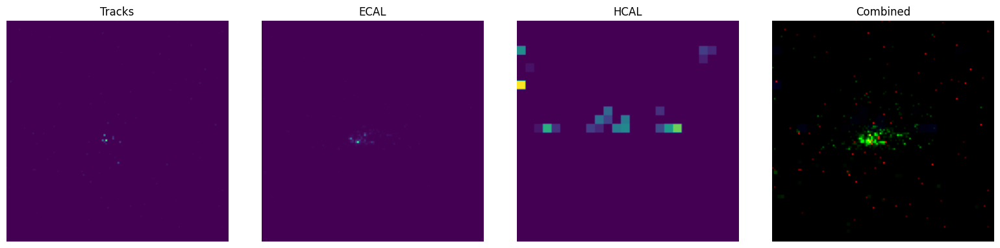

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


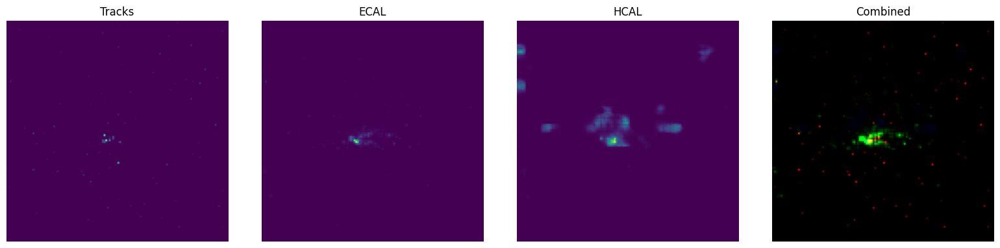

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


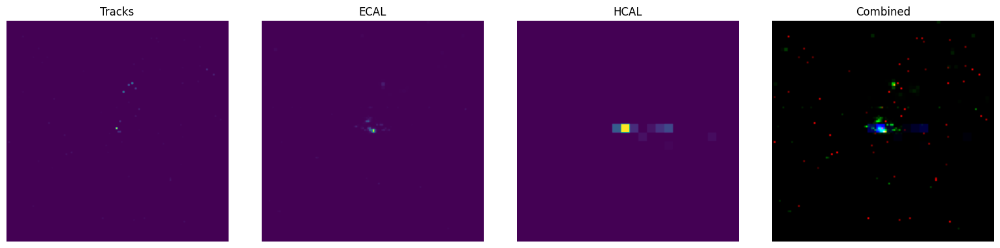

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


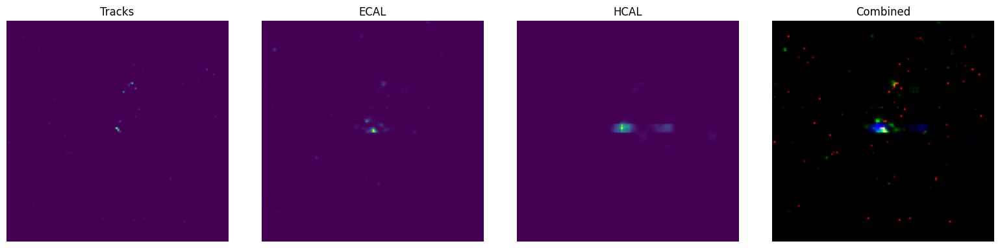

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


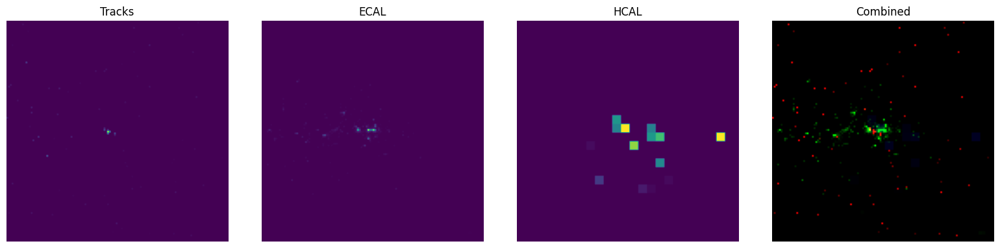

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


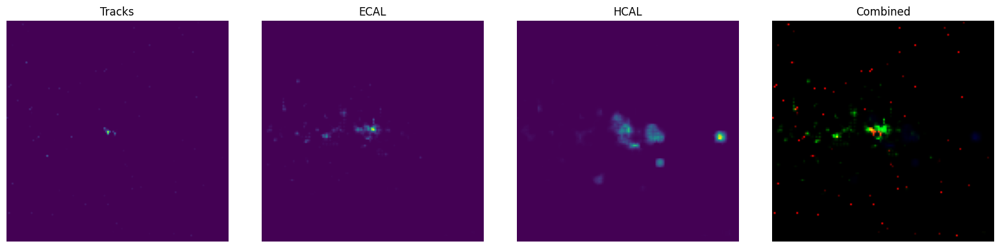

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


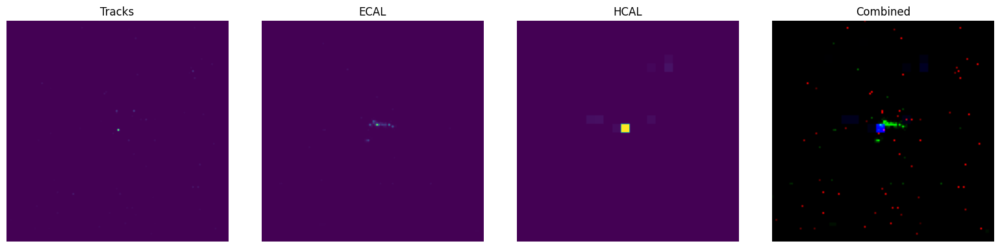

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


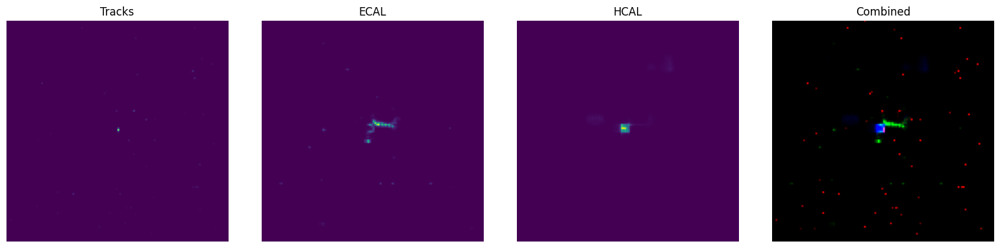

epoch: 111


100%|█████████████████████████████████████████| 625/625 [06:48<00:00,  1.53it/s]


train_loss: 0.0001271899746498093
epoch: 112


100%|█████████████████████████████████████████| 625/625 [06:48<00:00,  1.53it/s]


train_loss: 0.00012711485363543033
epoch: 113


100%|█████████████████████████████████████████| 625/625 [06:48<00:00,  1.53it/s]


train_loss: 0.00012704431193415075
epoch: 114


100%|█████████████████████████████████████████| 625/625 [06:49<00:00,  1.53it/s]


train_loss: 0.00012696932691615075
epoch: 115


100%|█████████████████████████████████████████| 625/625 [06:49<00:00,  1.52it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.0001269015529192984
Sample #0


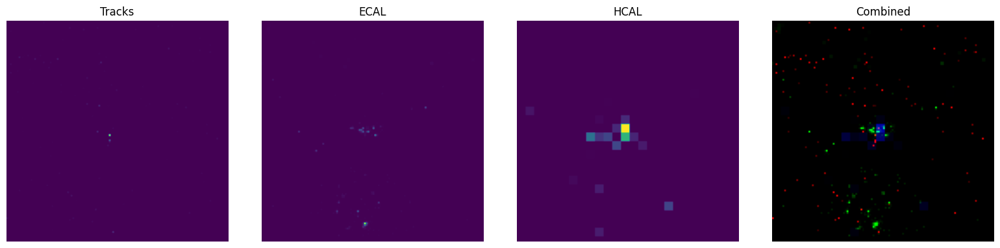

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


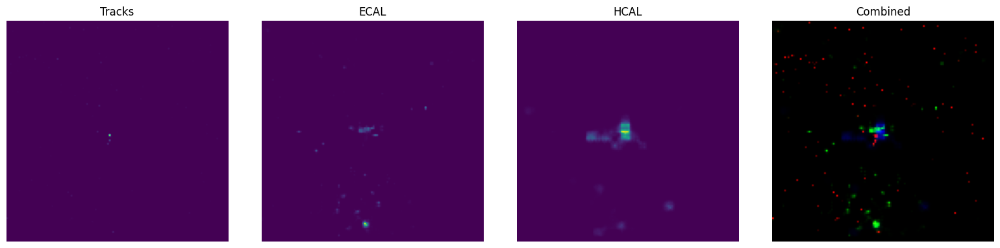

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


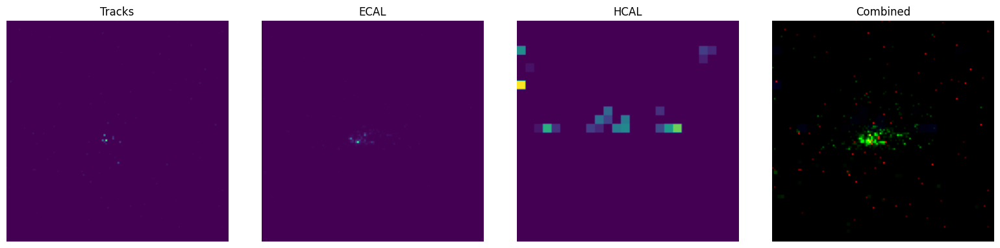

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


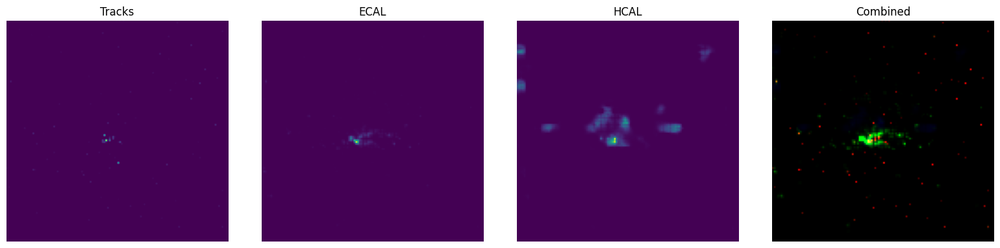

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


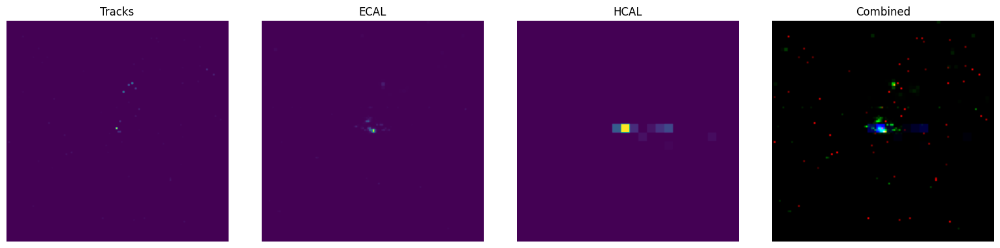

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


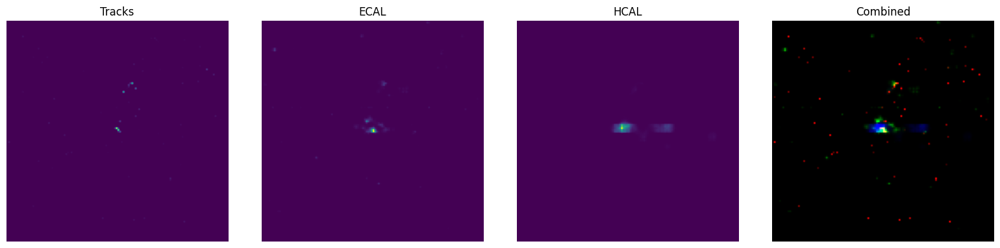

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


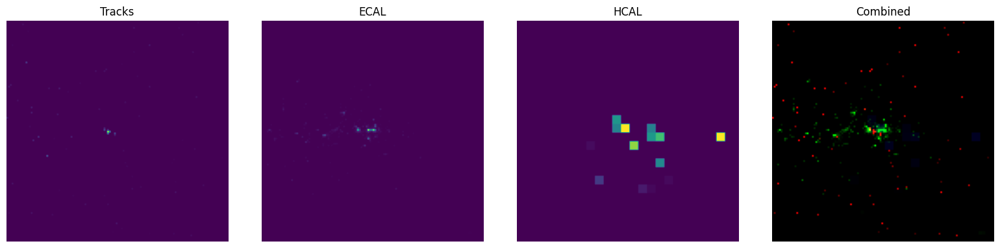

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


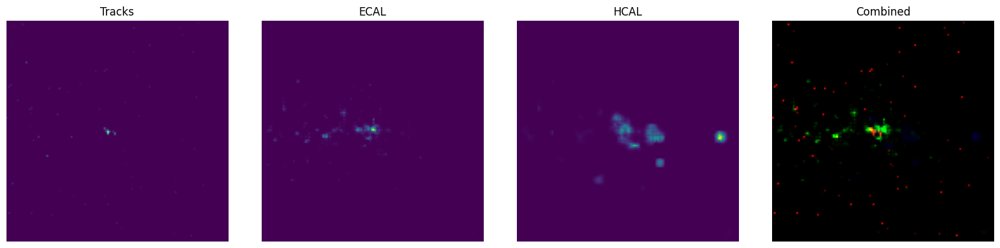

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


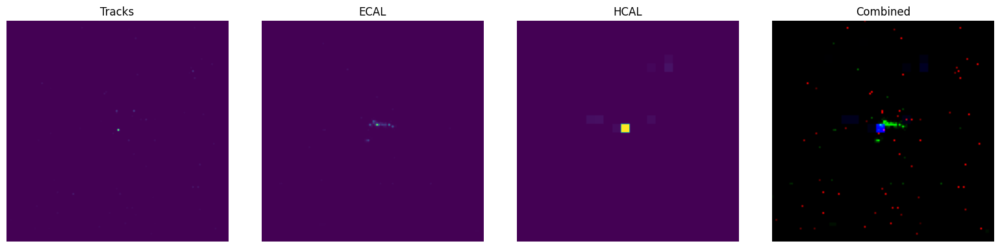

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


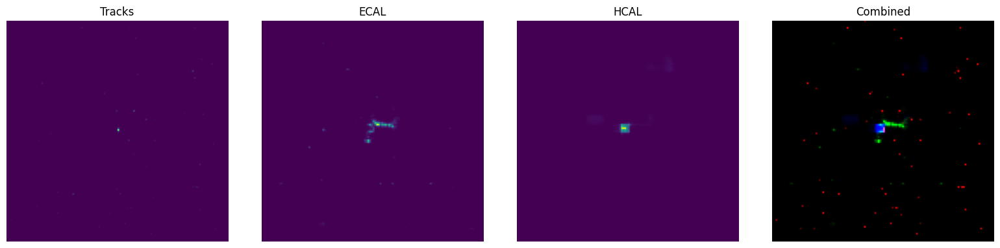

epoch: 116


100%|█████████████████████████████████████████| 625/625 [06:49<00:00,  1.53it/s]


train_loss: 0.00012682713947724552
epoch: 117


100%|█████████████████████████████████████████| 625/625 [06:50<00:00,  1.52it/s]


train_loss: 0.00012675785332685337
epoch: 118


100%|█████████████████████████████████████████| 625/625 [06:50<00:00,  1.52it/s]


train_loss: 0.00012669221457326784
epoch: 119


100%|█████████████████████████████████████████| 625/625 [06:50<00:00,  1.52it/s]


train_loss: 0.00012662653386360034
epoch: 120


100%|█████████████████████████████████████████| 625/625 [06:49<00:00,  1.52it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.00012655599131248892
Sample #0


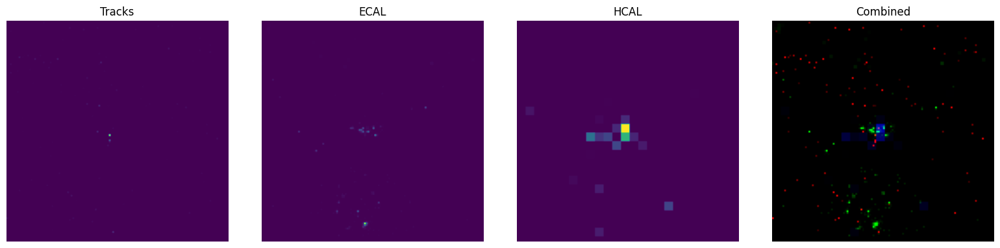

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


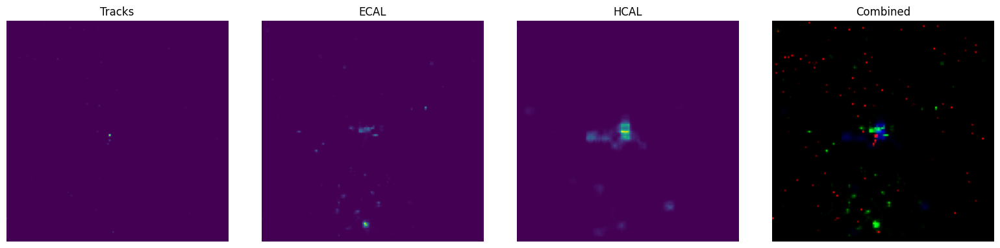

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


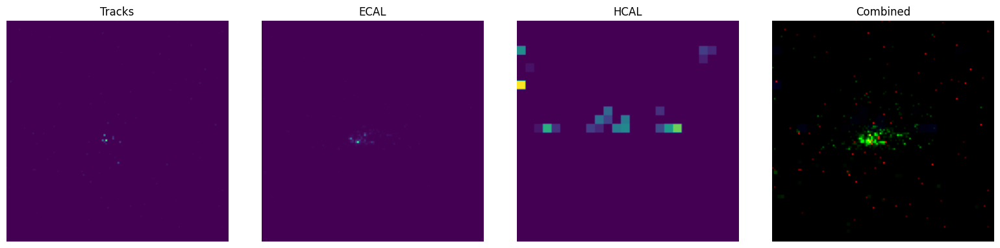

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


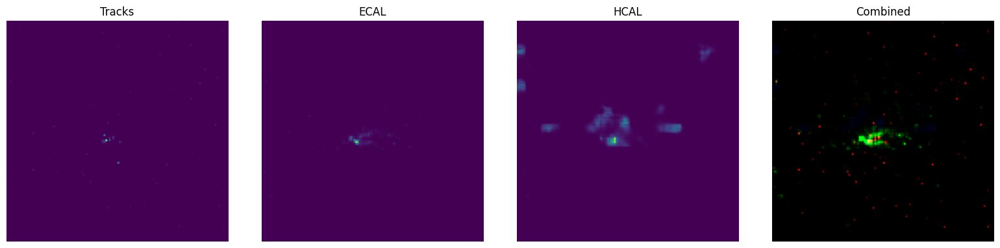

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


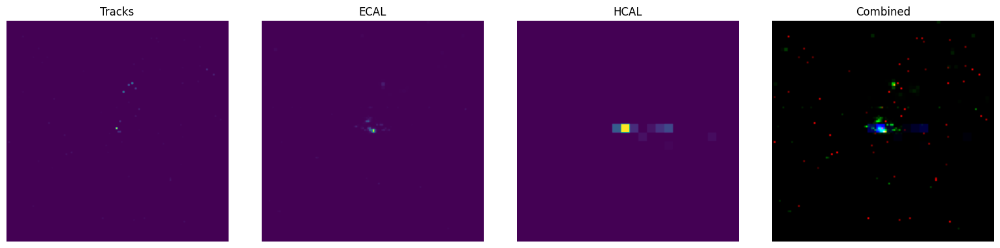

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


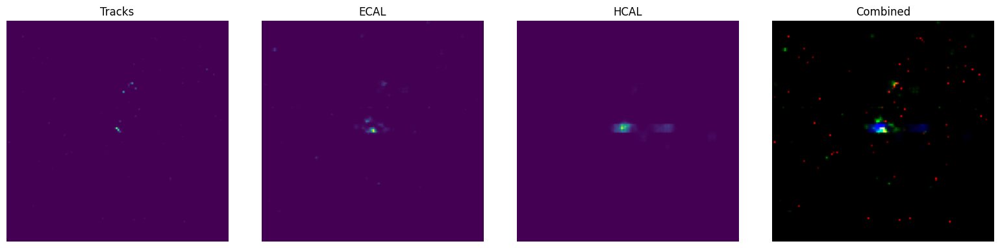

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


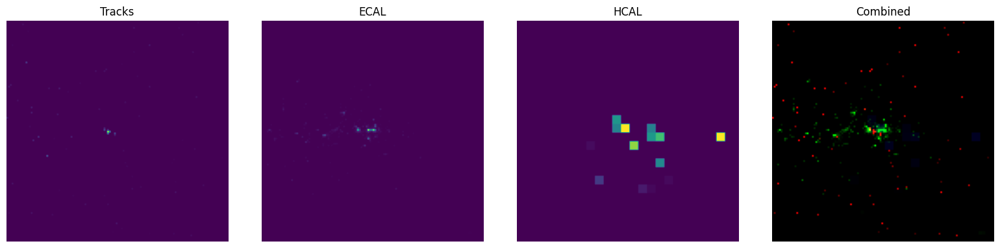

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


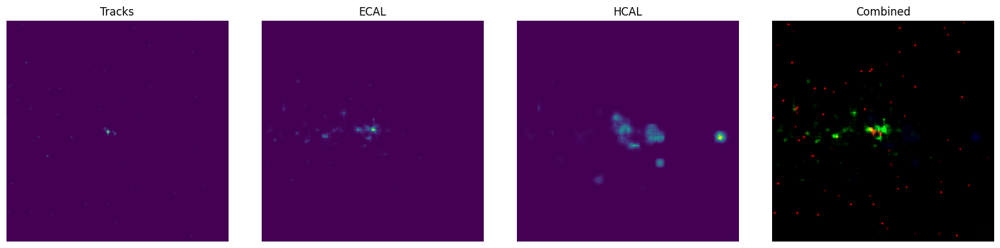

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


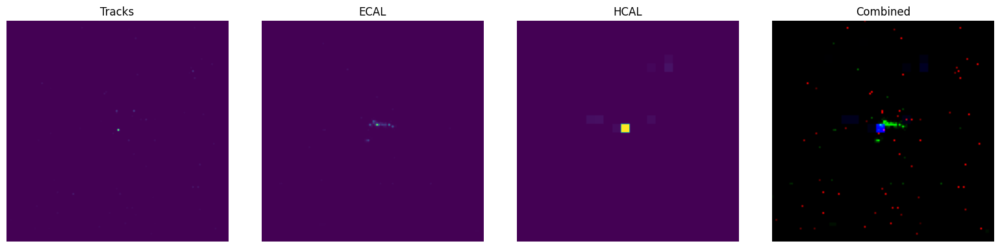

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


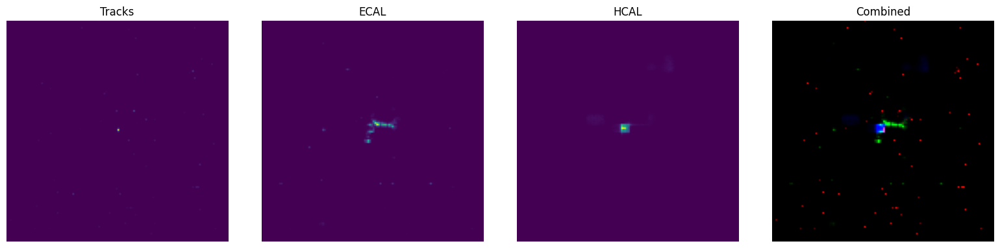

epoch: 121


100%|█████████████████████████████████████████| 625/625 [06:50<00:00,  1.52it/s]


train_loss: 0.00012649261542828754
epoch: 122


100%|█████████████████████████████████████████| 625/625 [06:50<00:00,  1.52it/s]


train_loss: 0.00012642741791205482
epoch: 123


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]


train_loss: 0.0001263643459416926
epoch: 124


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]


train_loss: 0.000126298942649737
epoch: 125


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.00012623457186855376
Sample #0


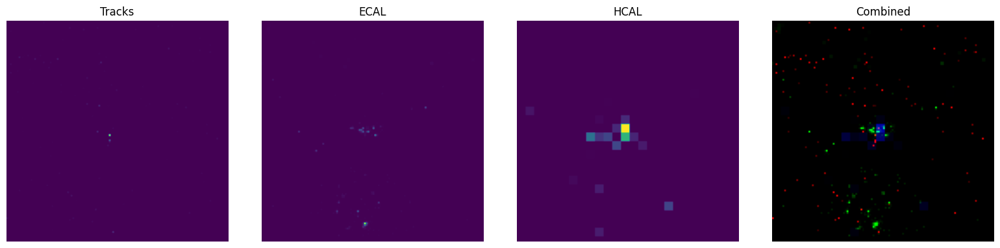

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


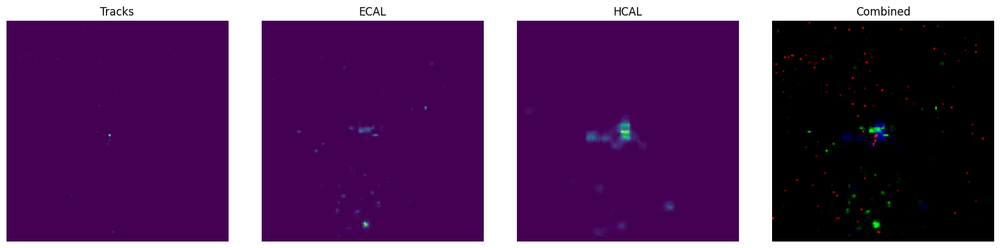

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


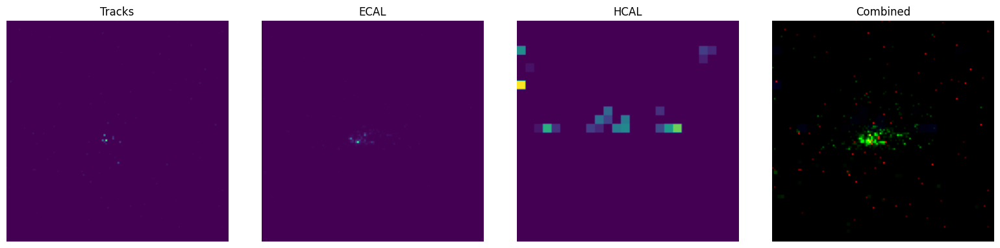

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


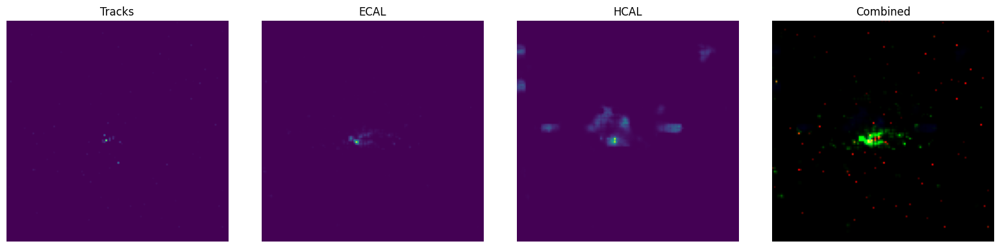

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


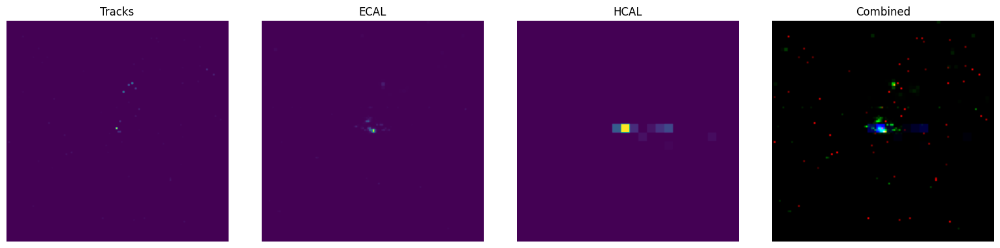

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


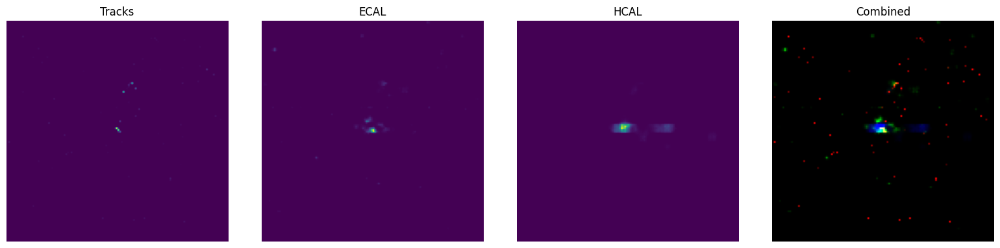

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


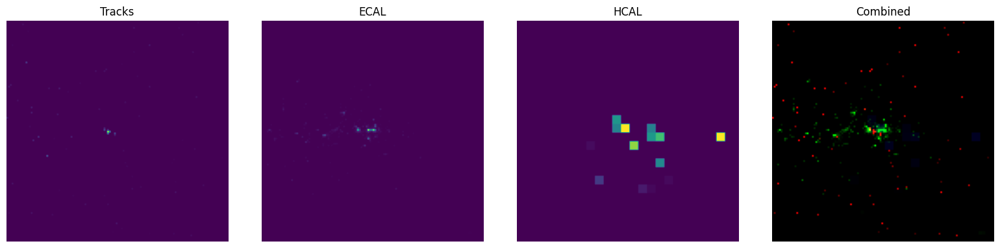

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


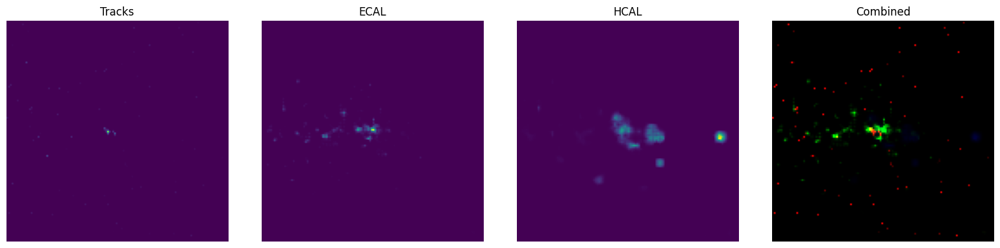

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


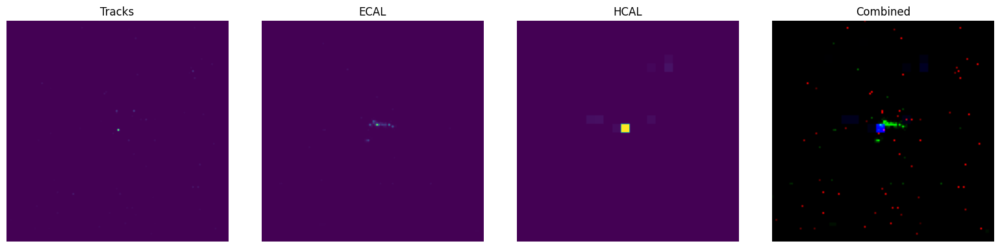

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


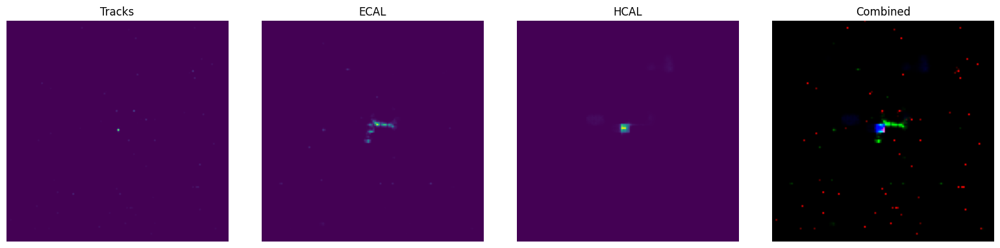

epoch: 126


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]


train_loss: 0.00012616872432408854
epoch: 127


100%|█████████████████████████████████████████| 625/625 [06:53<00:00,  1.51it/s]


train_loss: 0.00012611358142457902
epoch: 128


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]


train_loss: 0.00012604673227760942
epoch: 129


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]


train_loss: 0.00012599216741509737
epoch: 130


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.00012593590904725715
Sample #0


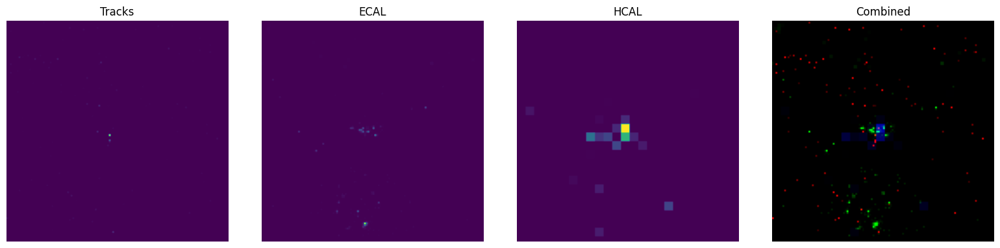

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


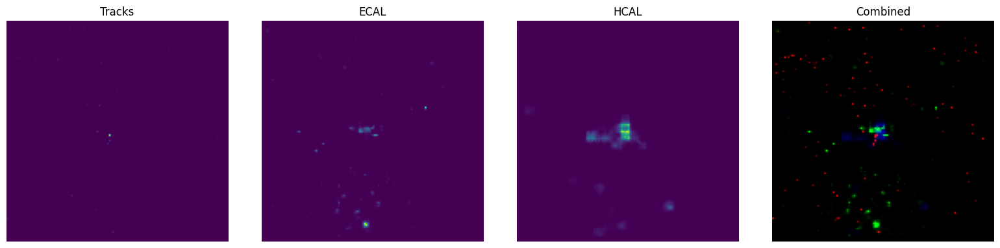

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


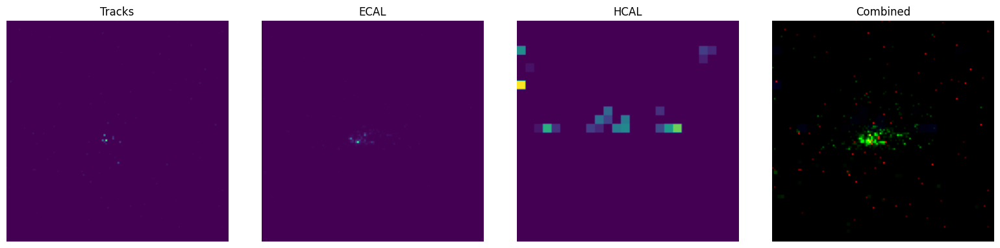

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


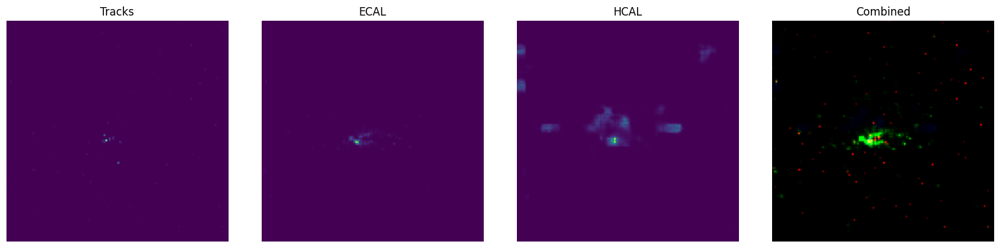

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


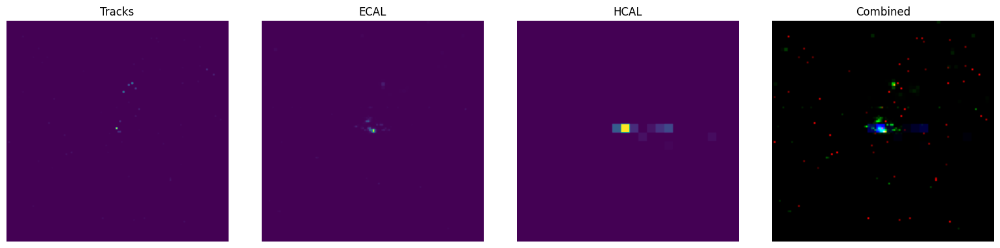

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


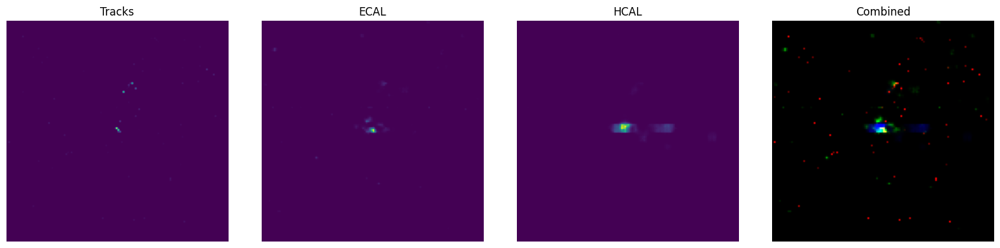

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


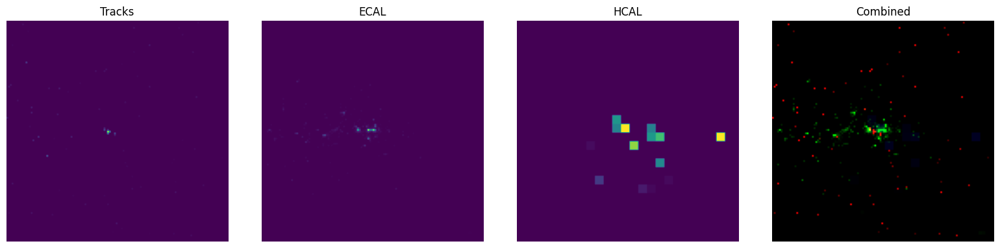

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


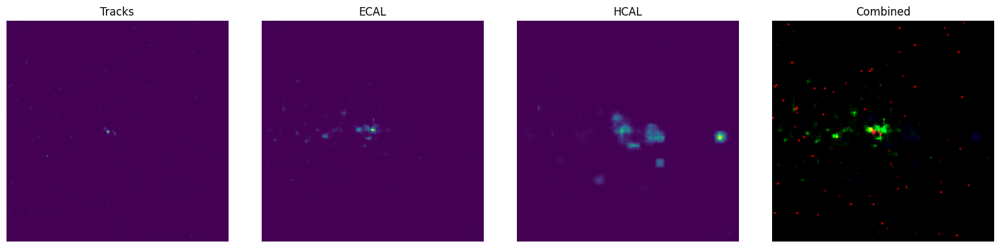

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


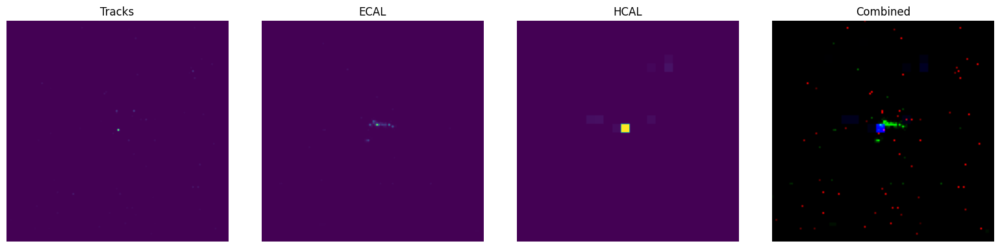

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


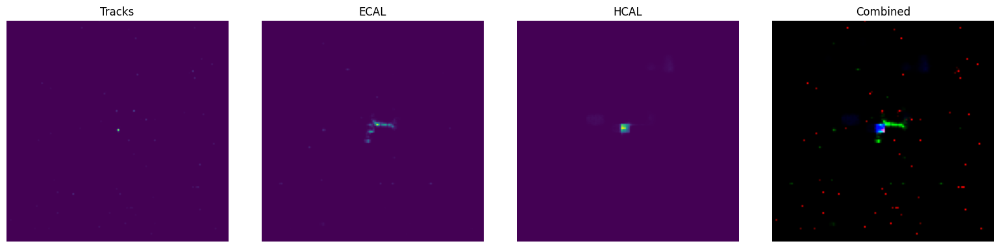

epoch: 131


100%|█████████████████████████████████████████| 625/625 [06:52<00:00,  1.51it/s]


train_loss: 0.00012588870807085187
epoch: 132


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]


train_loss: 0.00012582919966662302
epoch: 133


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]


train_loss: 0.00012578712648246437
epoch: 134


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]


train_loss: 0.00012572794338921084
epoch: 135


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.0001256884815520607
Sample #0


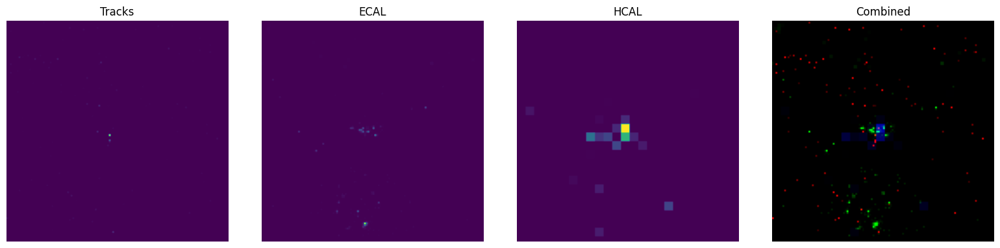

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


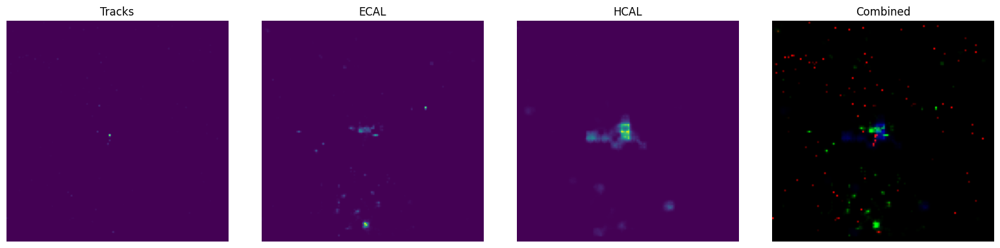

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


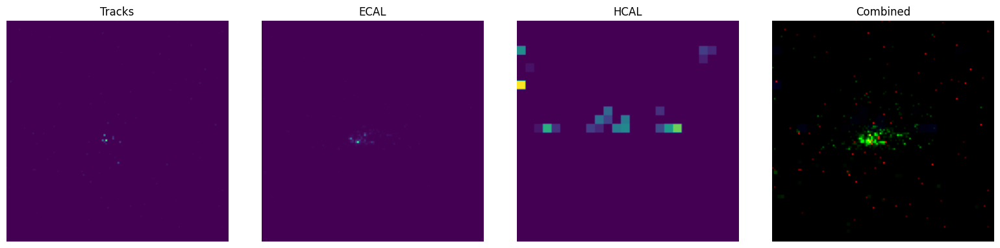

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


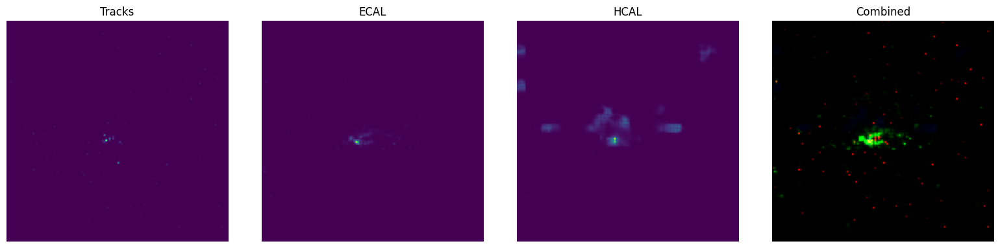

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


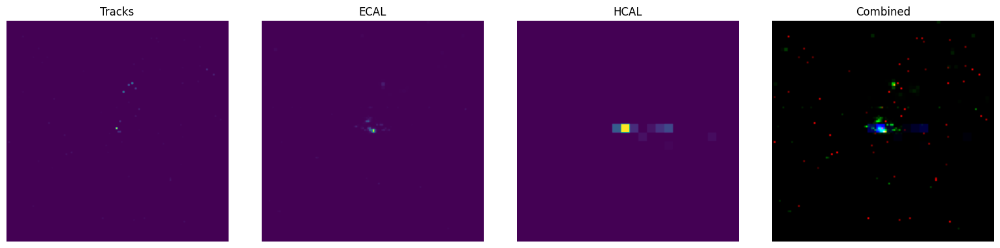

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


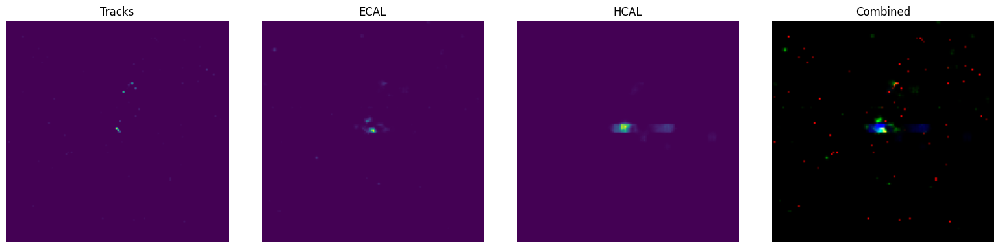

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


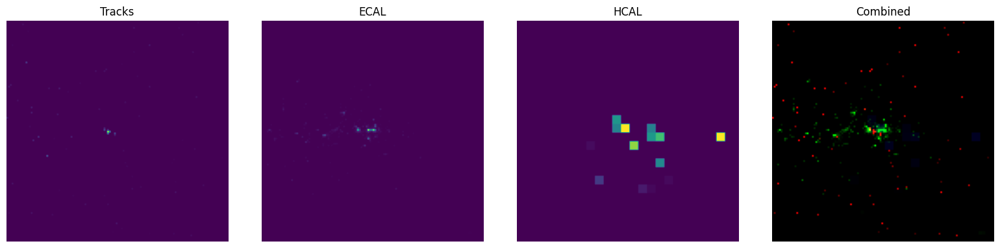

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


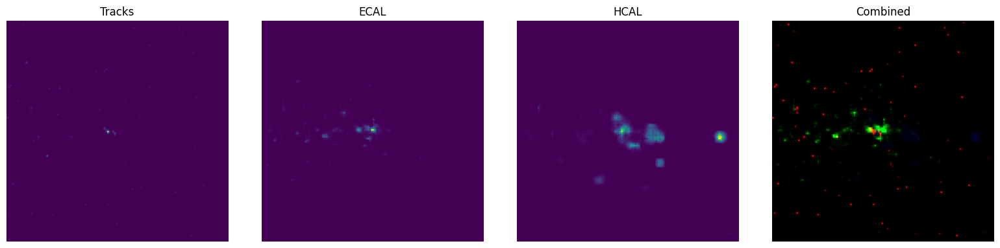

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


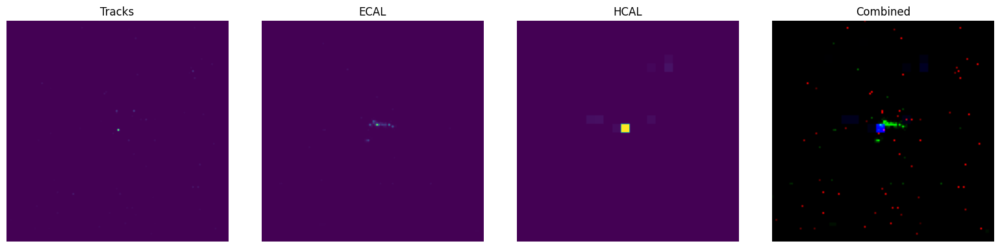

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


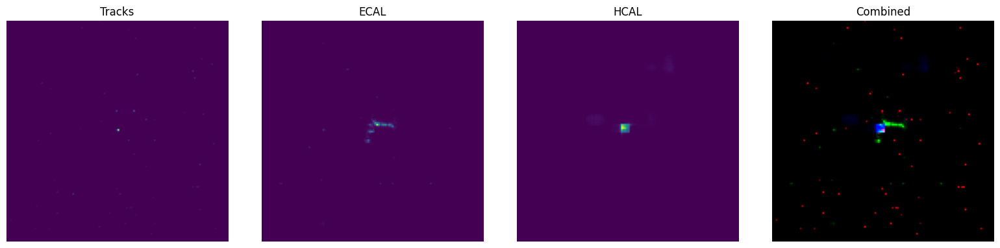

epoch: 136


100%|█████████████████████████████████████████| 625/625 [06:52<00:00,  1.52it/s]


train_loss: 0.00012564044079044833
epoch: 137


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]


train_loss: 0.00012559484964003785
epoch: 138


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]


train_loss: 0.0001255419890047051
epoch: 139


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]


train_loss: 0.00012550686995964499
epoch: 140


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]


train_loss: 0.0001254565436509438
Sample #0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


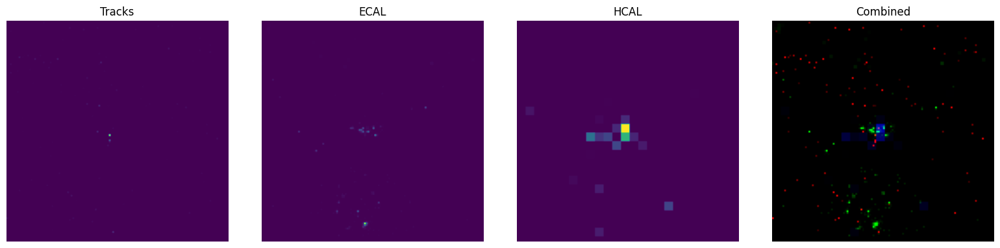

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


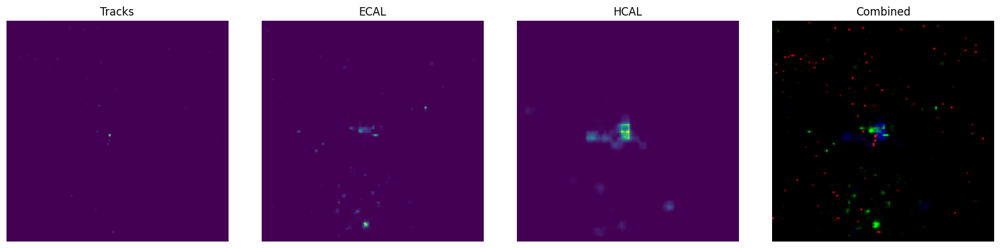

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


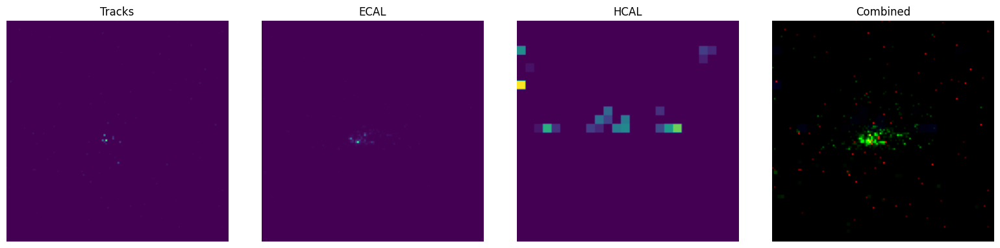

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


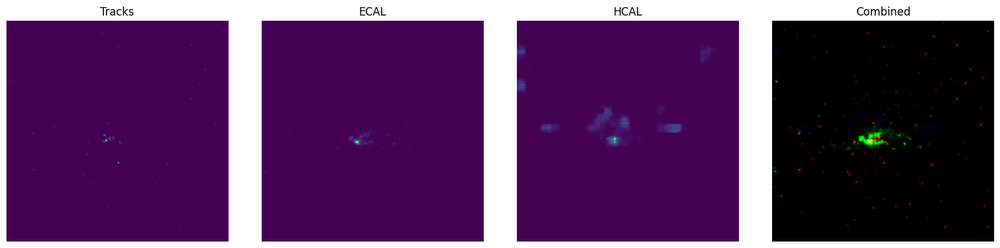

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


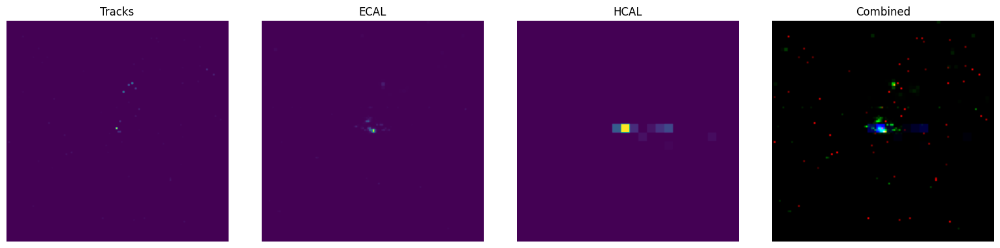

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


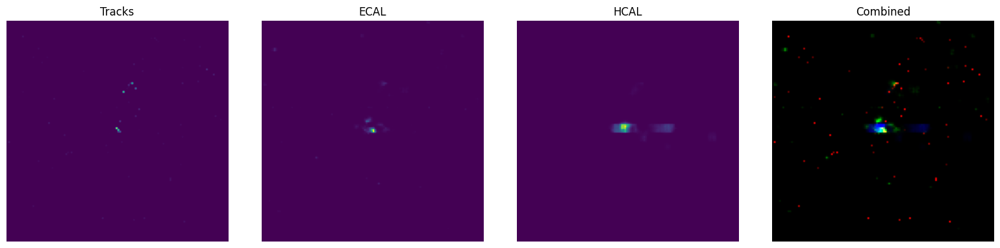

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


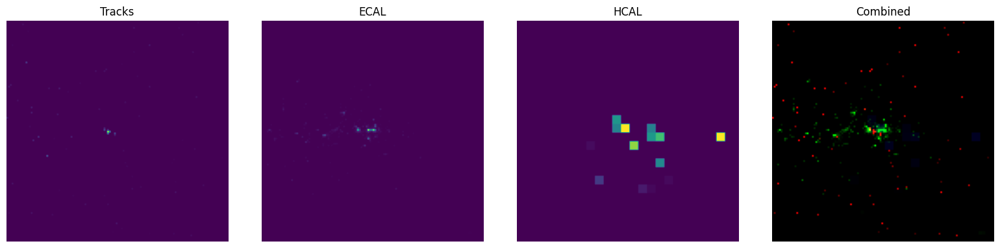

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


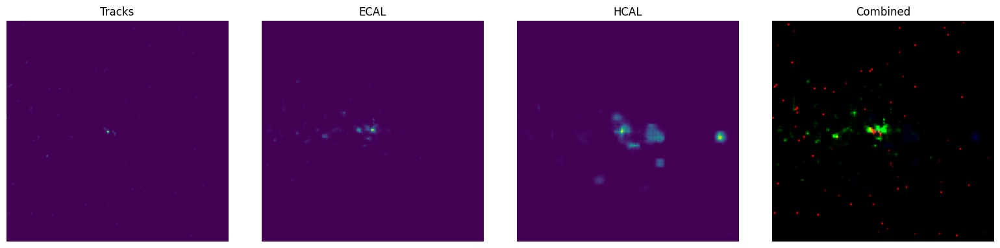

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


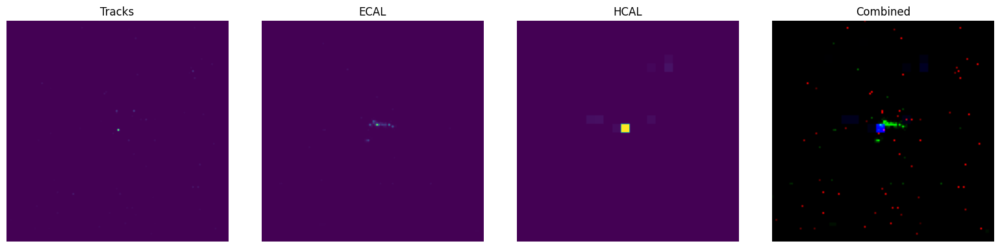

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


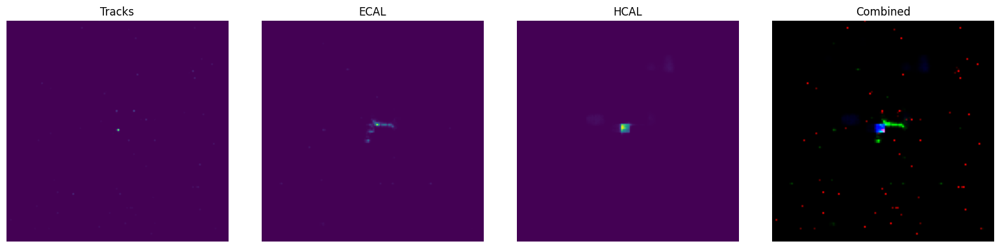

epoch: 141


100%|█████████████████████████████████████████| 625/625 [06:52<00:00,  1.52it/s]


train_loss: 0.00012541525962296874
epoch: 142


100%|█████████████████████████████████████████| 625/625 [06:52<00:00,  1.52it/s]


train_loss: 0.00012537644456606358
epoch: 143


100%|█████████████████████████████████████████| 625/625 [06:52<00:00,  1.52it/s]


train_loss: 0.00012533038412220775
epoch: 144


100%|█████████████████████████████████████████| 625/625 [06:52<00:00,  1.52it/s]


train_loss: 0.00012529567005112766
epoch: 145


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.0001252520273323171
Sample #0


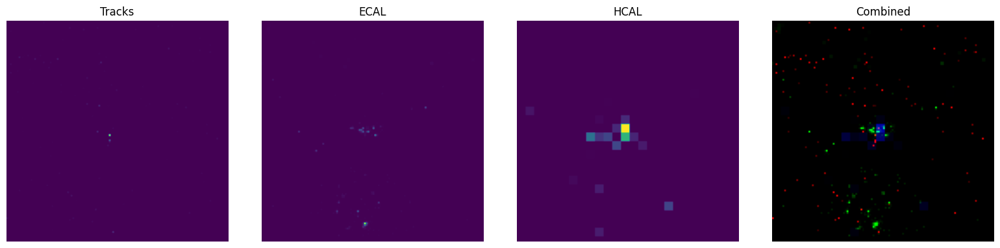

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


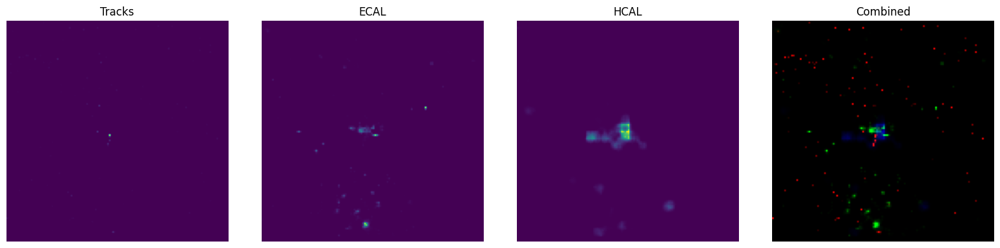

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


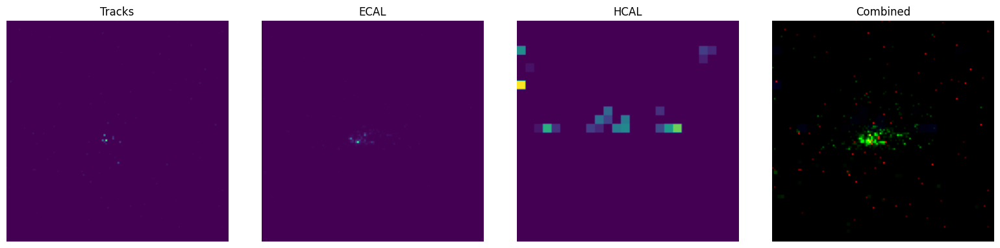

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


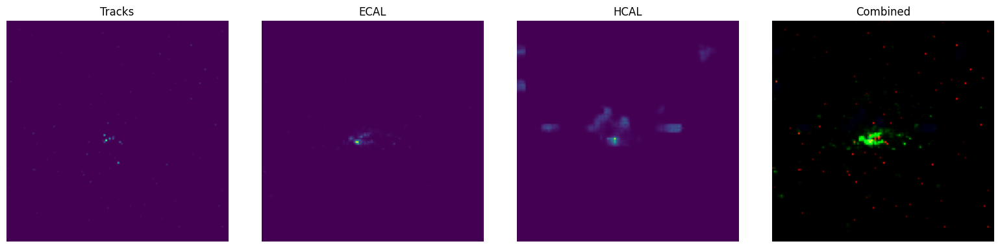

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


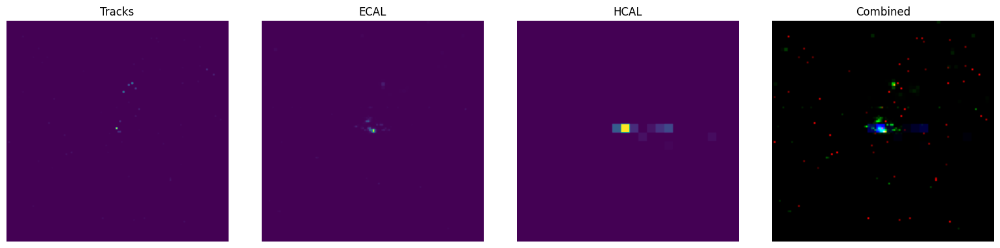

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


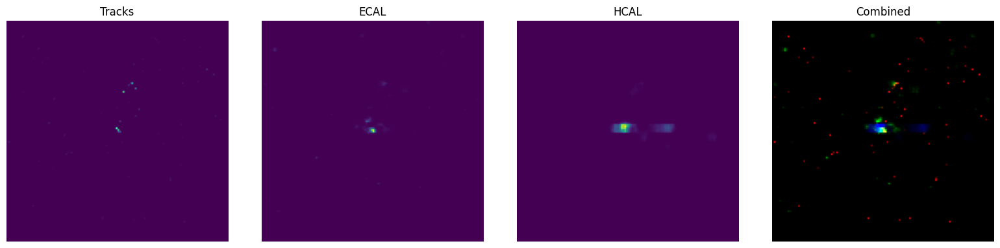

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


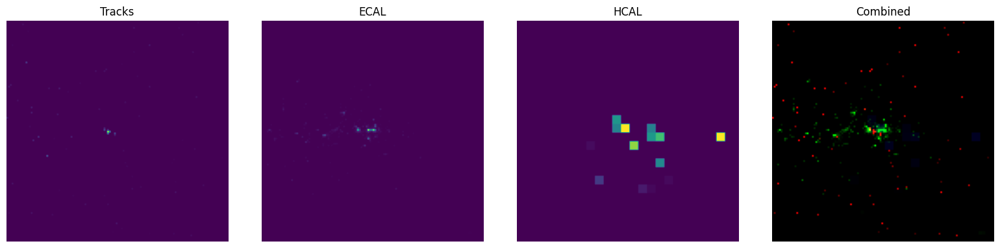

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


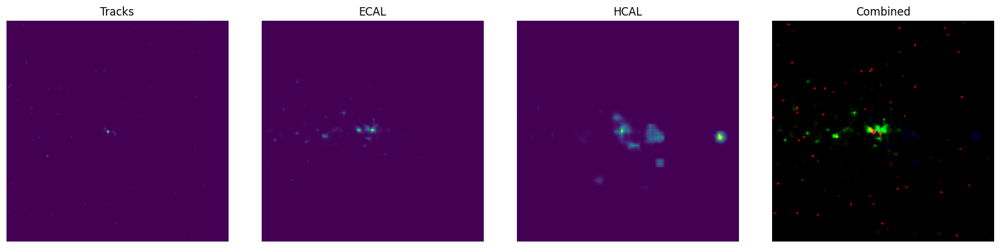

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


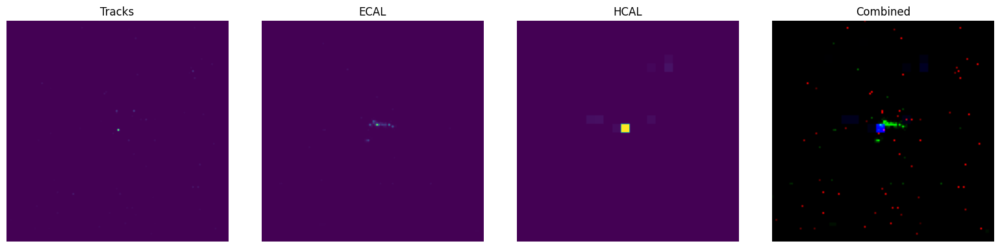

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


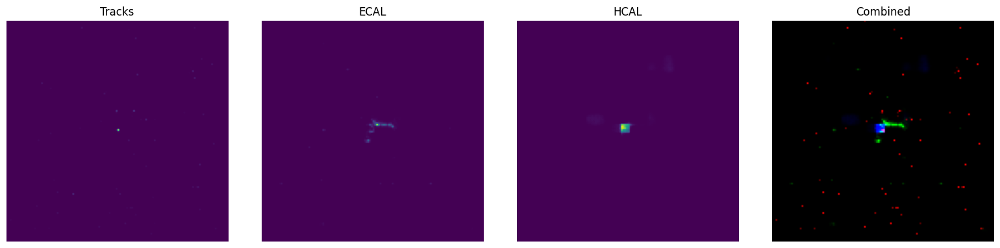

epoch: 146


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]


train_loss: 0.00012521007396280764
epoch: 147


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]


train_loss: 0.00012517337242607028
epoch: 148


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]


train_loss: 0.0001251317460904829
epoch: 149


100%|█████████████████████████████████████████| 625/625 [06:52<00:00,  1.52it/s]


train_loss: 0.0001250940791913308
epoch: 150


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.00012505916055524722
Sample #0


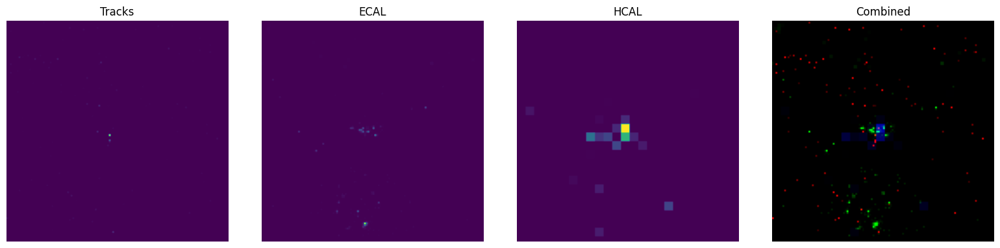

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


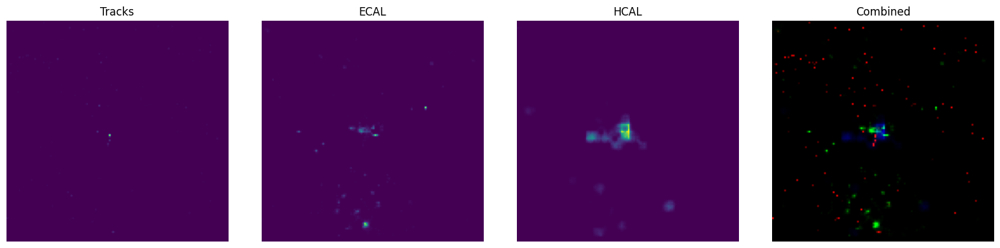

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


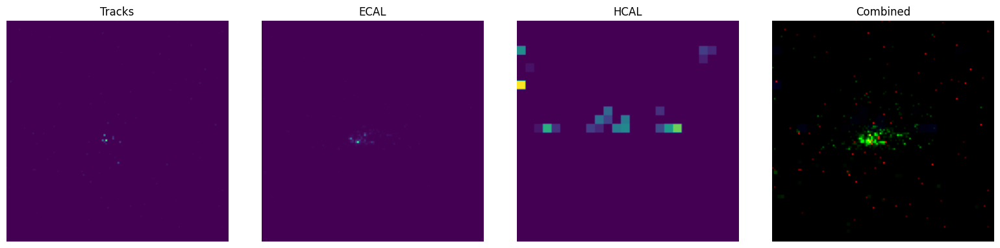

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


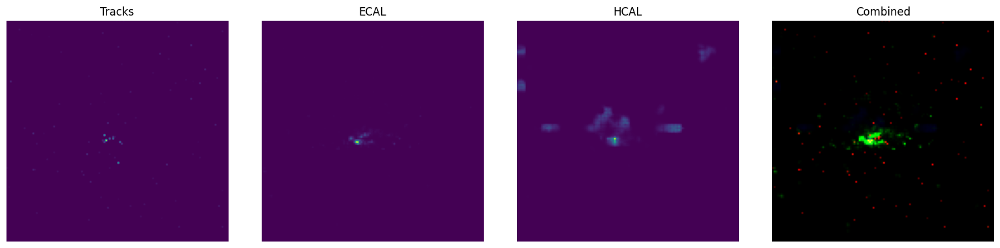

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


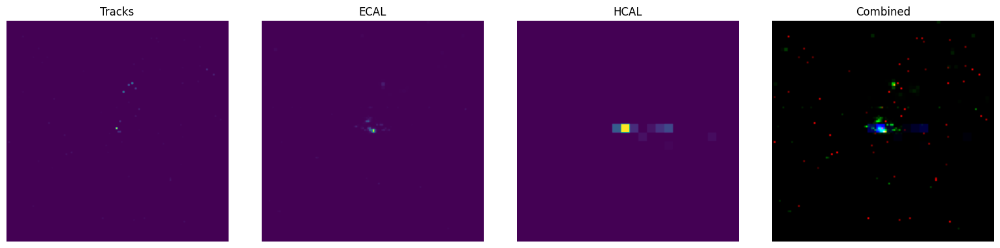

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


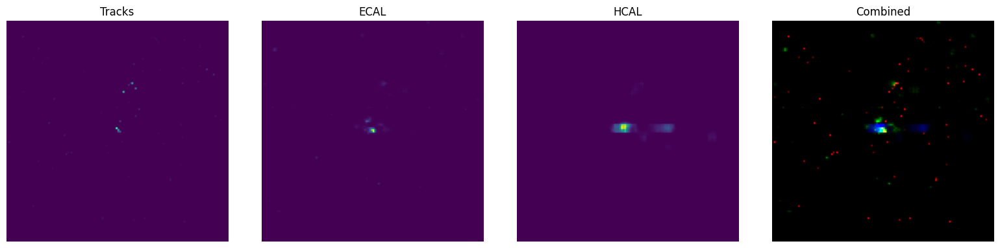

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


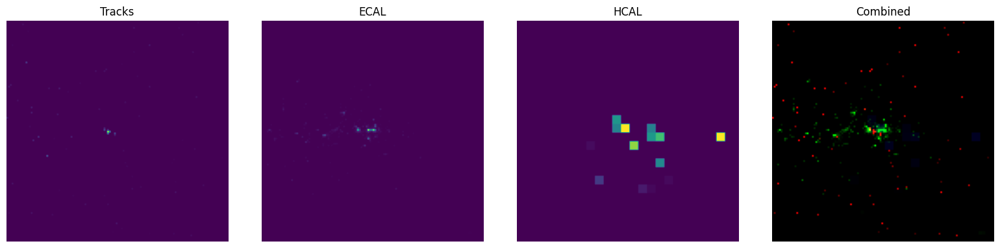

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


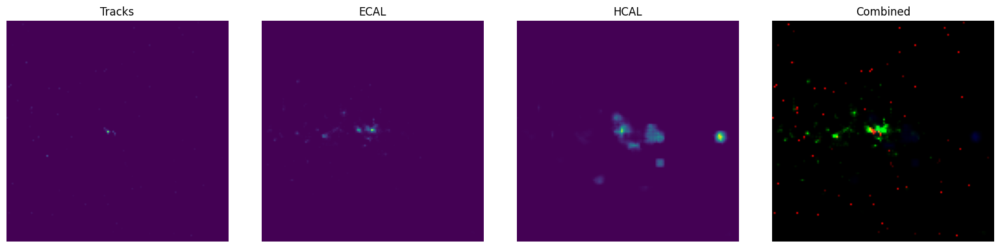

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


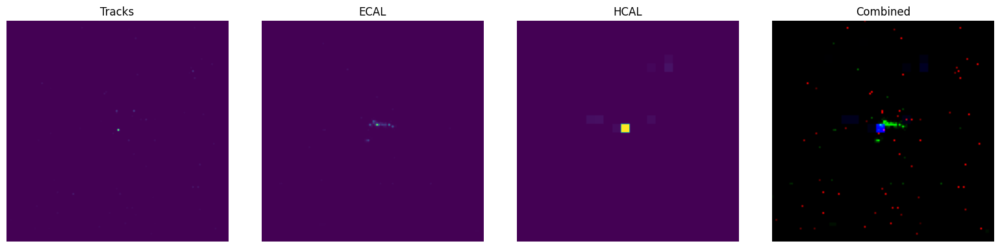

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


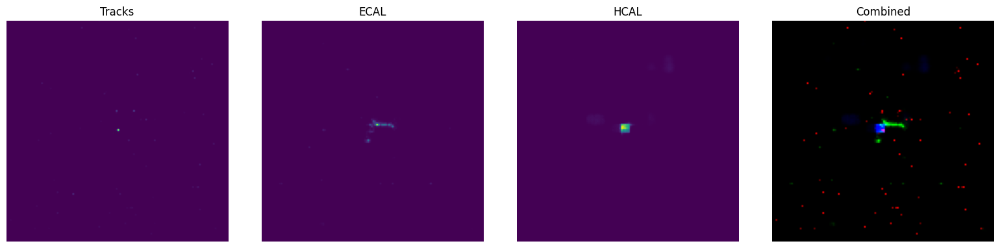

epoch: 151


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]


train_loss: 0.0001250208739307709
epoch: 152


100%|█████████████████████████████████████████| 625/625 [06:52<00:00,  1.52it/s]


train_loss: 0.0001249881497467868
epoch: 153


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]


train_loss: 0.00012494523805798964
epoch: 154


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]


train_loss: 0.00012491793398512527
epoch: 155


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.00012487932052463293
Sample #0


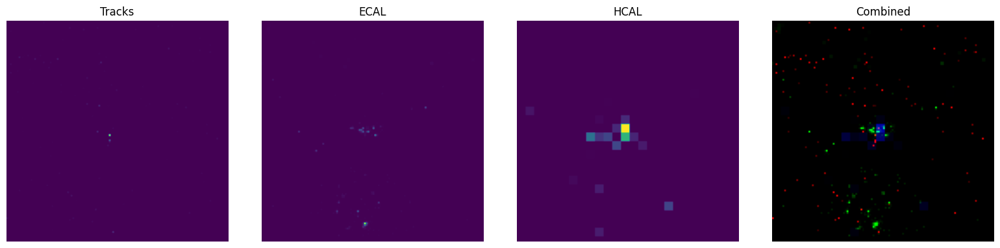

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


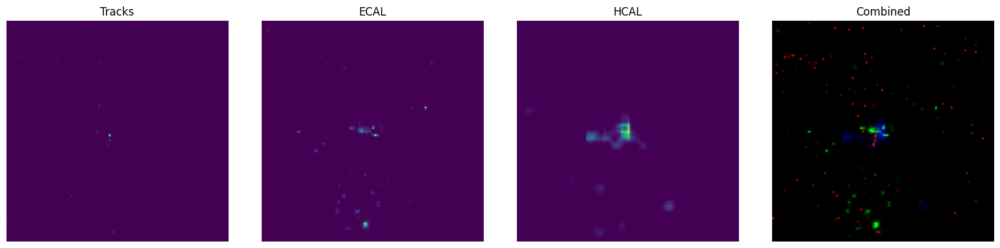

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


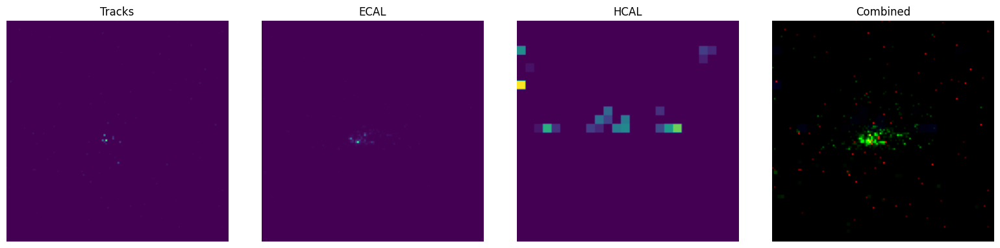

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


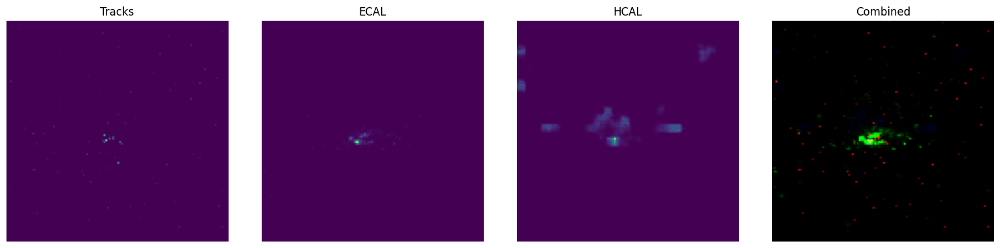

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


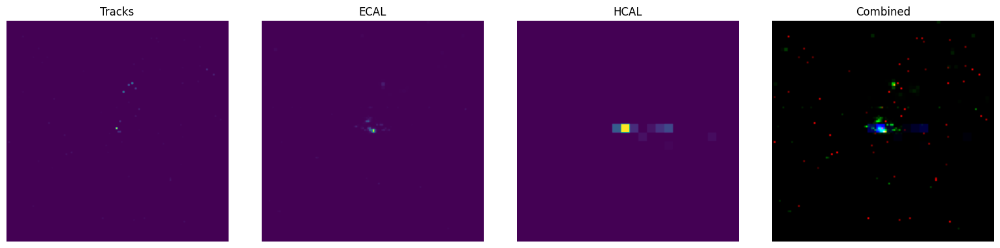

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


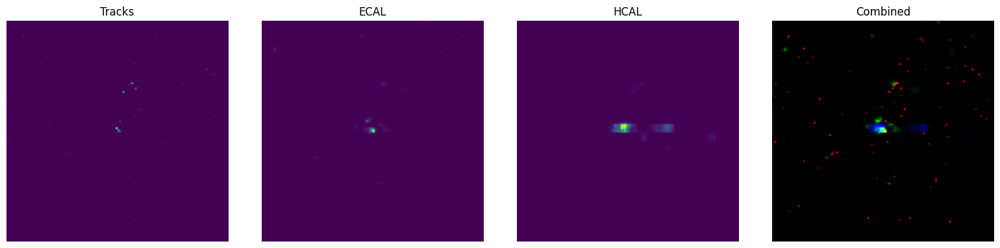

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


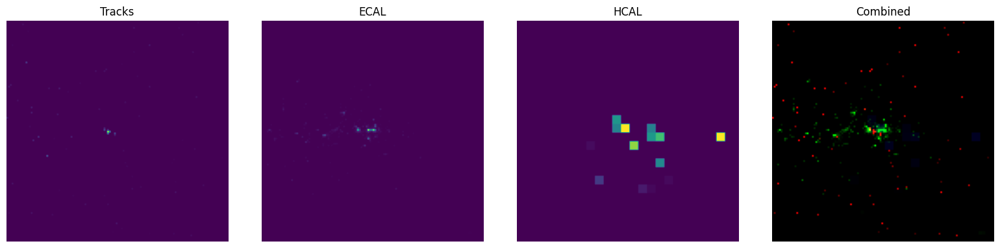

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


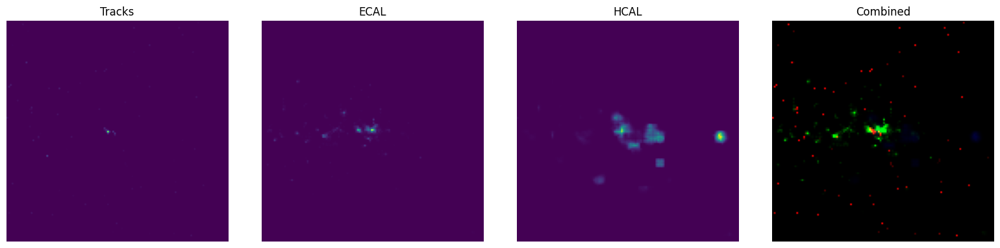

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


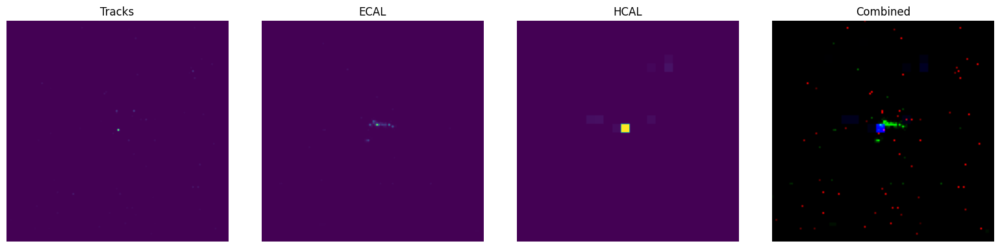

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


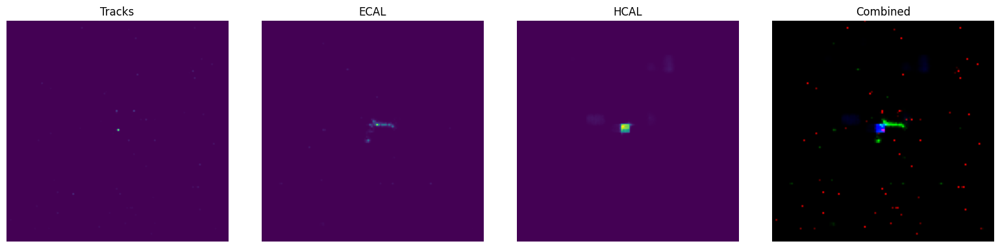

epoch: 156


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]


train_loss: 0.0001248478861991316
epoch: 157


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]


train_loss: 0.00012481879008701072
epoch: 158


100%|█████████████████████████████████████████| 625/625 [06:52<00:00,  1.51it/s]


train_loss: 0.00012478344693081454
epoch: 159


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]


train_loss: 0.00012475666905520483
epoch: 160


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.0001247206675936468
Sample #0


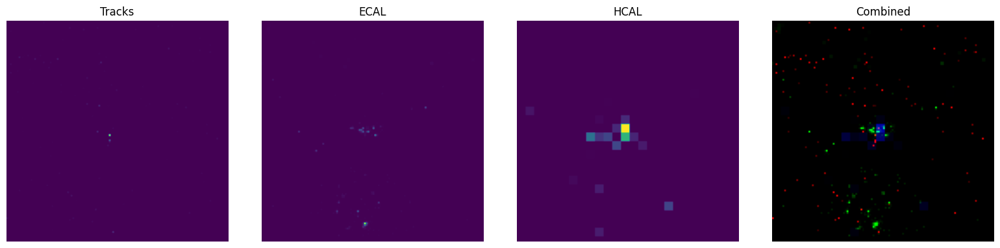

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


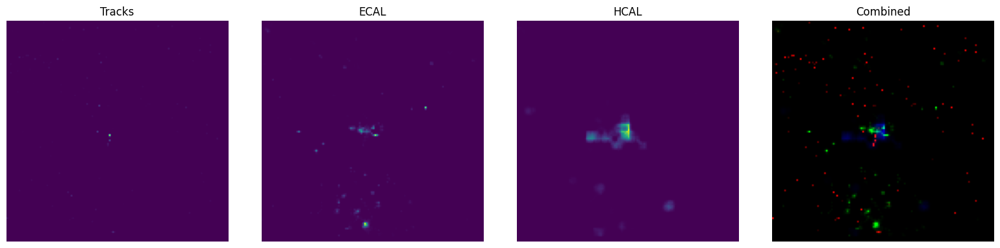

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


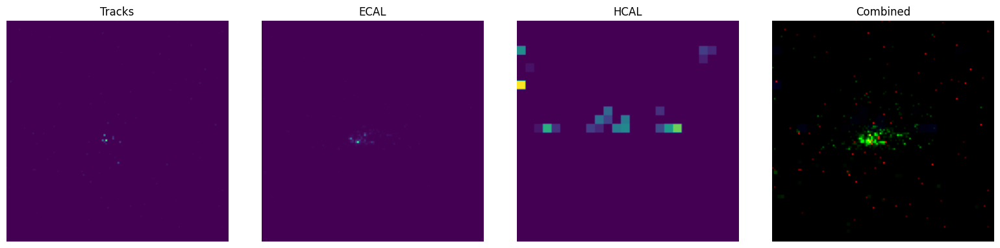

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


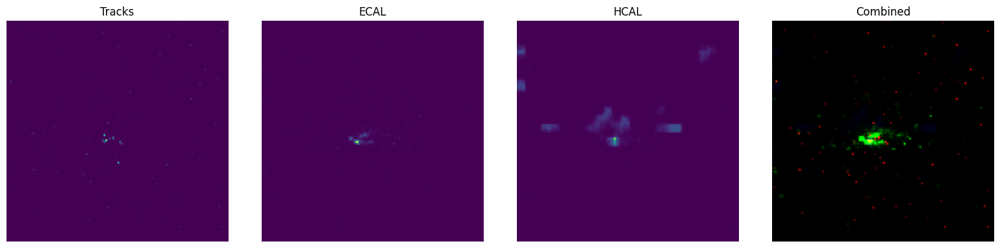

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


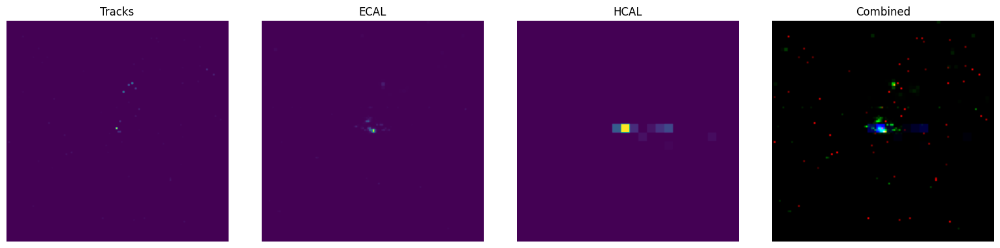

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


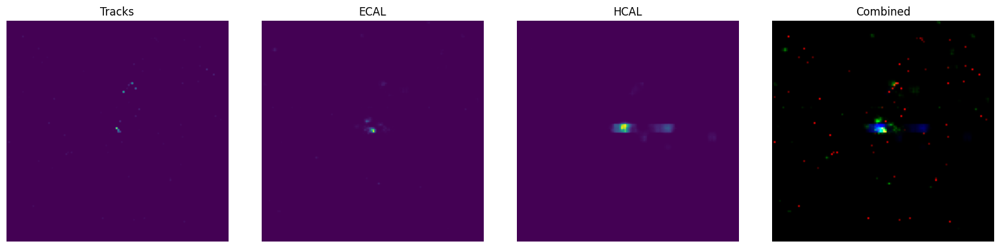

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


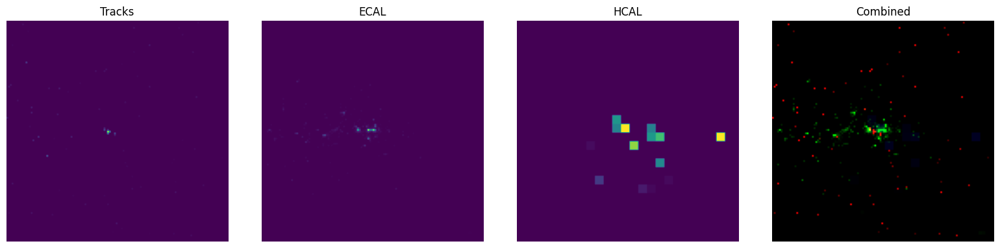

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


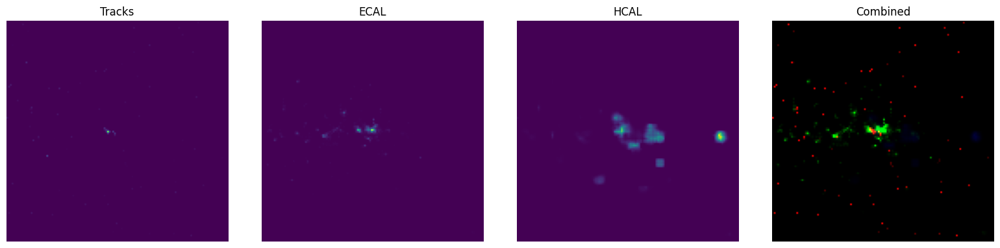

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


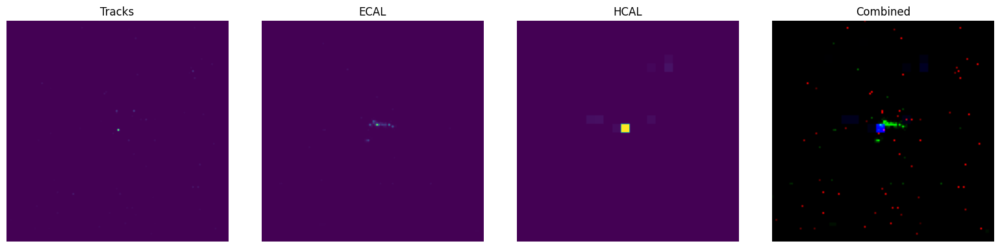

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


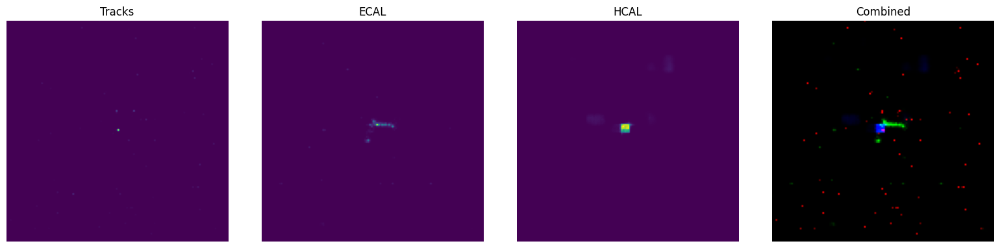

epoch: 161


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]


train_loss: 0.00012469293152680622
epoch: 162


100%|█████████████████████████████████████████| 625/625 [06:52<00:00,  1.52it/s]


train_loss: 0.00012466674285242335
epoch: 163


100%|█████████████████████████████████████████| 625/625 [06:53<00:00,  1.51it/s]


train_loss: 0.00012464268961921335
epoch: 164


100%|█████████████████████████████████████████| 625/625 [06:52<00:00,  1.52it/s]


train_loss: 0.00012461135607445614
epoch: 165


100%|█████████████████████████████████████████| 625/625 [06:53<00:00,  1.51it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.0001245916523388587
Sample #0


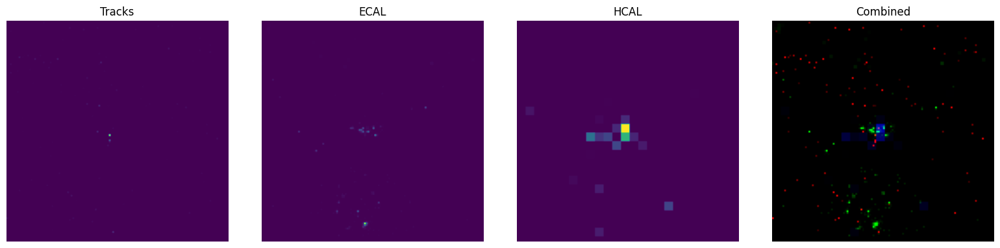

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


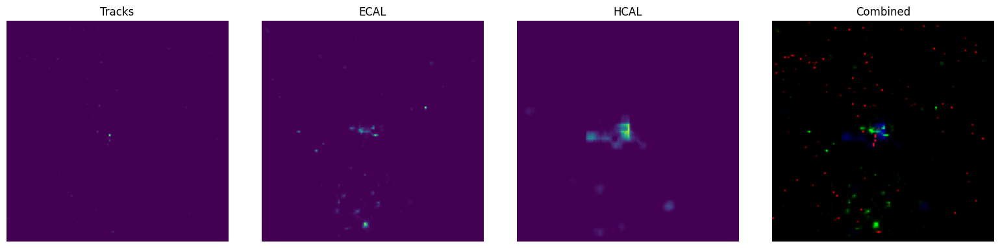

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


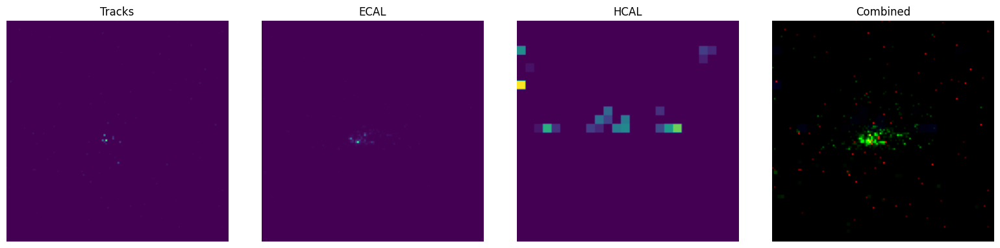

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


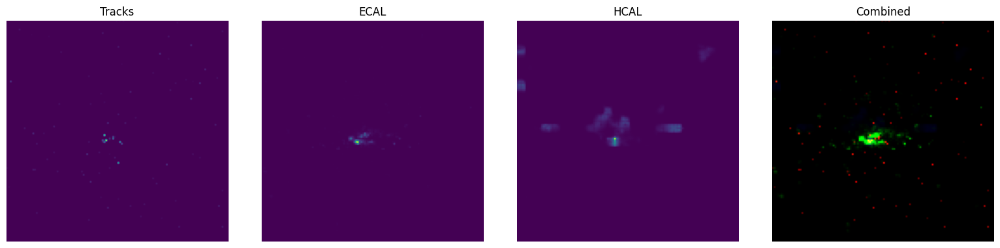

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


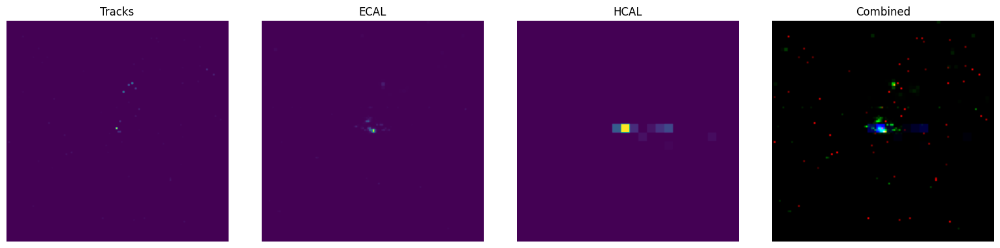

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


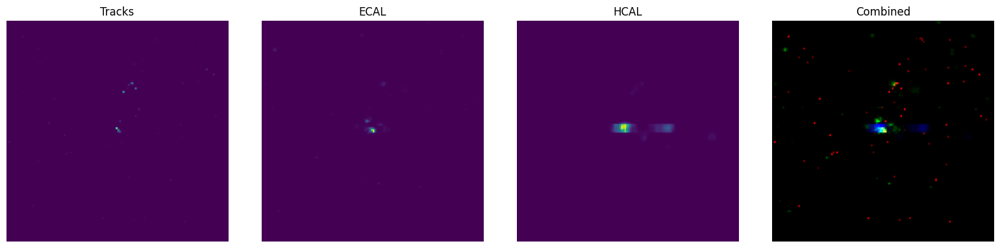

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


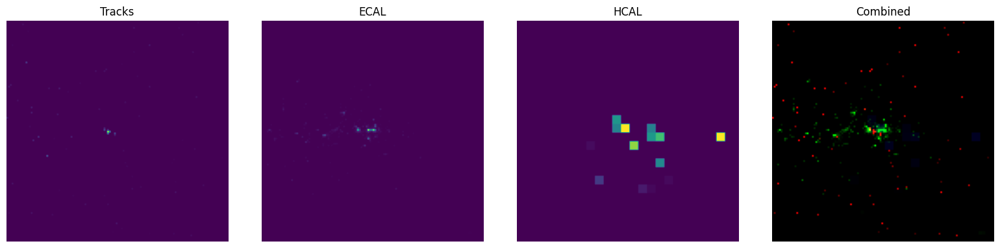

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


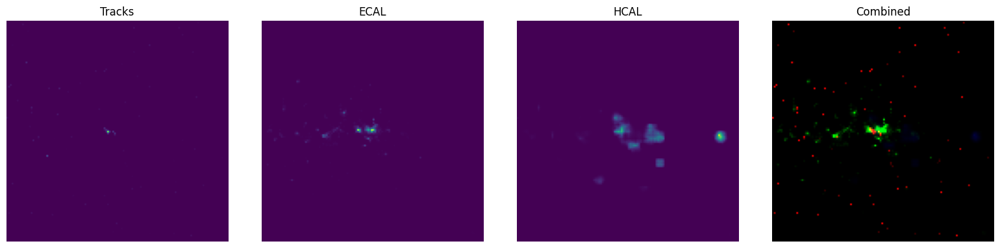

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


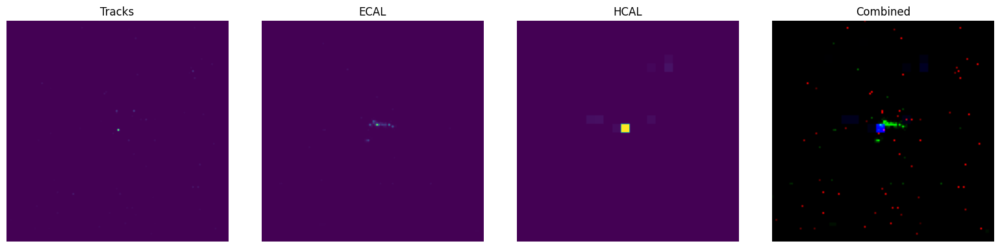

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


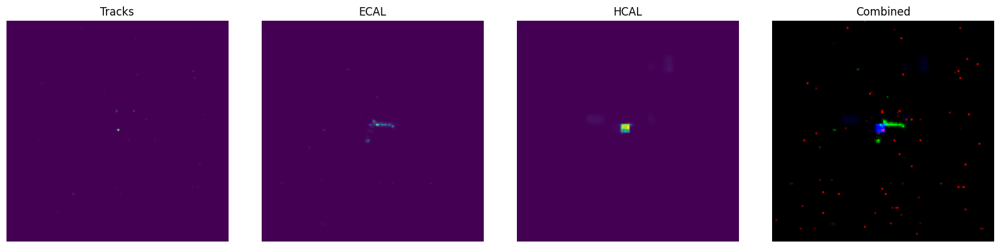

epoch: 166


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]


train_loss: 0.0001245621043839492
epoch: 167


100%|█████████████████████████████████████████| 625/625 [06:51<00:00,  1.52it/s]


train_loss: 0.00012453141493024304
epoch: 168


100%|█████████████████████████████████████████| 625/625 [06:52<00:00,  1.52it/s]


train_loss: 0.00012451400067657232
epoch: 169


100%|█████████████████████████████████████████| 625/625 [06:52<00:00,  1.51it/s]


train_loss: 0.0001244878826662898
epoch: 170


100%|█████████████████████████████████████████| 625/625 [06:53<00:00,  1.51it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.0001244605340878479
Sample #0


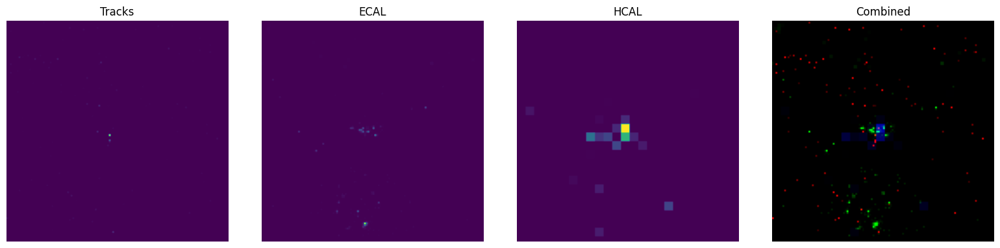

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


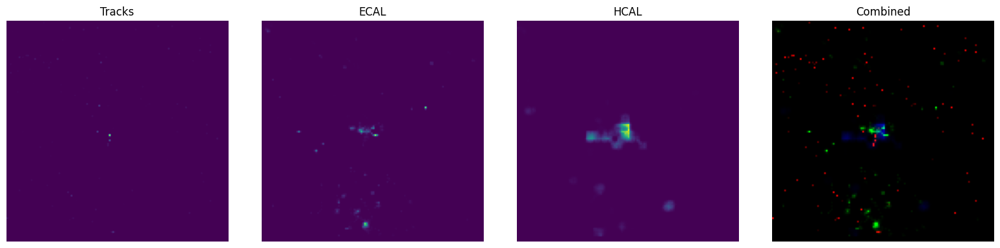

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


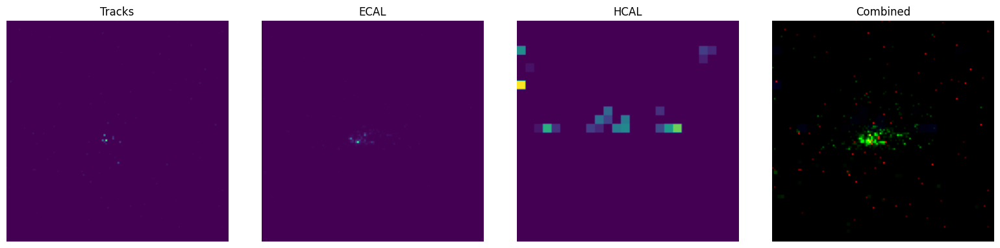

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


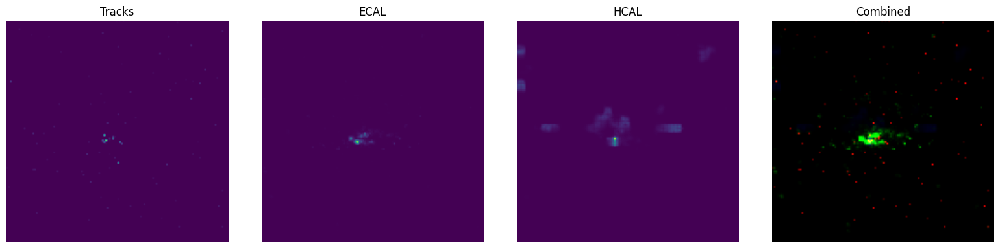

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


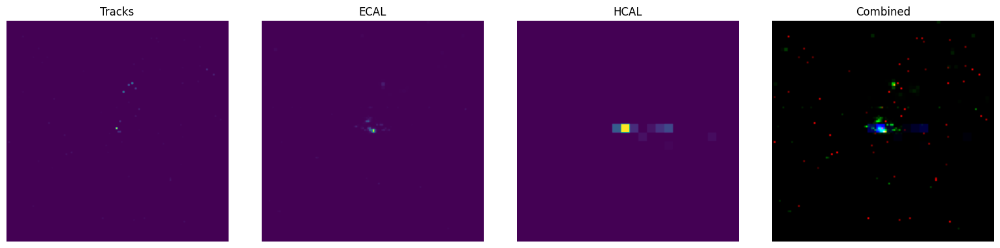

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


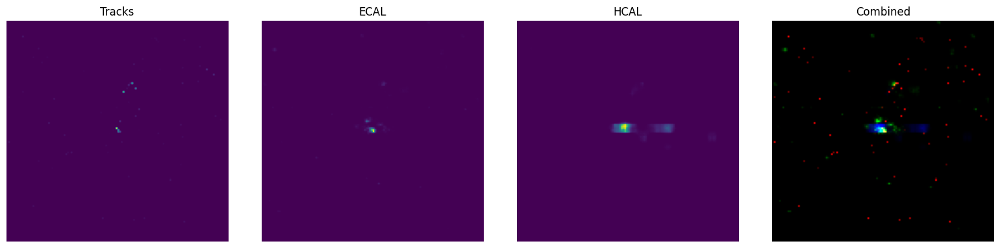

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


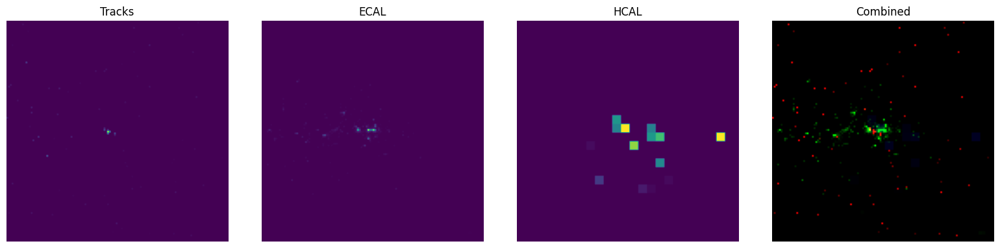

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


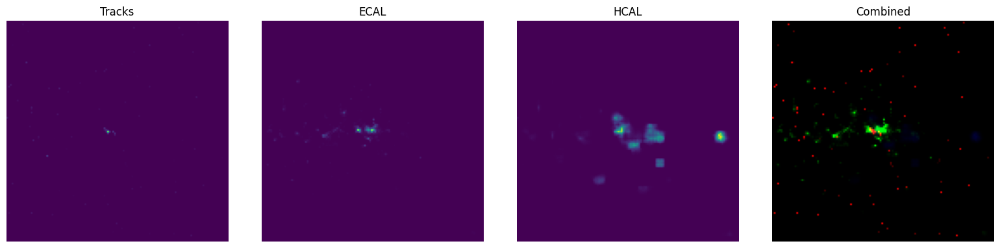

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


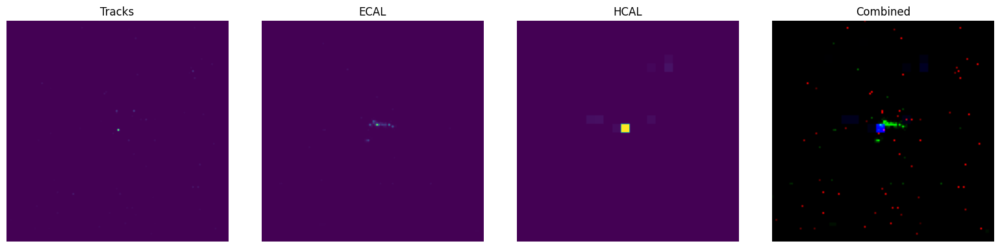

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


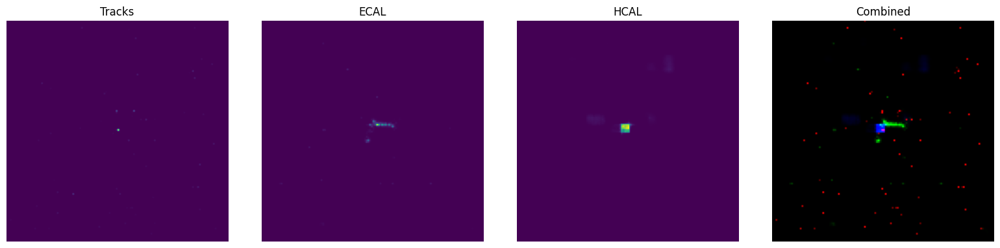

epoch: 171


100%|█████████████████████████████████████████| 625/625 [06:53<00:00,  1.51it/s]


train_loss: 0.0001244365964550525
epoch: 172


100%|█████████████████████████████████████████| 625/625 [06:52<00:00,  1.51it/s]


train_loss: 0.0001244170682388358
epoch: 173


100%|█████████████████████████████████████████| 625/625 [06:52<00:00,  1.51it/s]


train_loss: 0.00012439208715222776
epoch: 174


100%|█████████████████████████████████████████| 625/625 [06:52<00:00,  1.52it/s]


train_loss: 0.00012436272327322512
epoch: 175


100%|█████████████████████████████████████████| 625/625 [06:52<00:00,  1.51it/s]


train_loss: 0.00012434787198435516
Sample #0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


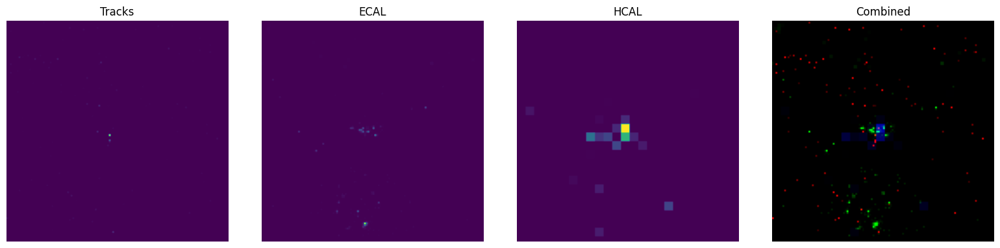

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


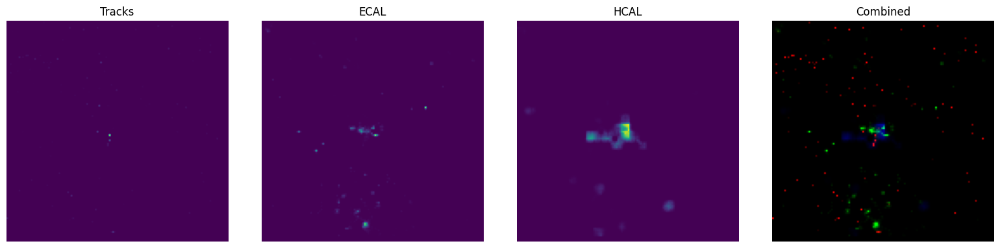

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


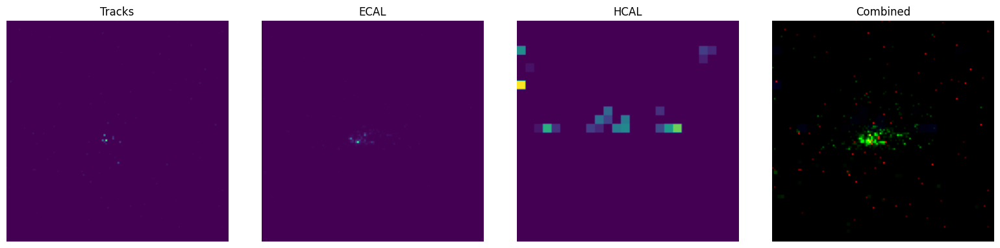

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


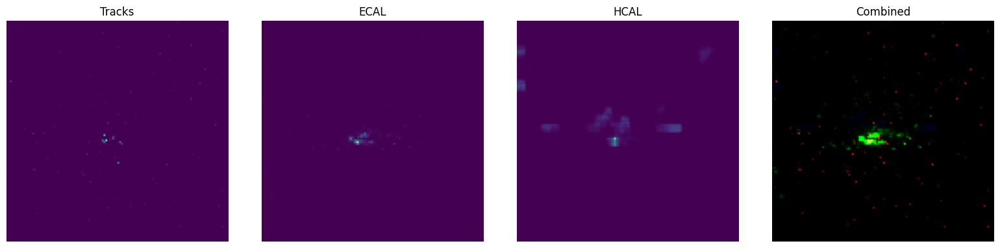

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


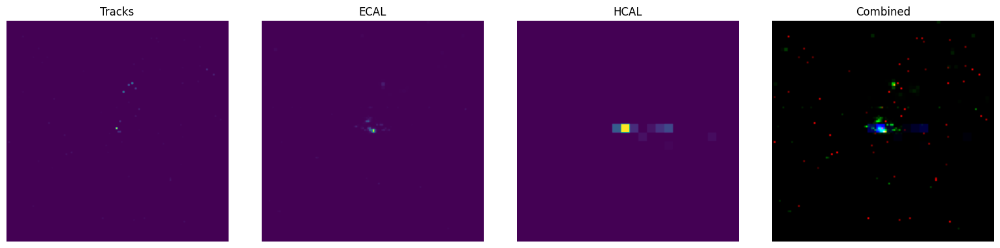

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


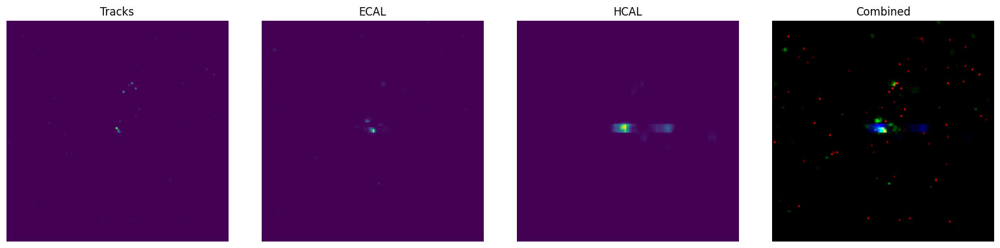

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


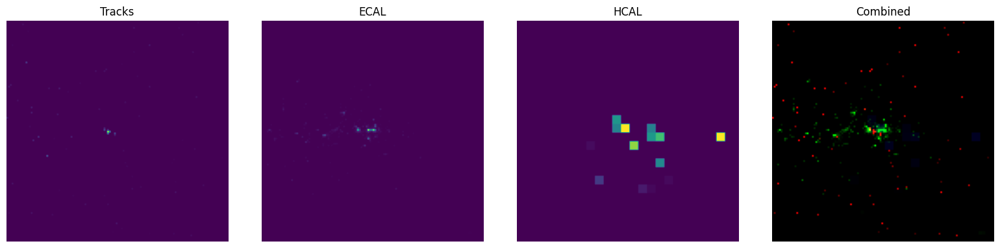

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


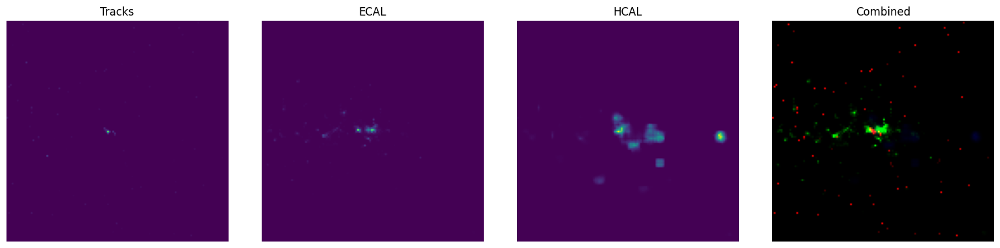

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


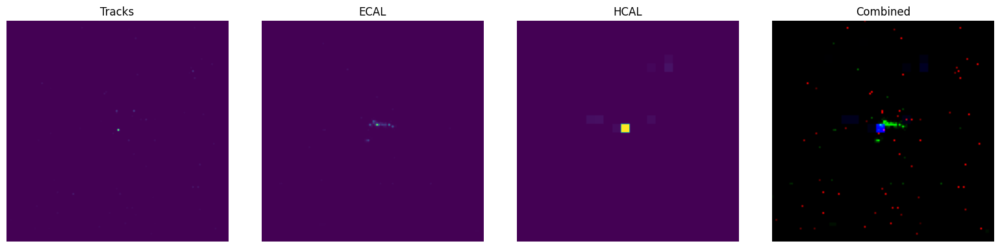

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


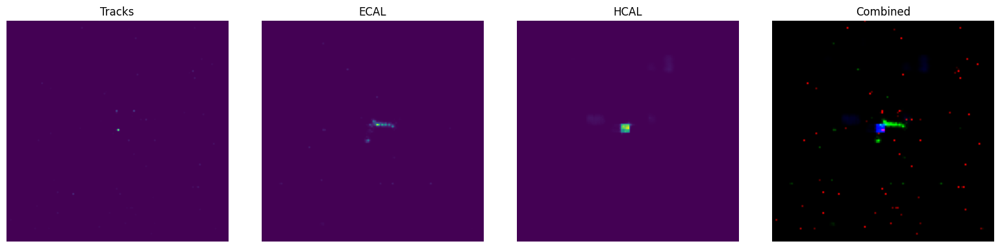

epoch: 176


100%|█████████████████████████████████████████| 625/625 [06:53<00:00,  1.51it/s]


train_loss: 0.00012432325333356858
epoch: 177


100%|█████████████████████████████████████████| 625/625 [06:53<00:00,  1.51it/s]


train_loss: 0.00012430563900852576
epoch: 178


100%|█████████████████████████████████████████| 625/625 [06:53<00:00,  1.51it/s]


train_loss: 0.00012427805181359873
epoch: 179


100%|█████████████████████████████████████████| 625/625 [06:52<00:00,  1.51it/s]


train_loss: 0.0001242587492801249
epoch: 180


100%|█████████████████████████████████████████| 625/625 [06:53<00:00,  1.51it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.0001242476743995212
Sample #0


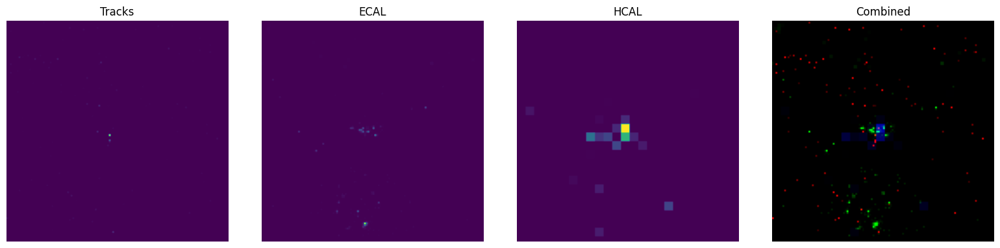

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


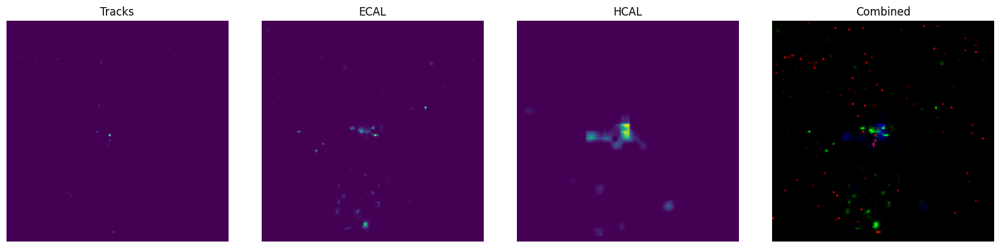

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


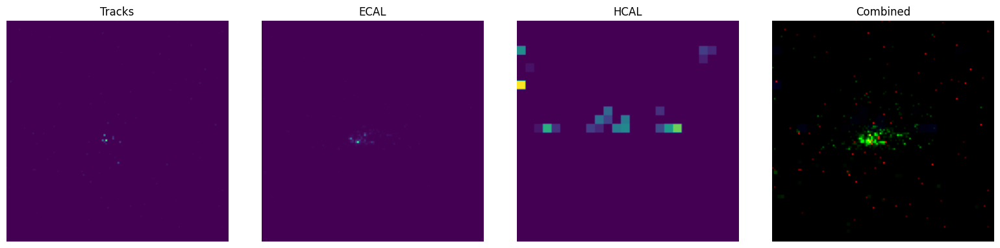

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


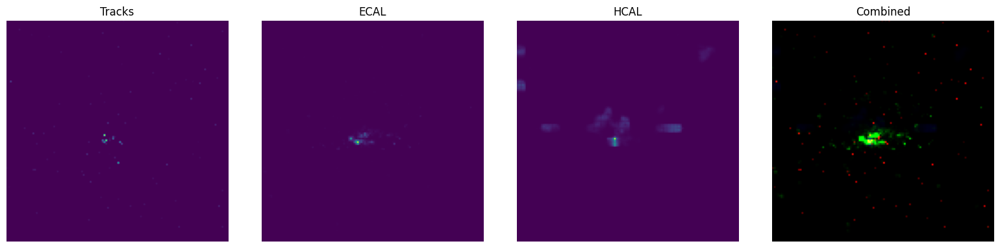

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


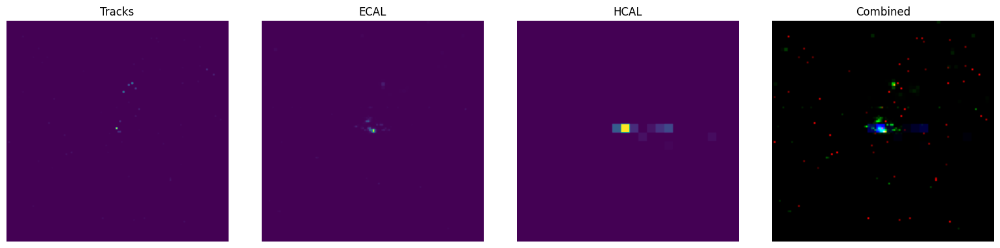

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


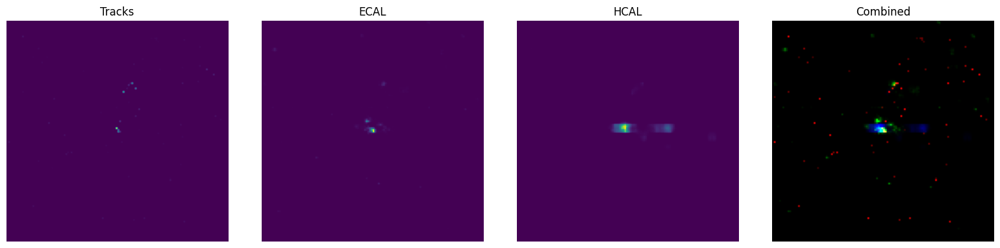

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


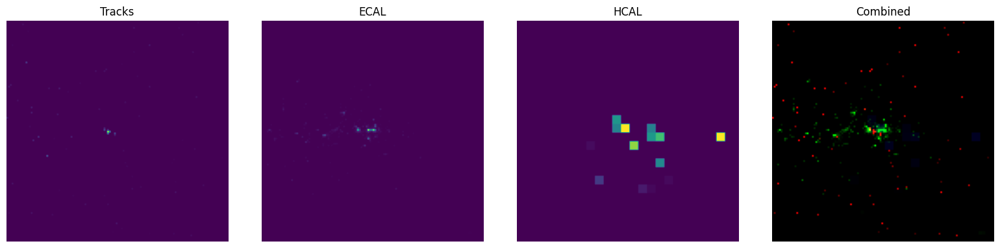

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


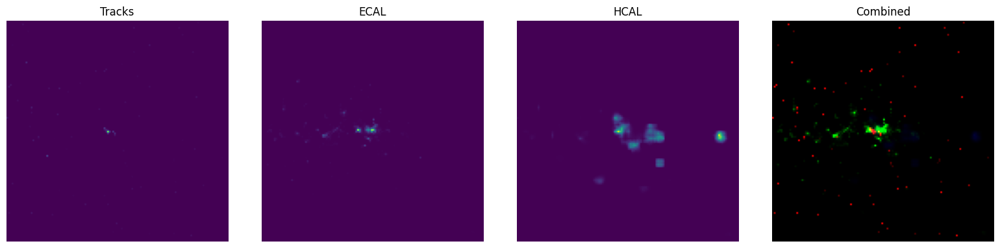

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


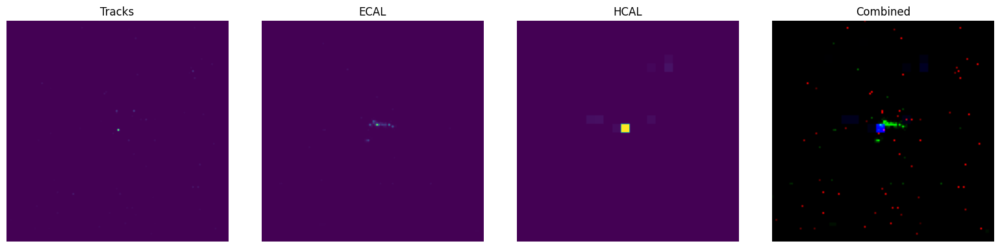

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


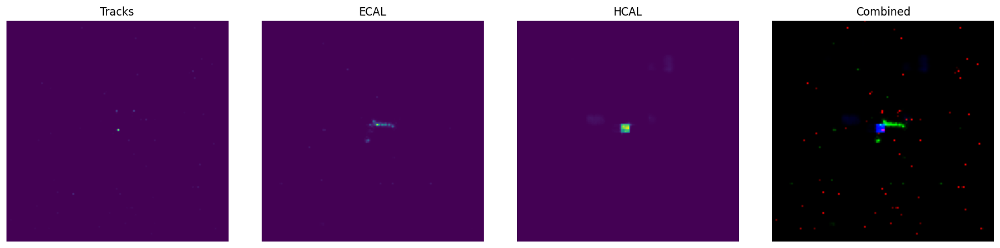

epoch: 181


100%|█████████████████████████████████████████| 625/625 [06:53<00:00,  1.51it/s]


train_loss: 0.00012422643513418735
epoch: 182


100%|█████████████████████████████████████████| 625/625 [06:52<00:00,  1.51it/s]


train_loss: 0.000124202092573978
epoch: 183


100%|█████████████████████████████████████████| 625/625 [06:52<00:00,  1.51it/s]


train_loss: 0.00012418691046768798
epoch: 184


100%|█████████████████████████████████████████| 625/625 [06:53<00:00,  1.51it/s]


train_loss: 0.00012417254694737493
epoch: 185


100%|█████████████████████████████████████████| 625/625 [06:53<00:00,  1.51it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.00012415458528557791
Sample #0


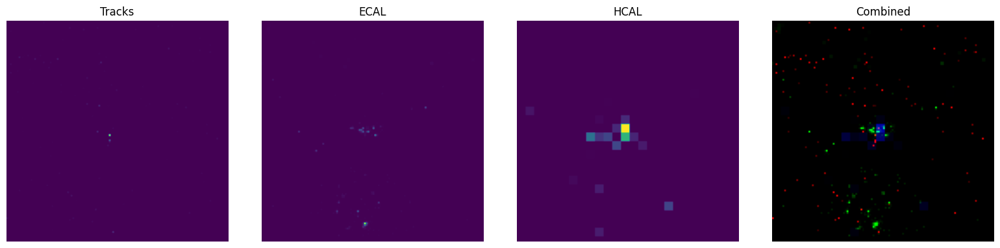

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


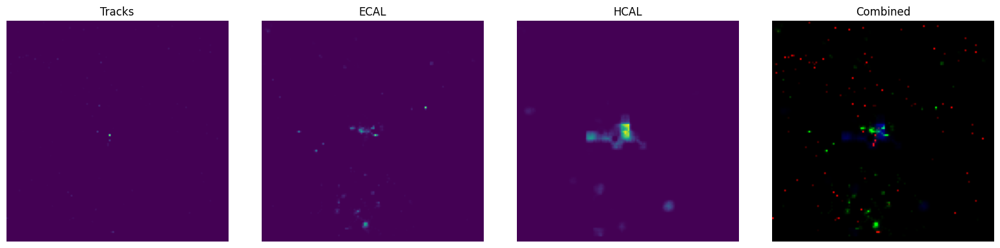

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


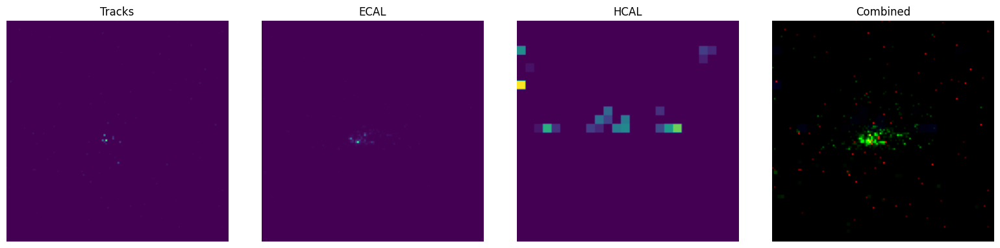

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


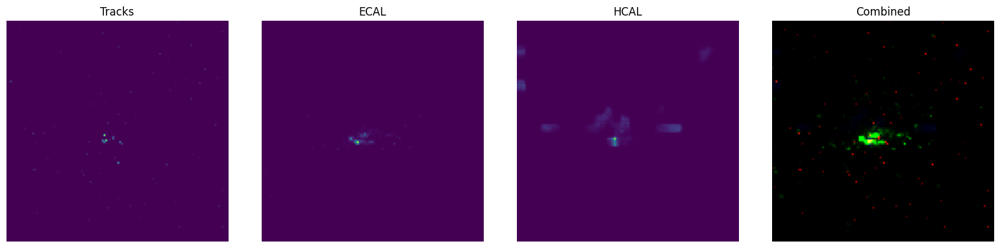

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


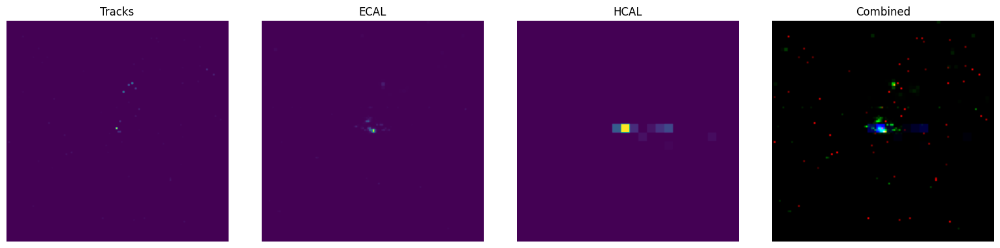

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


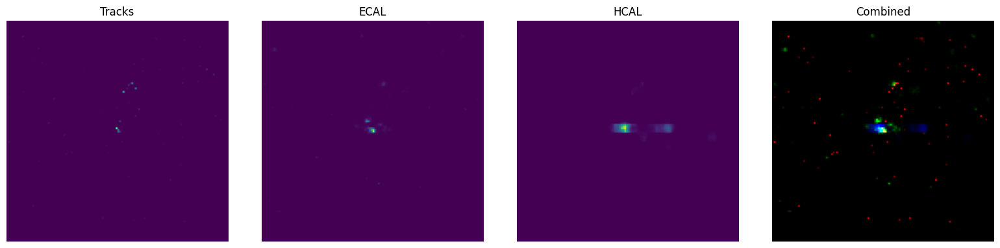

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


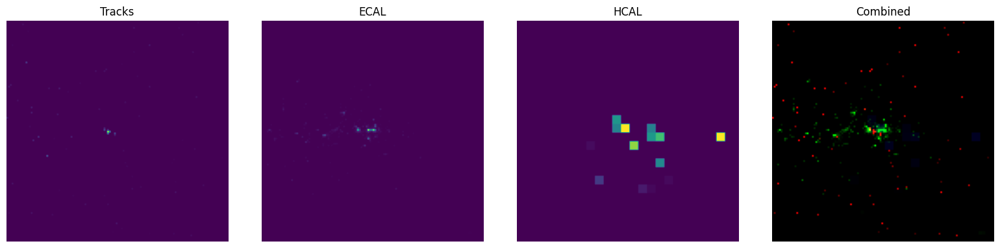

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


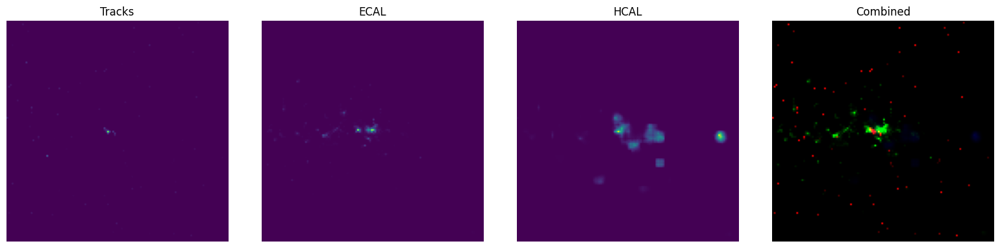

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


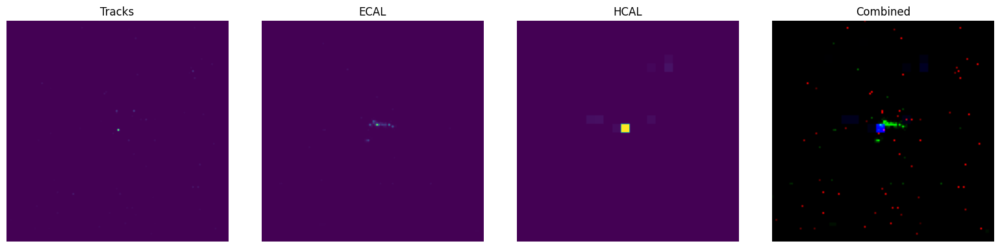

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


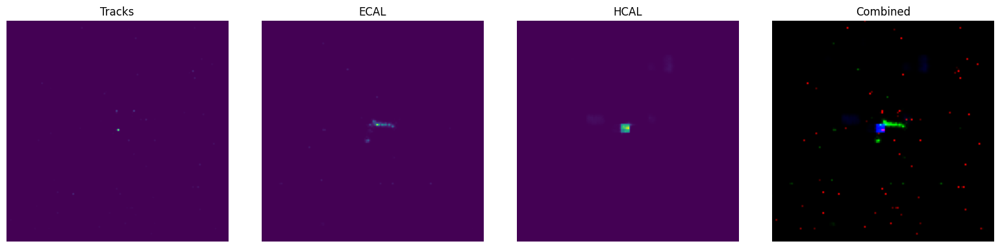

epoch: 186


100%|█████████████████████████████████████████| 625/625 [06:53<00:00,  1.51it/s]


train_loss: 0.0001241325335460715
epoch: 187


100%|█████████████████████████████████████████| 625/625 [06:53<00:00,  1.51it/s]


train_loss: 0.0001241218896349892
epoch: 188


100%|█████████████████████████████████████████| 625/625 [06:54<00:00,  1.51it/s]


train_loss: 0.00012410349737619982
epoch: 189


100%|█████████████████████████████████████████| 625/625 [06:53<00:00,  1.51it/s]


train_loss: 0.00012408642893424257
epoch: 190


100%|█████████████████████████████████████████| 625/625 [06:53<00:00,  1.51it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.0001240671020699665
Sample #0


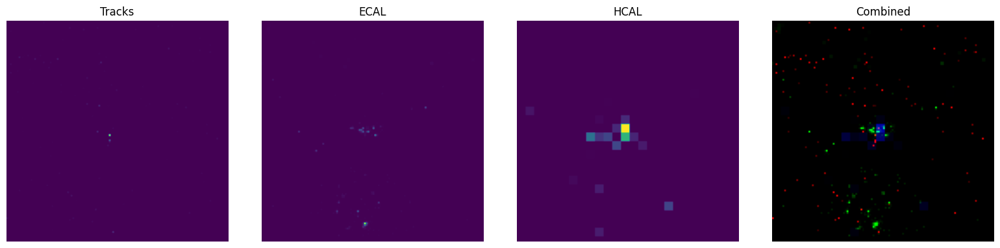

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


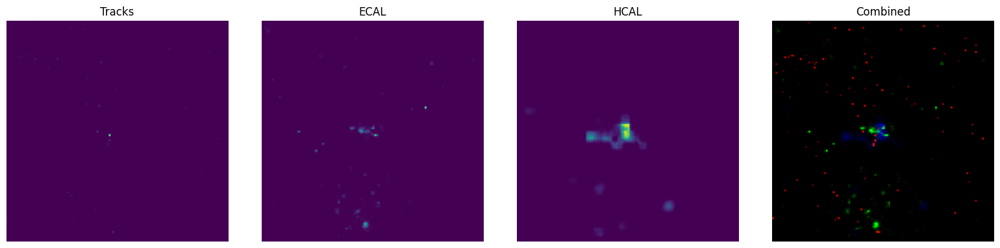

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


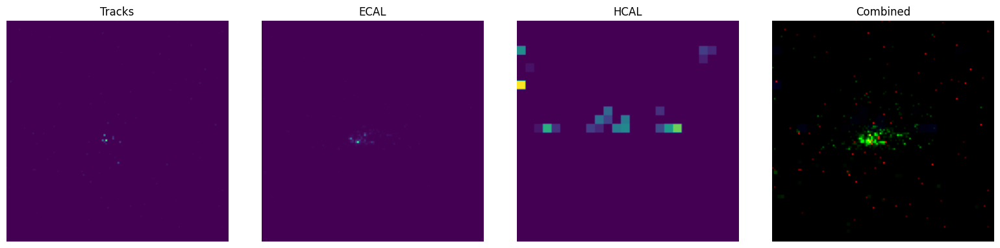

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


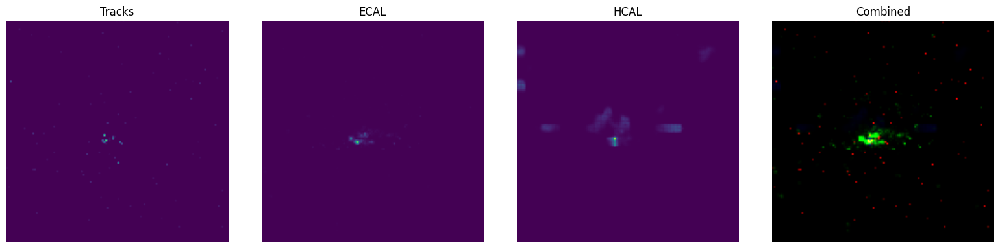

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


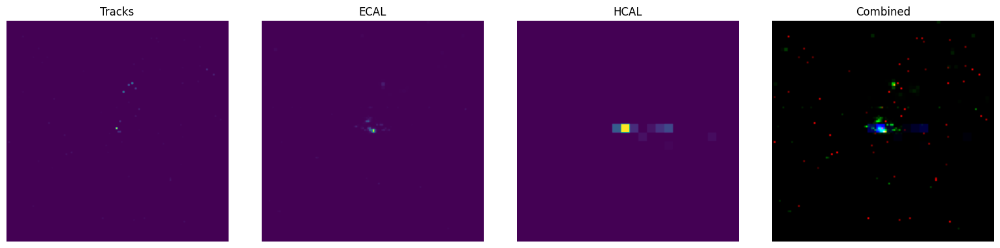

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


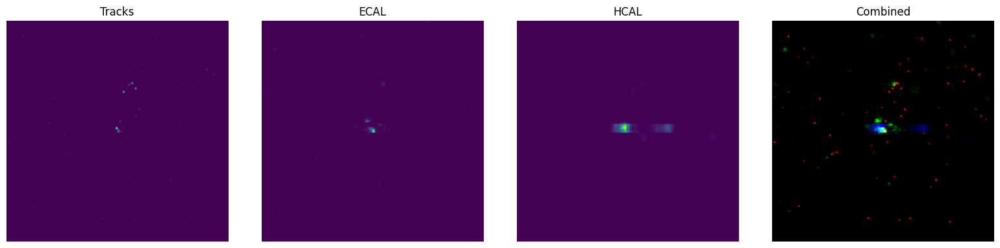

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


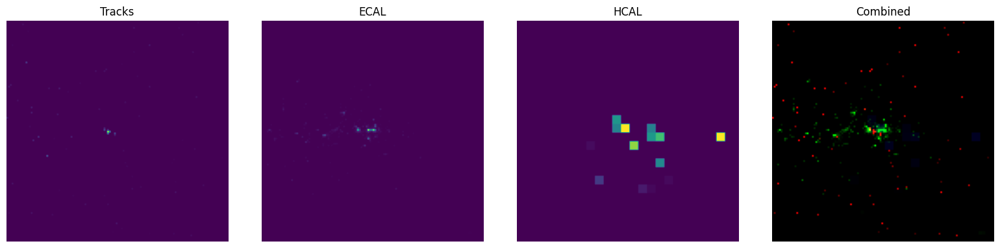

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


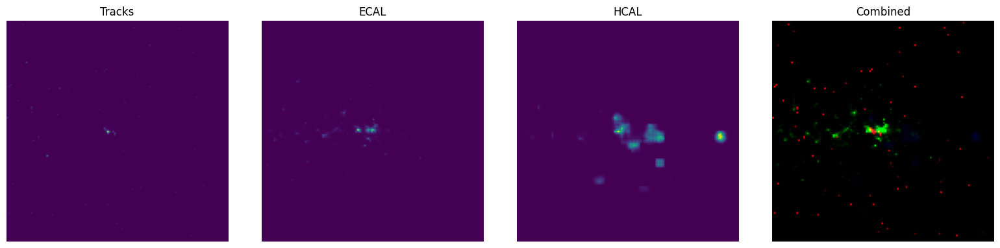

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


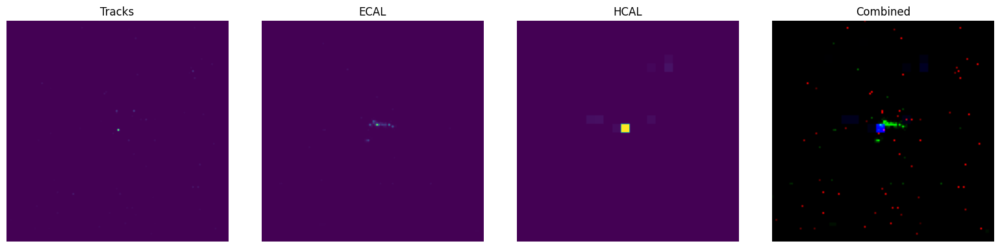

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


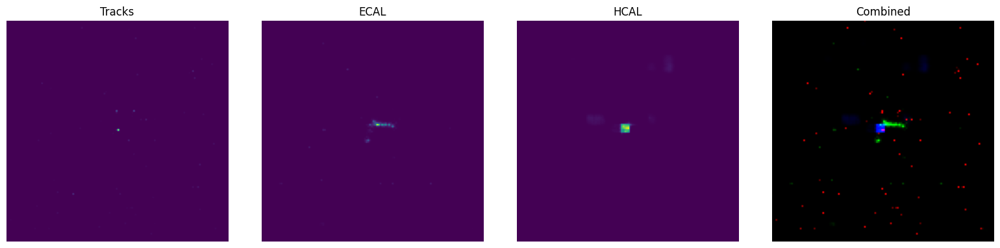

epoch: 191


100%|█████████████████████████████████████████| 625/625 [06:52<00:00,  1.51it/s]


train_loss: 0.00012405489097582176
epoch: 192


100%|█████████████████████████████████████████| 625/625 [06:53<00:00,  1.51it/s]


train_loss: 0.0001240377040579915
epoch: 193


100%|█████████████████████████████████████████| 625/625 [06:52<00:00,  1.51it/s]


train_loss: 0.00012402621890651063
epoch: 194


100%|█████████████████████████████████████████| 625/625 [06:54<00:00,  1.51it/s]


train_loss: 0.00012401504677254707
epoch: 195


100%|█████████████████████████████████████████| 625/625 [06:54<00:00,  1.51it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.00012399583439109846
Sample #0


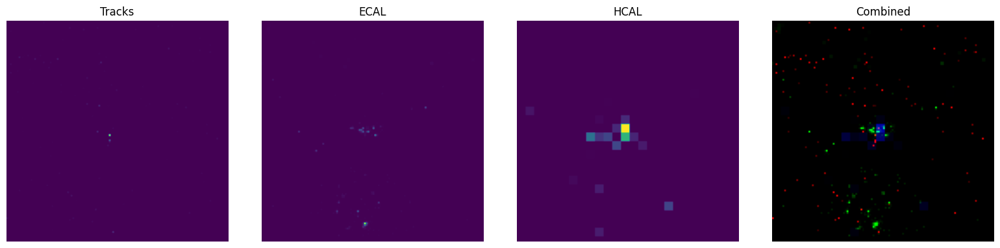

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


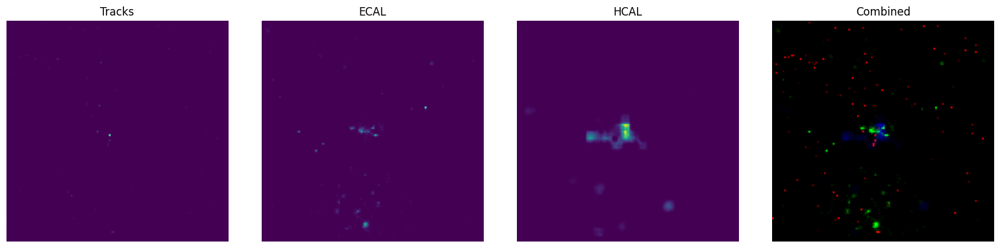

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


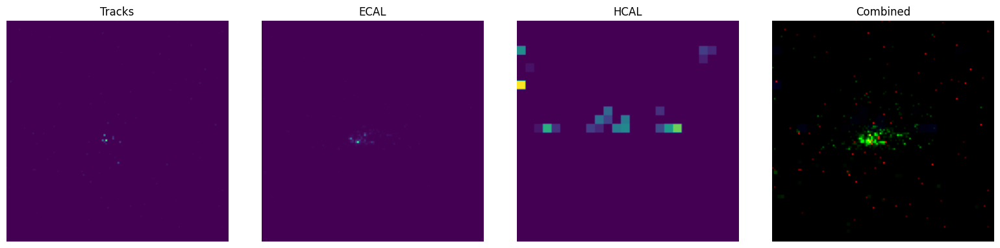

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


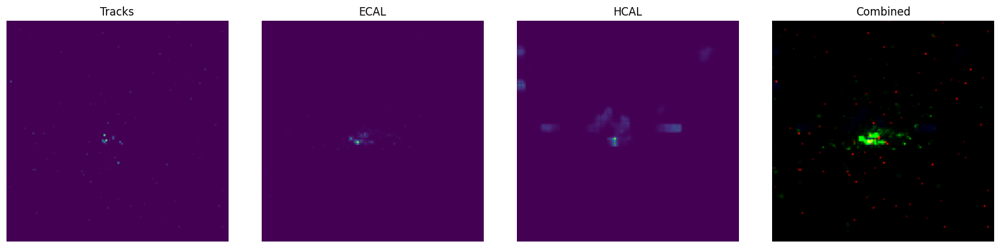

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


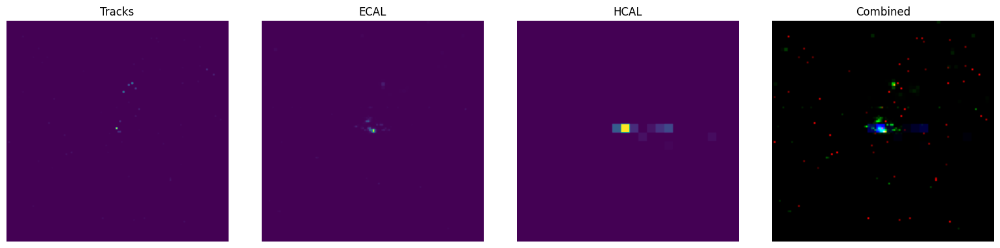

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


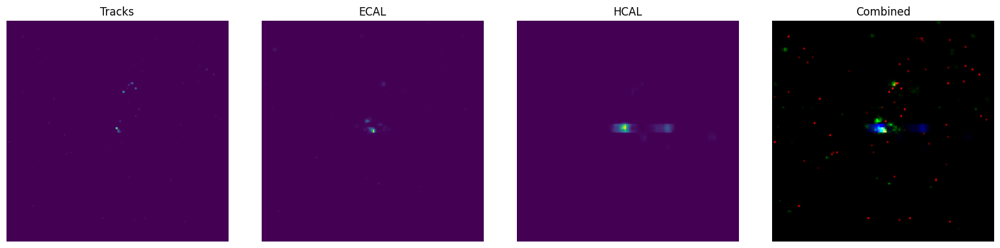

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


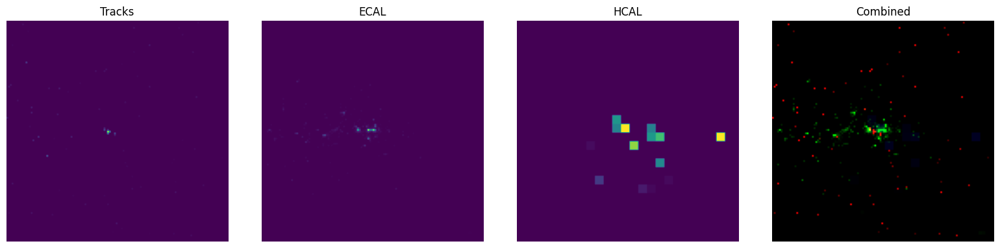

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


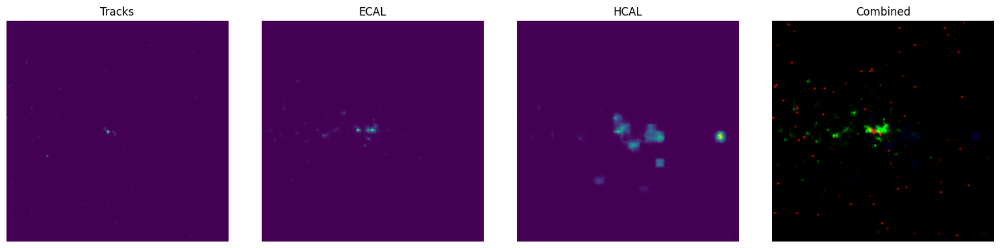

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


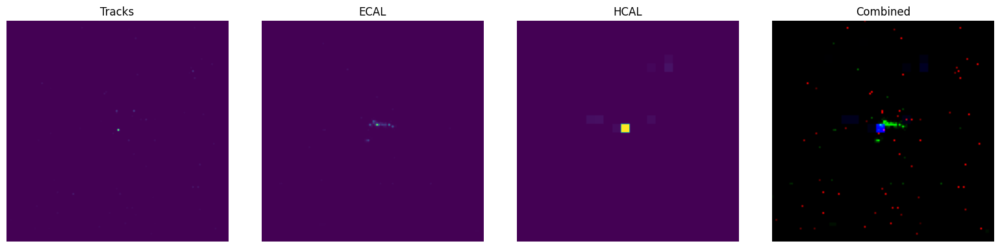

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


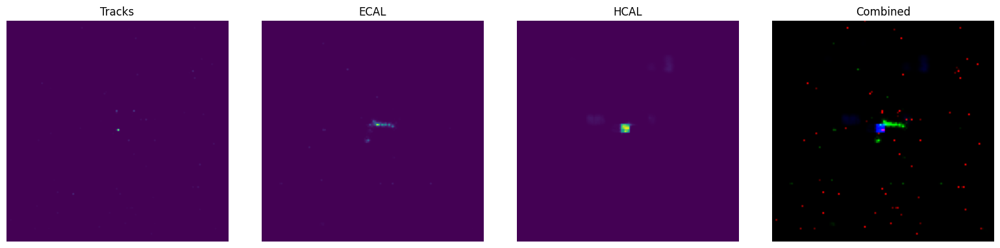

epoch: 196


100%|█████████████████████████████████████████| 625/625 [06:55<00:00,  1.50it/s]


train_loss: 0.0001239834678824991
epoch: 197


100%|█████████████████████████████████████████| 625/625 [06:56<00:00,  1.50it/s]


train_loss: 0.00012397050767904149
epoch: 198


100%|█████████████████████████████████████████| 625/625 [06:55<00:00,  1.51it/s]


train_loss: 0.00012395661443006248
epoch: 199


100%|█████████████████████████████████████████| 625/625 [06:54<00:00,  1.51it/s]


train_loss: 0.00012394333144184202
epoch: 200


100%|█████████████████████████████████████████| 625/625 [06:54<00:00,  1.51it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.00012392716651083902
Sample #0


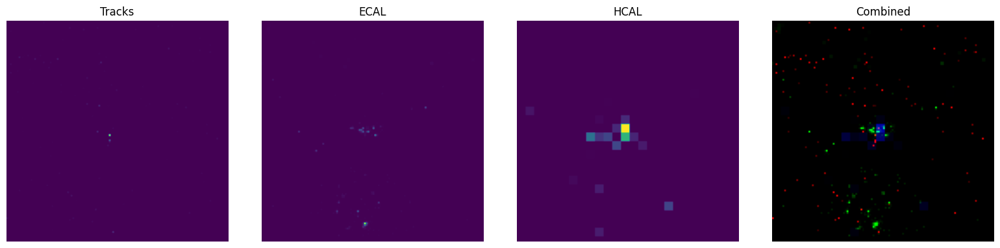

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


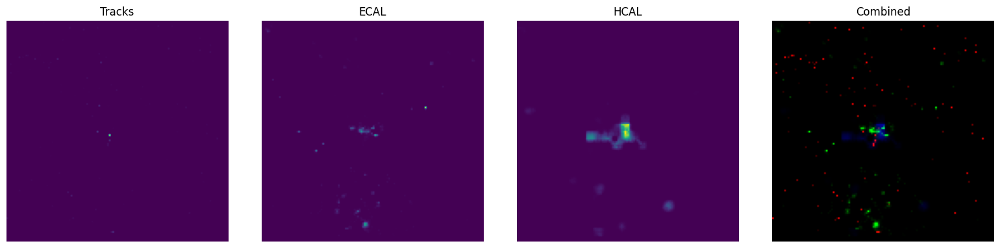

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


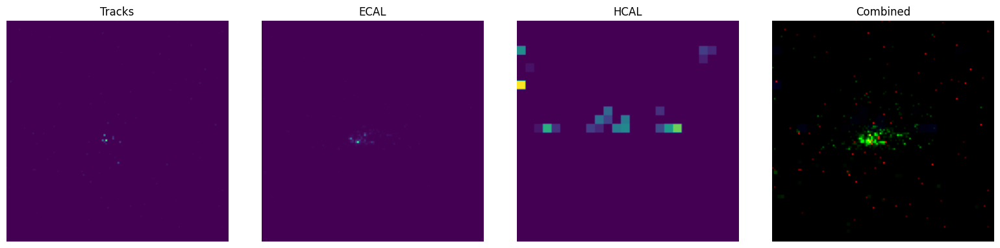

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


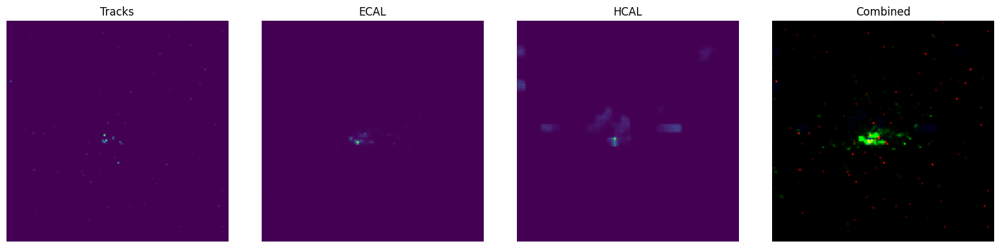

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


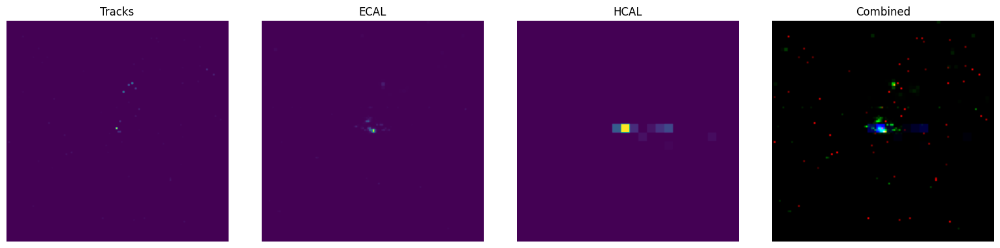

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


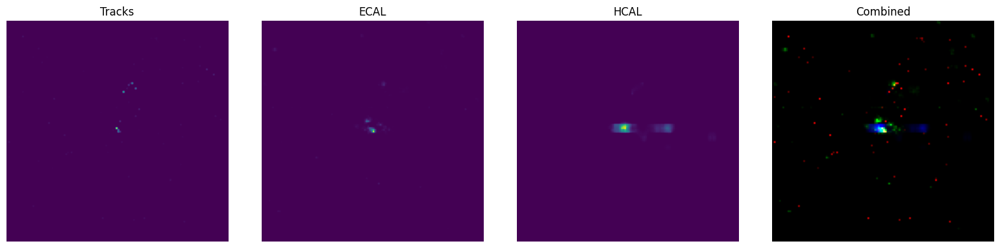

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


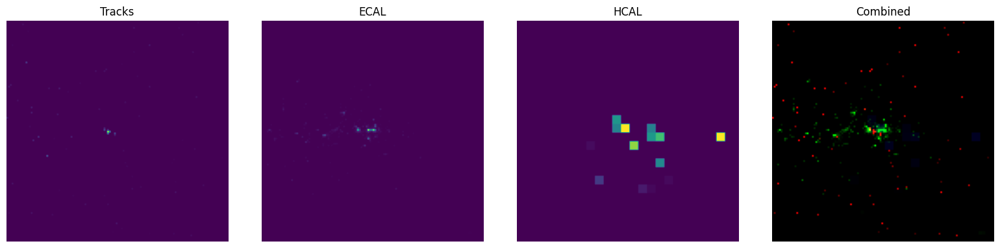

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


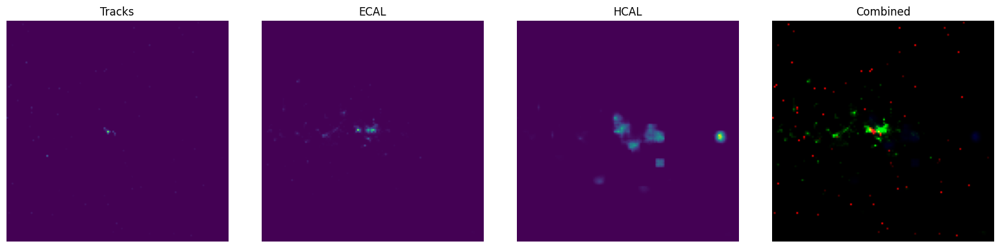

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


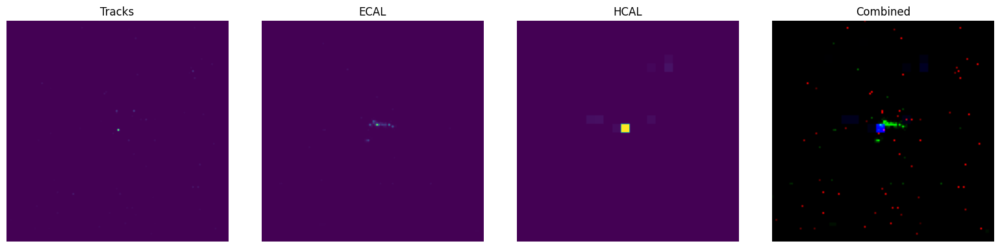

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


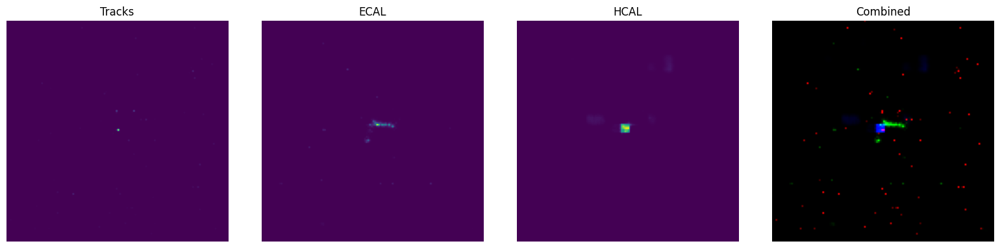

epoch: 201


100%|█████████████████████████████████████████| 625/625 [06:54<00:00,  1.51it/s]


train_loss: 0.00012391577841481193
epoch: 202


100%|█████████████████████████████████████████| 625/625 [06:54<00:00,  1.51it/s]


train_loss: 0.00012390648943837732
epoch: 203


100%|█████████████████████████████████████████| 625/625 [06:54<00:00,  1.51it/s]


train_loss: 0.000123891736054793
epoch: 204


100%|█████████████████████████████████████████| 625/625 [06:53<00:00,  1.51it/s]


train_loss: 0.0001238805173547007
epoch: 205


100%|█████████████████████████████████████████| 625/625 [06:54<00:00,  1.51it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.0001238680504146032
Sample #0


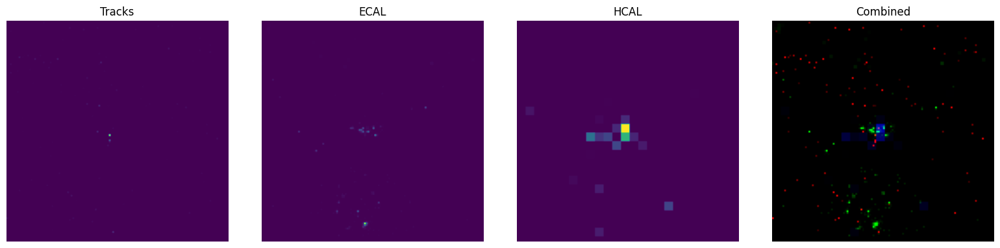

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


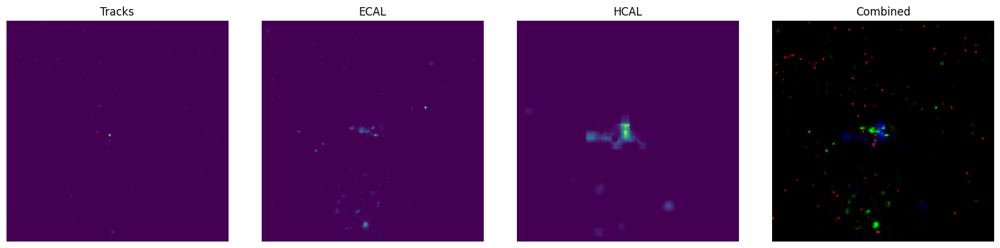

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


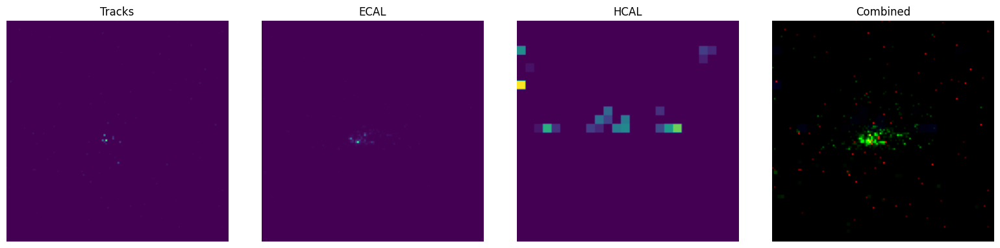

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


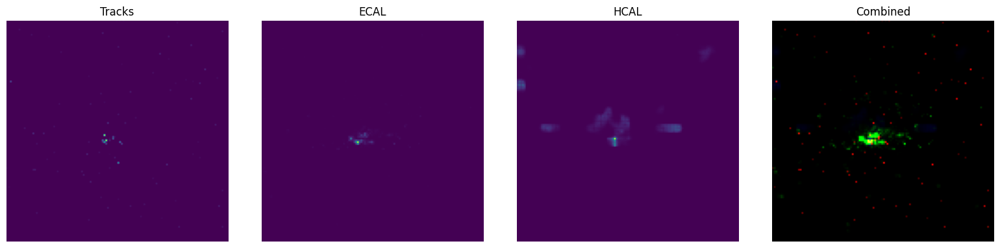

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


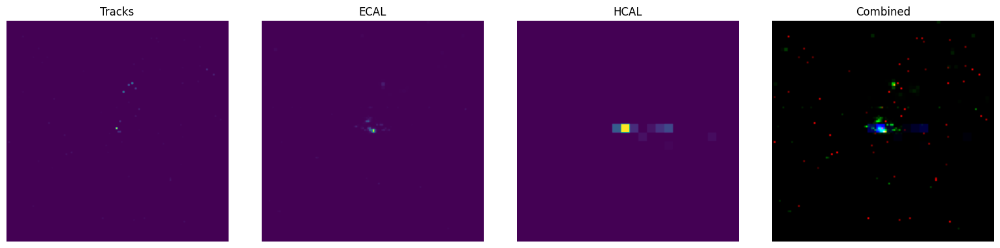

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


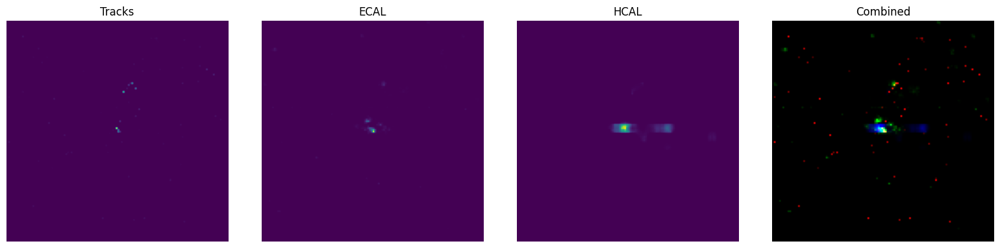

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


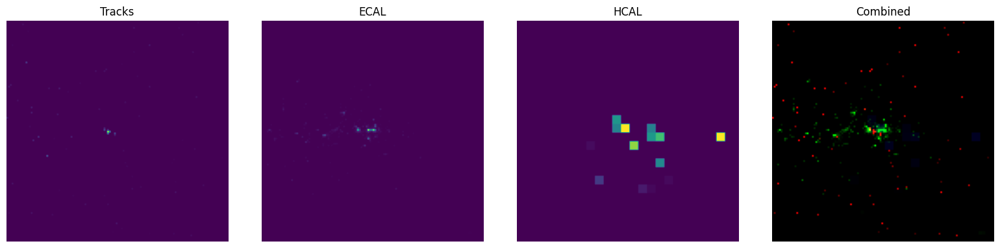

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


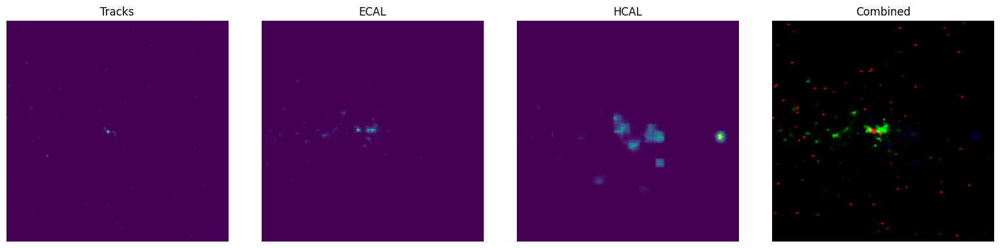

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


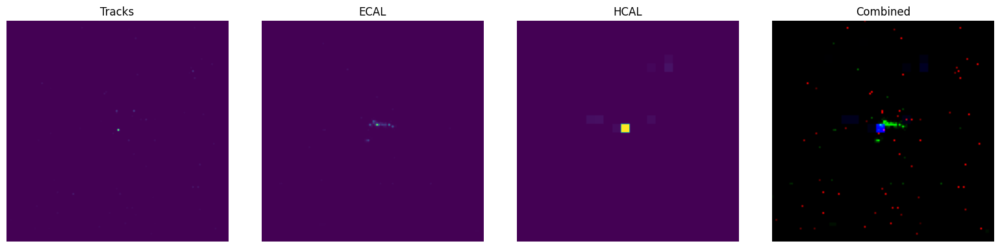

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


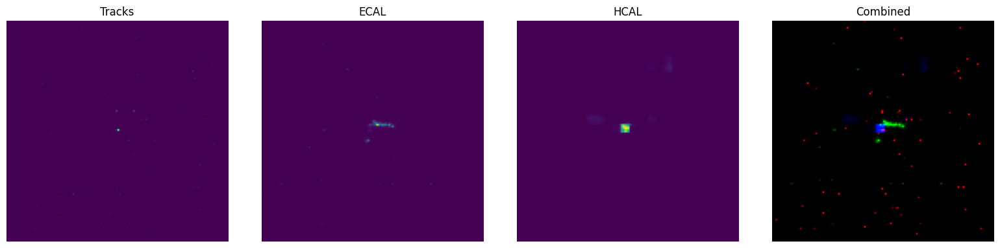

epoch: 206


100%|█████████████████████████████████████████| 625/625 [06:54<00:00,  1.51it/s]


train_loss: 0.0001238538670237176
epoch: 207


100%|█████████████████████████████████████████| 625/625 [06:54<00:00,  1.51it/s]


train_loss: 0.00012384712554048747
epoch: 208


100%|█████████████████████████████████████████| 625/625 [06:54<00:00,  1.51it/s]


train_loss: 0.00012383679406484588
epoch: 209


100%|█████████████████████████████████████████| 625/625 [06:54<00:00,  1.51it/s]


train_loss: 0.0001238222851534374
epoch: 210


100%|█████████████████████████████████████████| 625/625 [06:55<00:00,  1.50it/s]


train_loss: 0.00012381358471466228
Sample #0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


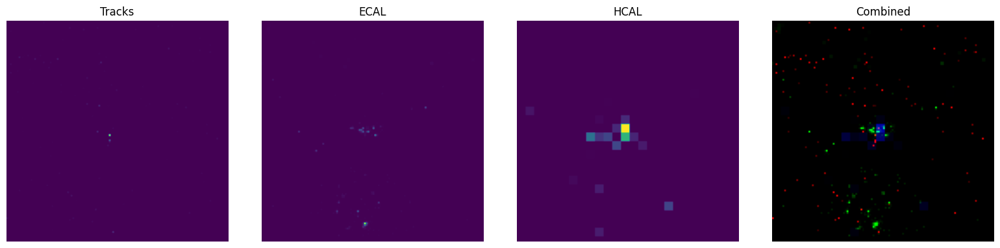

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


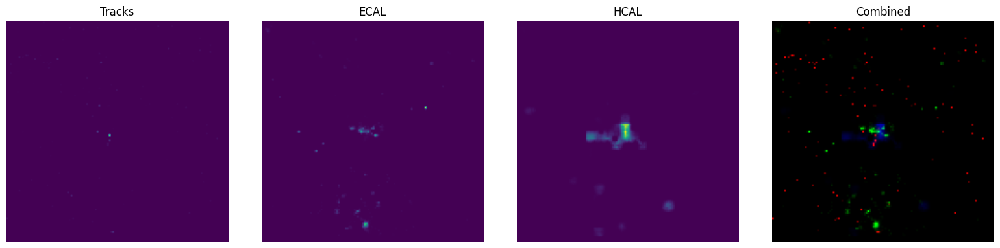

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


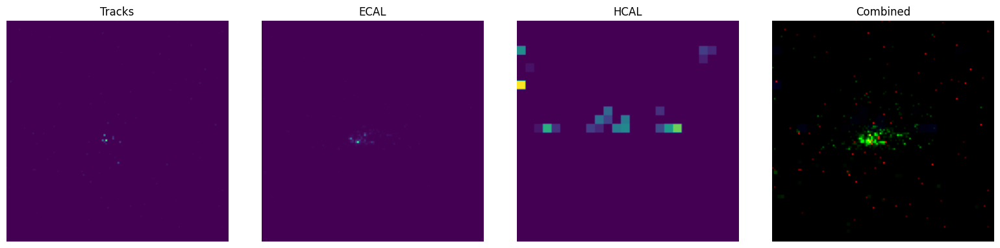

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


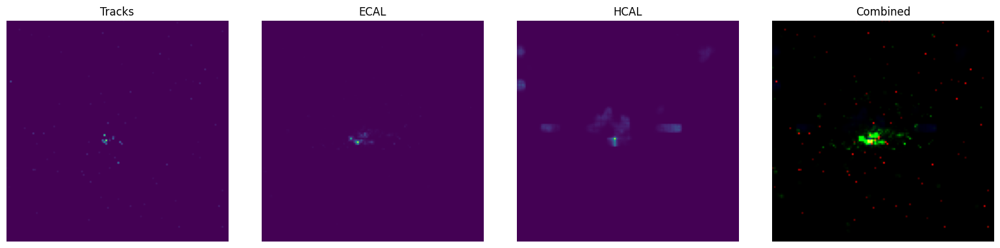

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


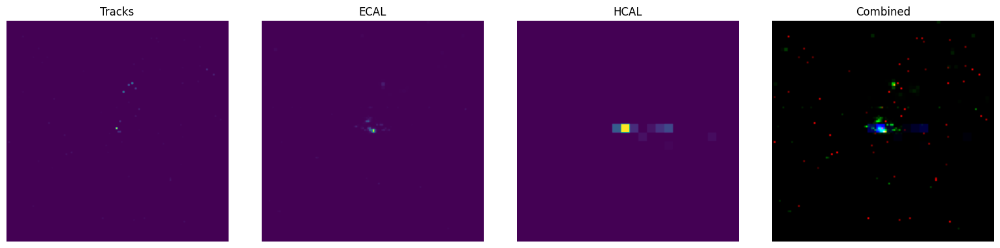

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


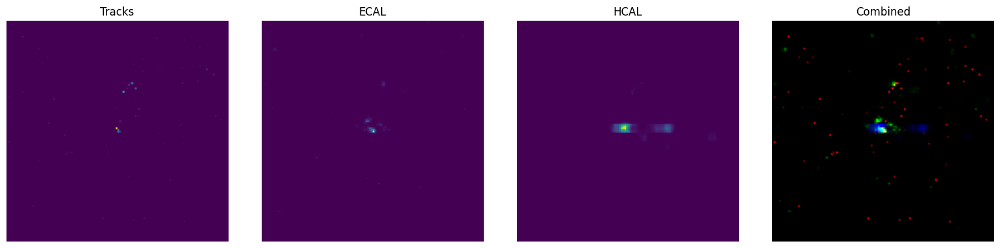

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


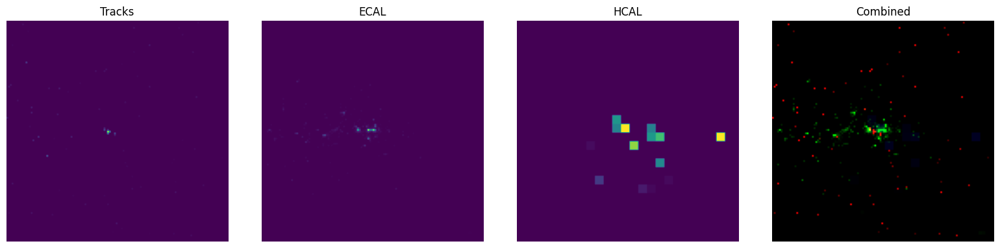

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


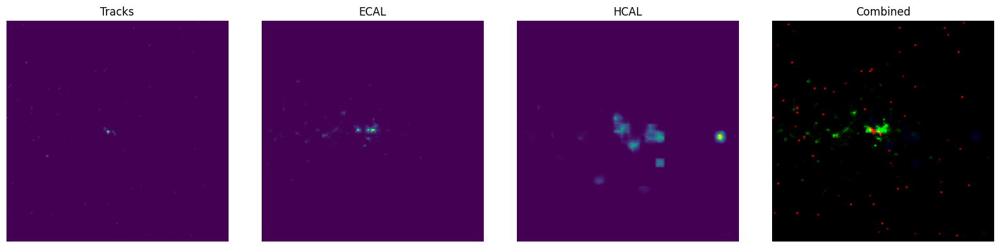

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


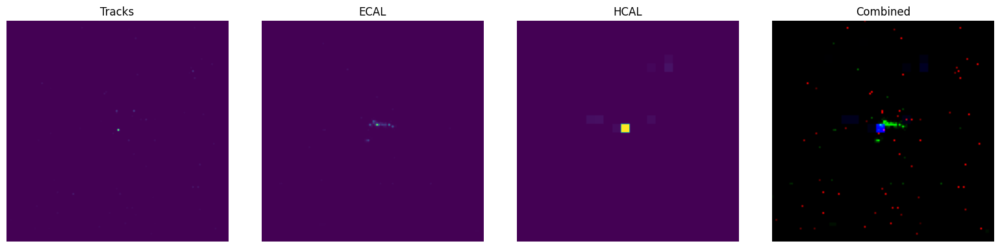

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


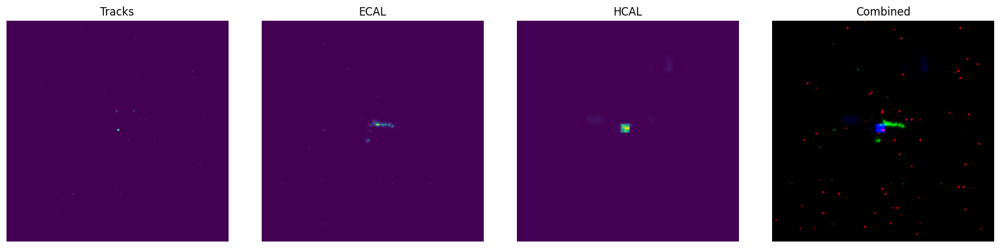

epoch: 211


100%|█████████████████████████████████████████| 625/625 [06:54<00:00,  1.51it/s]


train_loss: 0.0001238002991536632
epoch: 212


100%|█████████████████████████████████████████| 625/625 [06:54<00:00,  1.51it/s]


train_loss: 0.00012378719502594322
epoch: 213


100%|█████████████████████████████████████████| 625/625 [06:55<00:00,  1.51it/s]


train_loss: 0.00012378089914564044
epoch: 214


100%|█████████████████████████████████████████| 625/625 [06:54<00:00,  1.51it/s]


train_loss: 0.00012376796040916815
epoch: 215


100%|█████████████████████████████████████████| 625/625 [06:55<00:00,  1.50it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.00012375421820906923
Sample #0


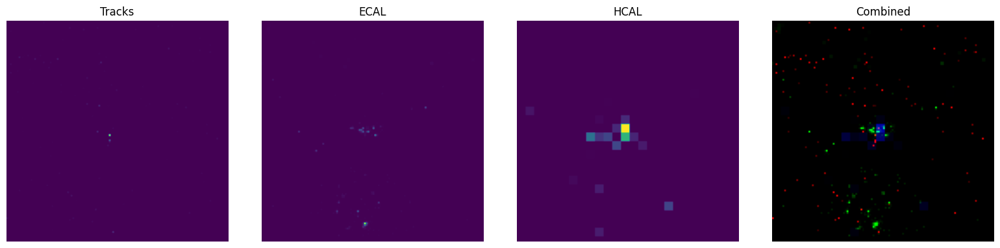

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


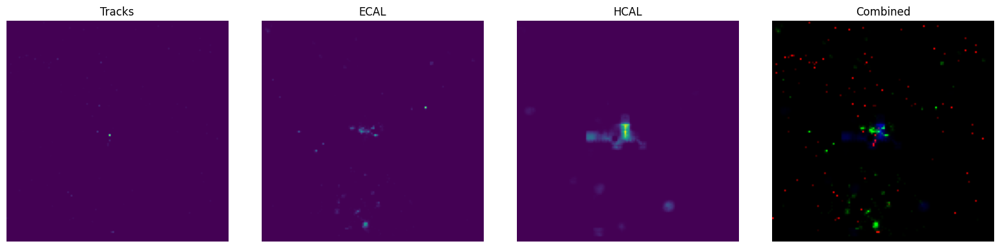

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


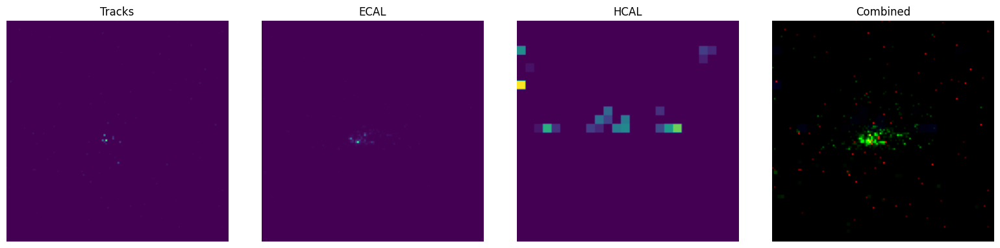

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


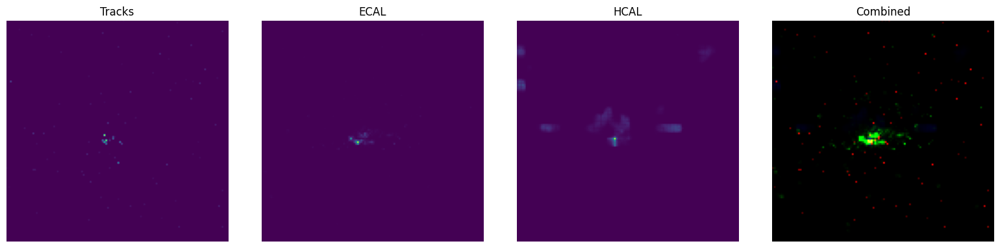

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


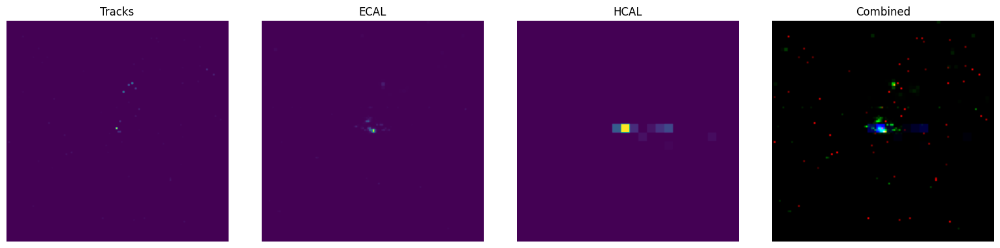

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


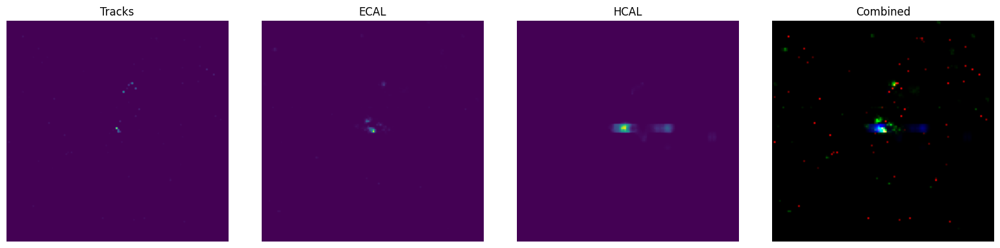

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


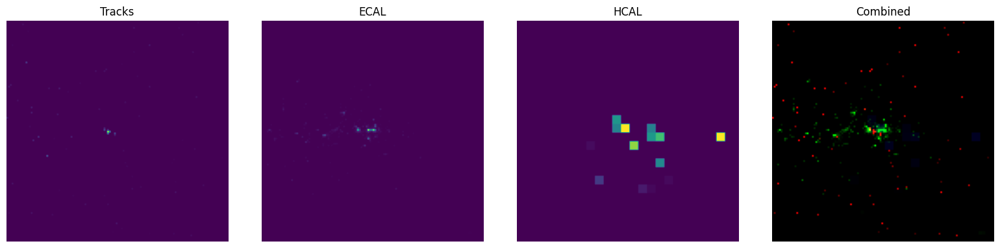

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


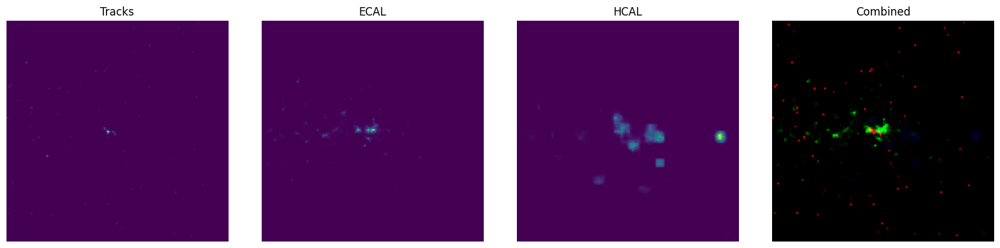

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


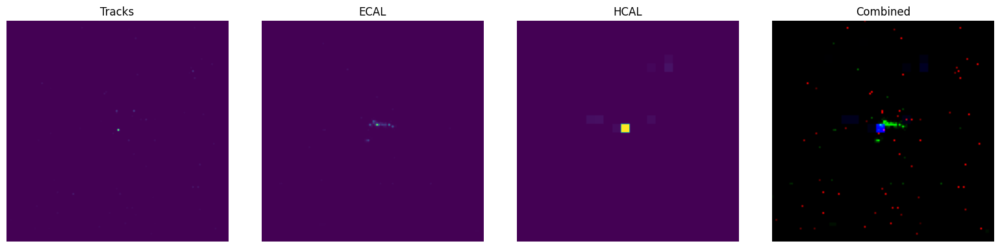

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


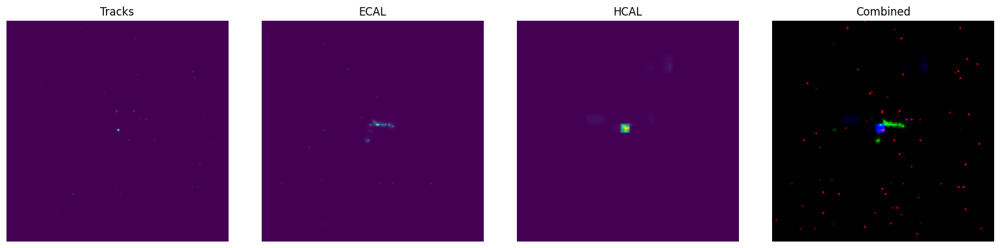

epoch: 216


100%|█████████████████████████████████████████| 625/625 [06:53<00:00,  1.51it/s]


train_loss: 0.00012374549258965998
epoch: 217


100%|█████████████████████████████████████████| 625/625 [06:54<00:00,  1.51it/s]


train_loss: 0.00012374186167726293
epoch: 218


100%|█████████████████████████████████████████| 625/625 [06:58<00:00,  1.49it/s]


train_loss: 0.00012372173074400052
epoch: 219


100%|█████████████████████████████████████████| 625/625 [06:55<00:00,  1.50it/s]


train_loss: 0.0001237133103539236
epoch: 220


100%|█████████████████████████████████████████| 625/625 [06:55<00:00,  1.50it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.0001237025162903592
Sample #0


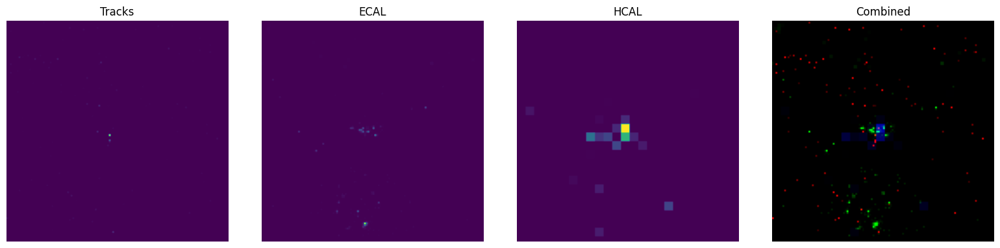

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


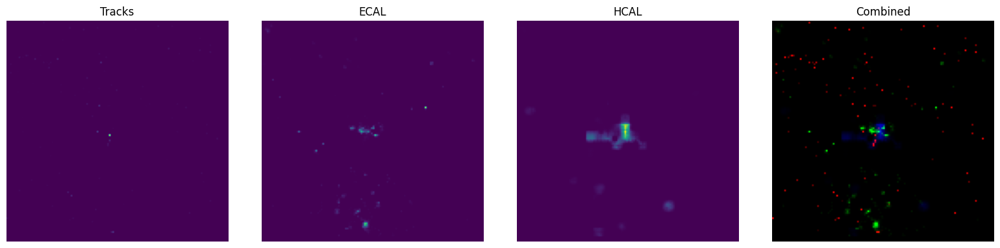

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


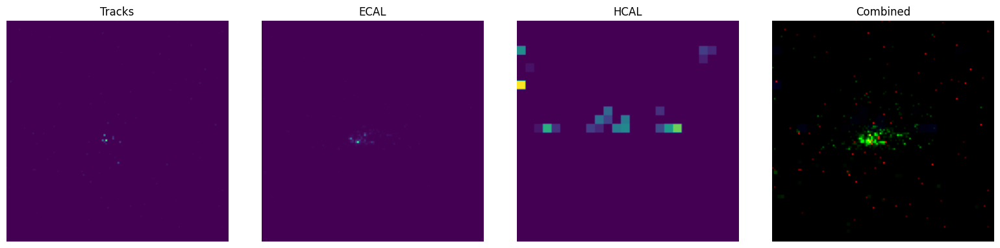

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


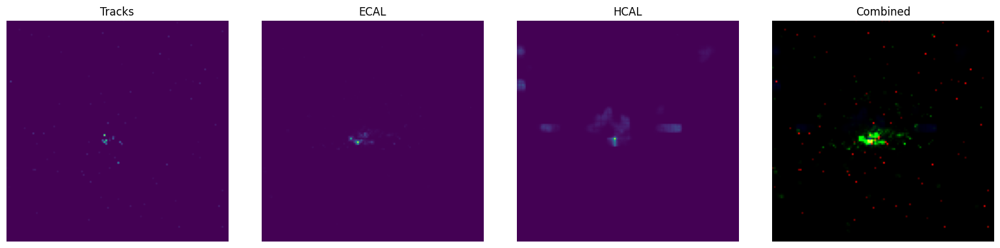

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


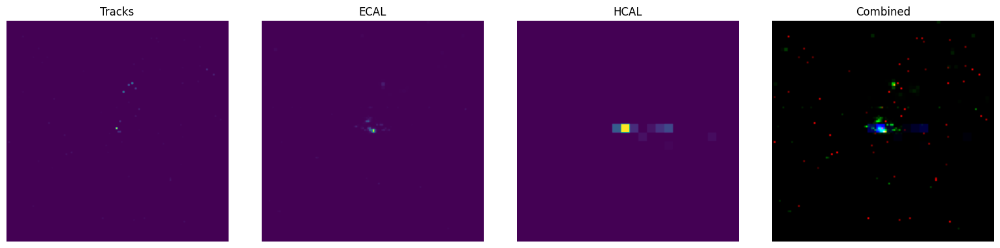

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


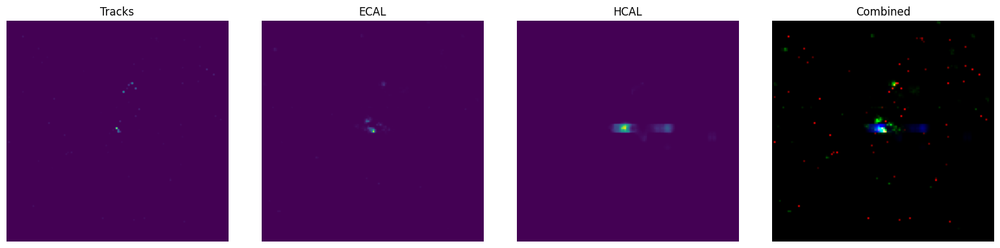

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


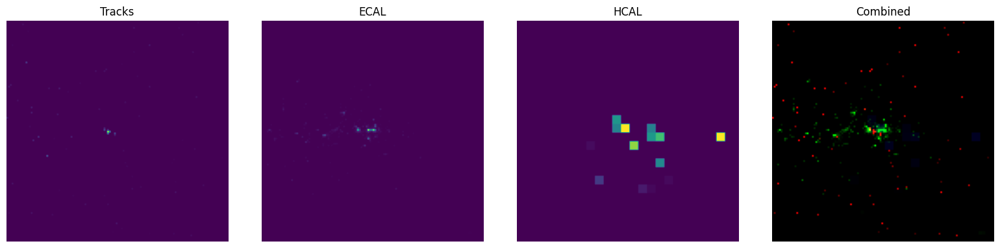

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


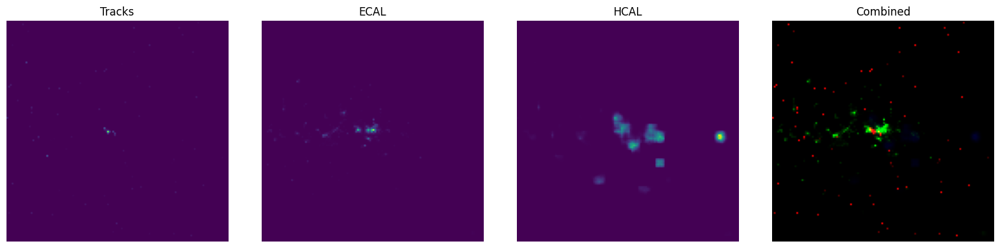

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


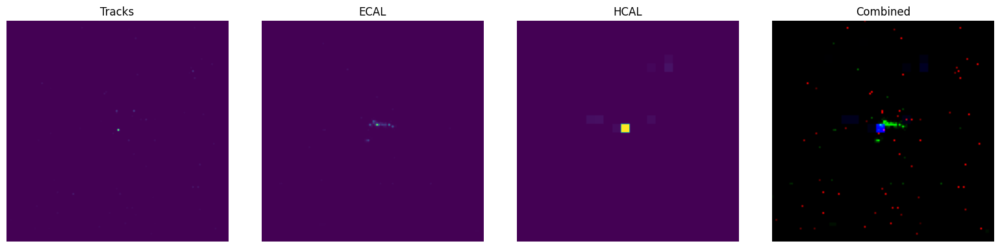

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


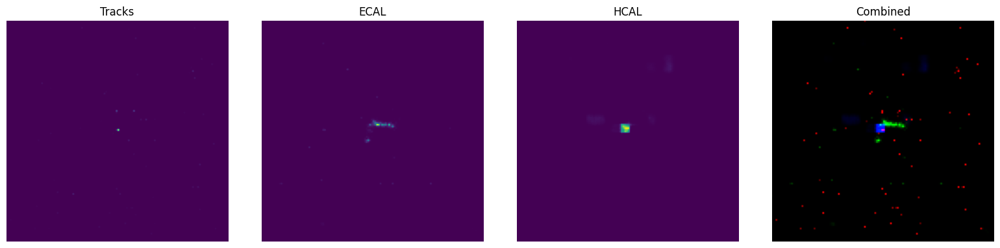

epoch: 221


100%|█████████████████████████████████████████| 625/625 [06:56<00:00,  1.50it/s]


train_loss: 0.0001236905655474402
epoch: 222


100%|█████████████████████████████████████████| 625/625 [06:57<00:00,  1.50it/s]


train_loss: 0.00012368293643230573
epoch: 223


100%|█████████████████████████████████████████| 625/625 [06:55<00:00,  1.50it/s]


train_loss: 0.00012367249153321608
epoch: 224


100%|█████████████████████████████████████████| 625/625 [06:56<00:00,  1.50it/s]


train_loss: 0.00012366189416497945
epoch: 225


100%|█████████████████████████████████████████| 625/625 [06:56<00:00,  1.50it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.0001236543944454752
Sample #0


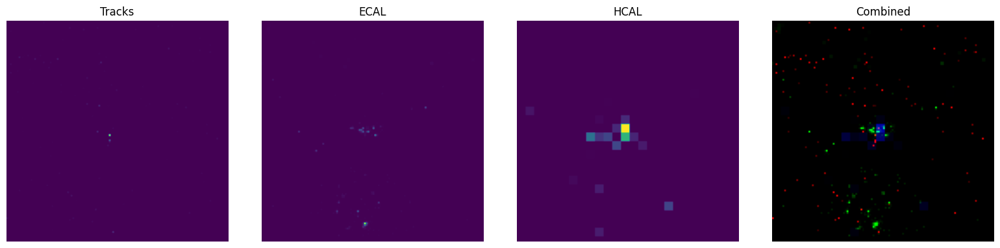

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


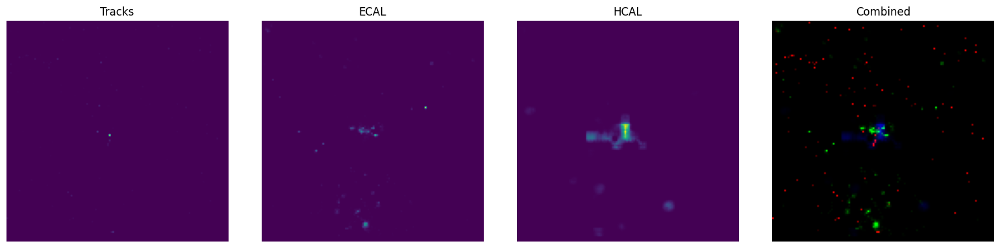

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


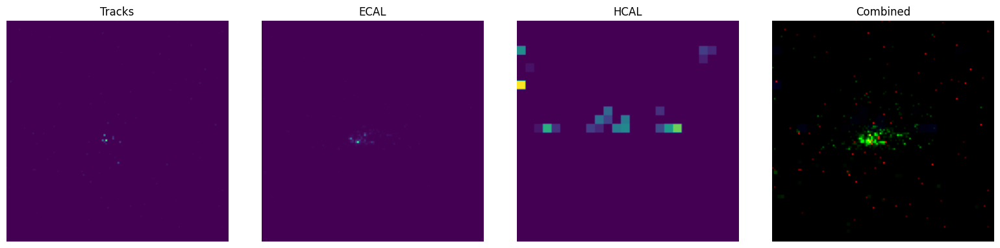

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


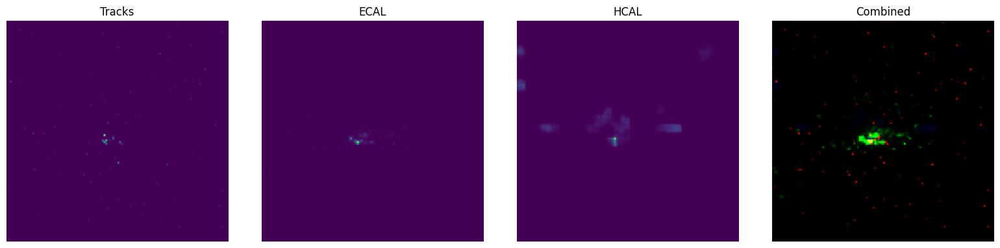

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


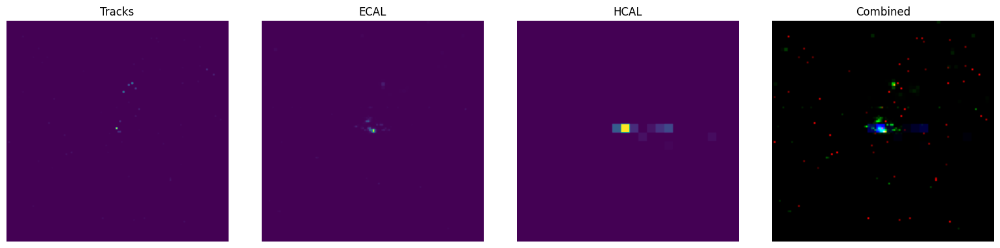

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


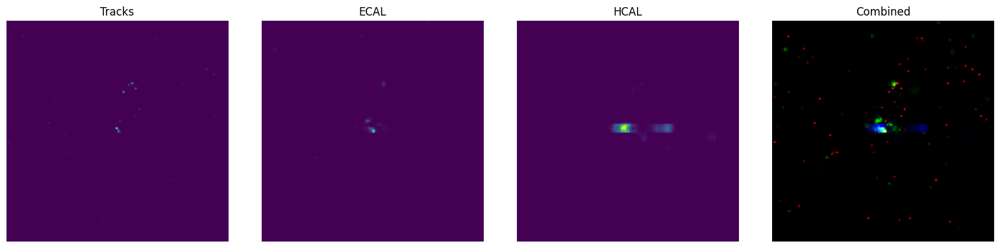

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


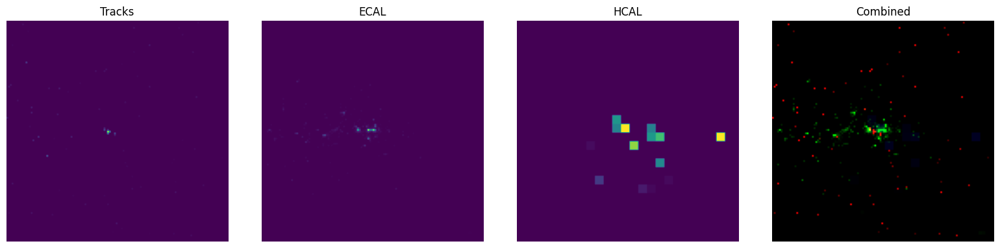

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


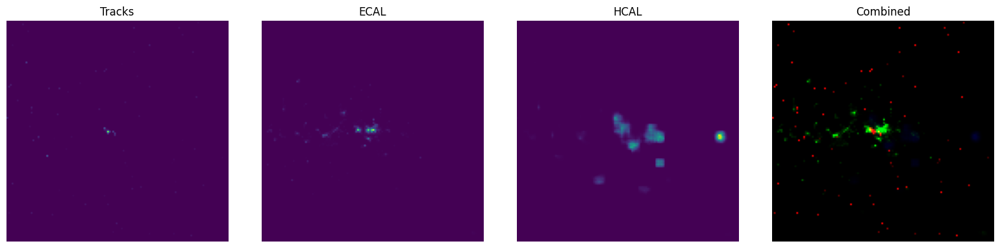

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #4


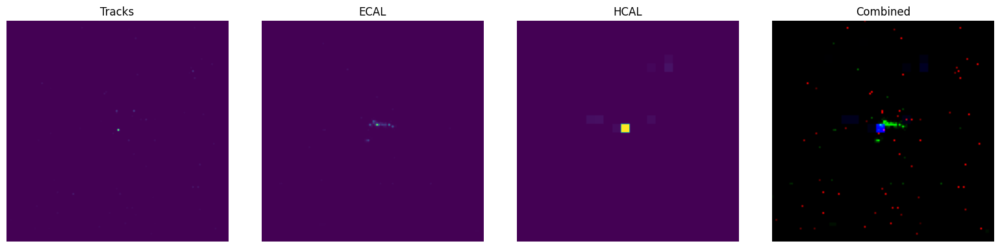

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


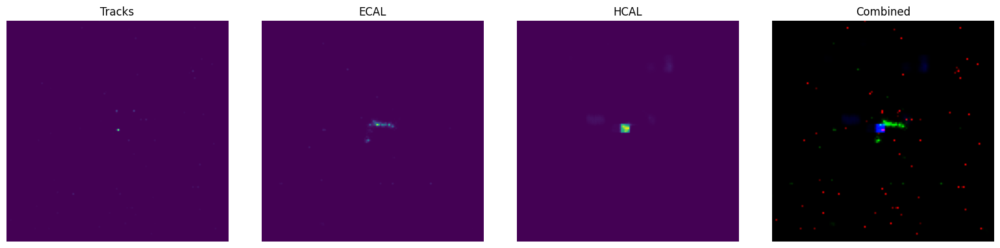

epoch: 226


100%|█████████████████████████████████████████| 625/625 [06:54<00:00,  1.51it/s]


train_loss: 0.00012364052162738517
epoch: 227


100%|█████████████████████████████████████████| 625/625 [06:54<00:00,  1.51it/s]


train_loss: 0.0001236399327404797
epoch: 228


100%|█████████████████████████████████████████| 625/625 [06:55<00:00,  1.50it/s]


train_loss: 0.0001236235103220679
epoch: 229


100%|█████████████████████████████████████████| 625/625 [06:54<00:00,  1.51it/s]


train_loss: 0.00012361624261830002
epoch: 230


100%|█████████████████████████████████████████| 625/625 [07:37<00:00,  1.37it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train_loss: 0.00012360878930194305
Sample #0


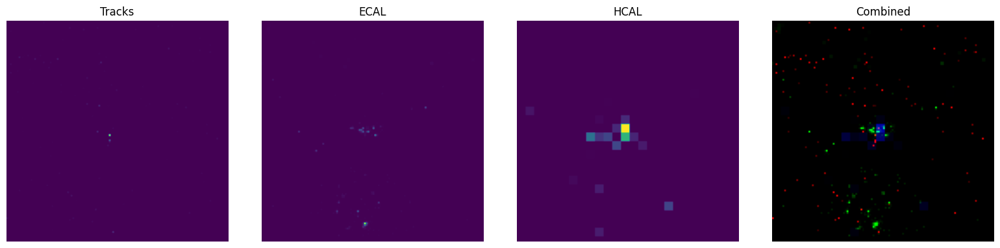

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


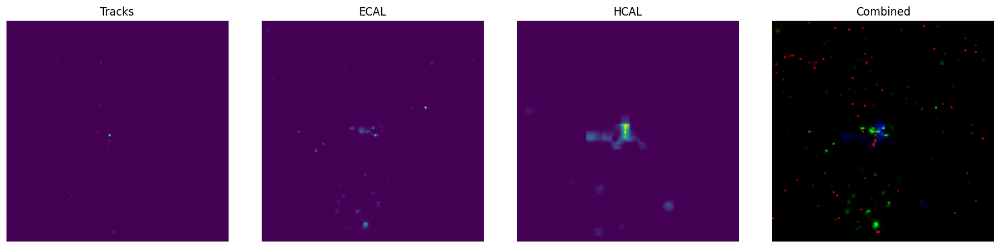

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #1


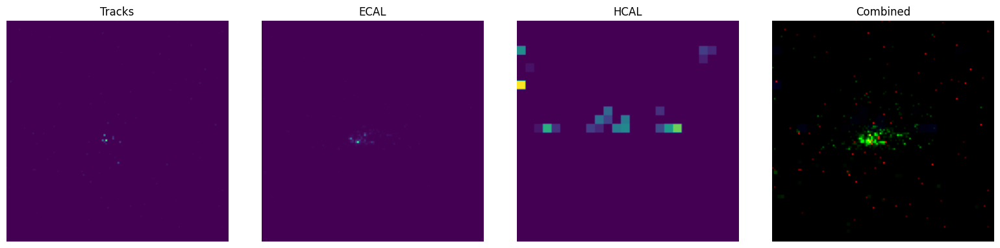

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


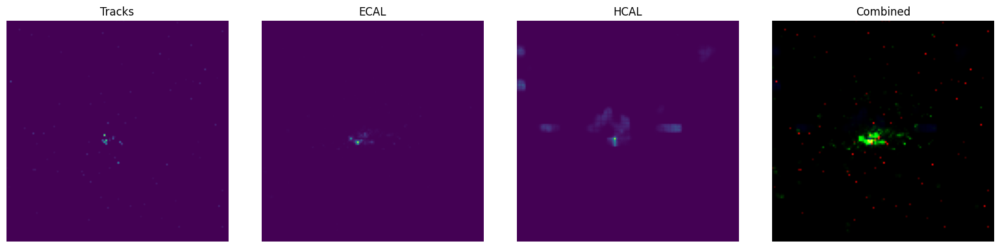

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #2


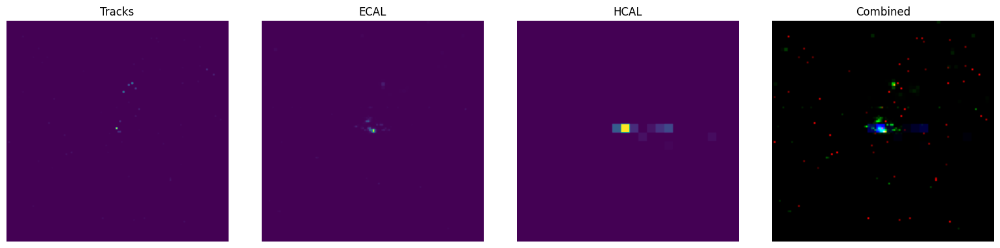

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


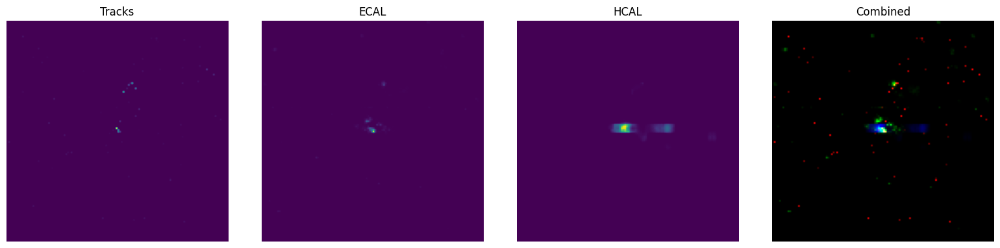

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Sample #3


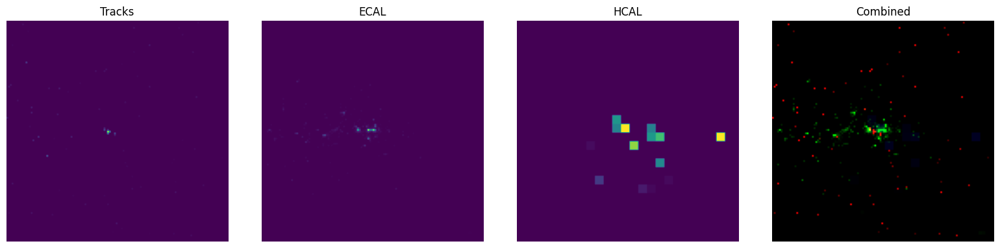

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


In [ ]:
with h5py.File(os.path.expanduser("~/data/quark-gluon_data-set_n139306.hdf5"), "r") as f:
    X = np.array(f["X_jets"])
    y = np.array(f["y"])

train_dataset = CustomDataset(X[:40000], y[:40000])
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)

val_dataset = CustomDataset(X[40000:], y[40000:])
val_loader = DataLoader(val_dataset, batch_size=64, shuffle=False)

model = Autoencoder()

criterion = nn.BCELoss()  # nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.0003)

random_indices = np.random.choice(len(val_dataset), size=20, replace=False)
random_images = torch.stack([val_dataset[i][0] for i in random_indices])

best_loss = 1
best_epoch = -1
num_epochs = 300
for epoch in range(num_epochs):
    print(f"epoch: {epoch+1}")
    running_loss = 0.0
    for images, _ in tqdm(train_loader):
        optimizer.zero_grad()
        reconstructions = model(images)
        loss = criterion(reconstructions, images)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
    train_loss = running_loss / len(train_loader)
    print(f"train_loss: {train_loss}")

    """
    val_loss = 0.0
    for images, _ in val_loader:
        optimizer.zero_grad()
        reconstructions = model(images)
        loss = criterion(reconstructions, images) 
        val_loss += loss.item()
    print(f"val_loss: {running_loss / len(val_loader)}")
    """
    if not (epoch + 1) % 5:        
        with torch.no_grad():
            reconstructed_images = model(random_images)
            print('=' * 20)
            for i in range(5):
                print('Sample #%d' % i)
                show_image(random_images[i], i, -1)
                show_image(reconstructed_images[i], i, epoch)

    if train_loss < best_loss:
        best_loss = train_loss
        best_epoch = epoch
        torch.save(
            {"model_state_dict": model.state_dict()},
            "best_model.pth",
        )

    elif epoch - best_epoch > 10:
        print("Early stopped training at epoch %d" % epoch)
        break